# Translational mapping

In this notebook we explicitely model the link between the regulatory and structural embeddings of the U2OS cells and evaluate their generalizability.

---


## 0. Enviromental setup

We first load the required packages and define a number of helper functions.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch
from torch import nn
from torch.optim import Adam
import sys
from tqdm.notebook import tqdm
from yellowbrick.cluster.elbow import kelbow_visualizer
from yellowbrick.cluster import KElbowVisualizer
from torch.utils.data import DataLoader
from sklearn.preprocessing import MinMaxScaler

sys.path.append("../../..")

from src.utils.notebooks.translation.analysis import *
from src.data.datasets import IndexedTensorDataset
from src.utils.basic.io import get_genesets_from_gmt_file


seed = 1234

device = "cuda:0"

%reload_ext nb_black

<IPython.core.display.Javascript object>

---

## 1. Read in data

Next, we read in the different data sets that we will use for the modelling and evaluation of the translational mappings. The first data set includes the regulatory embeddings of the 244 genes that are part of the inferred interactome.

In [51]:
node_embs = pd.read_csv(
    "../../../data/ppi/embedding/node_embeddings_cv_1024_2gexrecon_1graphrecon_mask_loss.csv",
    index_col=0,
)
# node_embs = pd.DataFrame(
#     StandardScaler().fit_transform(node_embs),
#     index=node_embs.index,
#     columns=node_embs.columns,
# )
node_embs.describe()
# node_embs.head()

,0,1,2,3,4,5,6,7,8,9,...,1014,1015,1016,1017,1018,1019,1020,1021,1022,1023
count,244.000000,244.000000,244.000000,244.000000,244.000000,244.000000,244.000000,244.000000,244.000000,244.000000,...,244.000000,244.000000,244.000000,244.000000,244.000000,244.000000,244.000000,244.000000,244.000000,244.000000
mean,0.005496,-0.001057,0.002531,-0.000844,0.003372,0.003623,0.004200,-0.000826,-0.004876,0.004632,...,0.000899,0.001729,-0.005909,-0.003185,-0.000482,0.001723,-0.000845,-0.000831,0.002404,0.003810
std,0.062666,0.034114,0.067143,0.042585,0.046254,0.062231,0.047733,0.045244,0.058655,0.049181,...,0.031488,0.033015,0.065365,0.044252,0.025828,0.060917,0.035060,0.039696,0.045978,0.032676
min,-0.203515,-0.125222,-0.169239,-0.073036,-0.097679,-0.125004,-0.134027,-0.139289,-0.112165,-0.117815,...,-0.091376,-0.104640,-0.169680,-0.105397,-0.078626,-0.188220,-0.100154,-0.099527,-0.093830,-0.071515
25%,-0.042476,-0.023398,-0.041067,-0.032808,-0.032883,-0.034621,-0.027104,-0.027796,-0.040412,-0.026584,...,-0.022346,-0.017756,-0.050465,-0.037815,-0.015504,-0.032847,-0.022504,-0.025526,-0.031209,-0.019318
50%,0.002320,-0.000022,-0.004324,-0.012236,0.005480,-0.003466,0.006726,0.000703,-0.019705,0.007670,...,-0.000686,0.005580,-0.012870,-0.007061,0.002111,0.007989,-0.000839,-0.001178,-0.002968,0.001673
75%,0.056376,0.020827,0.038619,0.022649,0.035321,0.032502,0.038758,0.029726,0.010069,0.035378,...,0.025219,0.022630,0.039164,0.023211,0.016040,0.036938,0.021428,0.025783,0.028685,0.026017
max,0.149122,0.085118,0.207221,0.143186,0.141616,0.217552,0.127661,0.117736,0.197040,0.131682,...,0.073418,0.082754,0.190472,0.130060,0.090529,0.149370,0.085325,0.102027,0.160587,0.106854


<IPython.core.display.Javascript object>

After having loaded the regulatory embeddings, we will now load the structural embeddings defined by the embeddings of the images held-out during the different folds of the cross-validation. In particular we load a version, where in addition to the structural embeddings the corresponding gene labels are given indicating the respective experimental condition the encoded cell images come from as well as a cluster label. The latter was obtained by clustering the structural embeddings for each held-out fold individually using 4-means clustering on euclidean distances to capture the frequently observed multimodal distribution of the cell states in the different overexpression settings.

In [52]:
img_embs = pd.read_hdf(
    "../../../data/experiments/image_embeddings/specificity_target_emb_cv_strat/final_1024/all_test_latents_k4.h5"
)

<IPython.core.display.Javascript object>

Finally, we also load a number of pathway database information that we will use later for validation.

In [53]:
kegg_gs_dict = get_genesets_from_gmt_file(
    "../../../data/other/c2.cp.kegg.v7.5.1.symbols.gmt"
)
pid_gs_dict = get_genesets_from_gmt_file(
    "../../../data/other/c2.cp.pid.v7.5.1.symbols.gmt"
)
wiki_gs_dict = get_genesets_from_gmt_file(
    "../../../data/other/c2.cp.wikipathways.v7.5.1.symbols.gmt"
)
bc_gs_dict = get_genesets_from_gmt_file(
    "../../../data/other/c2.cp.biocarta.v7.5.1.symbols.gmt"
)
h_gs_dict = get_genesets_from_gmt_file("../../../data/other/h.all.v7.4.symbols.gmt")

<IPython.core.display.Javascript object>

We aim to establish the translational mapping on three different levels defining the level of pooling in the structural space. First, we describe the structural embedding for given overexpression condition the mean of the embeddings for all cells from the corresponding condition. Second, each overexpression condition is described in the structural space by the means of the four different clusters identified using 4-means. This aims to better capture the multimodal cell state distribution induced by the overexpression settings. Finally, we compare the previous two approaches to the setting where we do not pool cells but describe each overexpression by the overall distribution of all structural embeddings of cells from the corresponding condition. All three approaches have certain advantages and disadvantages. To this end, assume a condition that gives rise to highly variable cell state population that spans the large parts of structural space as e.g. seen for the BRAF overexpression condition. An inferred map would thus map from large parts of the structural space to the corresponding regulatory embedding of BRAF. Such a mapping would be unspecific, prone to noise and subject to high variance which is unlikely to capture the causal links between the two spaces. To obtain more specific embeddings which is less affected by the noise in the single-cell embeddings, we propose to pool those and represent the structural phenotype of cells in the different conditions by the mean of the structural embeddings of the corresponding cells or the means of the four identified clusters. Note that this however, will drastically reduce the sample size that is available to infer the translational map. The effects of those different characteristics will described in the corresponding sections.

In [54]:
img_node_embs_dict = {}
shared_targets = set(node_embs.index).intersection(np.unique(img_embs.labels))
for i in range(4):
    filtered_img_embs = img_embs.loc[img_embs.fold == "fold_{}".format(i)]
    filtered_img_embs = filtered_img_embs.loc[
        filtered_img_embs.labels.isin(shared_targets)
    ]
    filtered_node_embs = node_embs.loc[filtered_img_embs.labels]
    labels = np.array(filtered_img_embs.labels)
    filtered_img_embs = filtered_img_embs._get_numeric_data()
    img_node_embs_dict["fold{}".format(i)] = (
        filtered_img_embs,
        filtered_node_embs,
        labels,
    )

<IPython.core.display.Javascript object>

In [55]:
cl_img_node_embs_dict = {}
shared_targets = set(node_embs.index).intersection(np.unique(img_embs.labels))
for i in range(4):
    filtered_img_embs = img_embs.loc[img_embs.fold == "fold_{}".format(i)]
    mean_img_embs = filtered_img_embs.groupby("cluster").median()
    labels = []
    for idx in list(mean_img_embs.index):
        labels.append(idx.split("_")[0])
    mean_img_embs["labels"] = np.array(labels)
    filtered_img_embs = mean_img_embs.loc[mean_img_embs.labels.isin(shared_targets)]
    filtered_node_embs = node_embs.loc[filtered_img_embs.labels]
    labels = filtered_img_embs.iloc[:, -1]
    filtered_img_embs = filtered_img_embs.iloc[:, :-1]
    cl_img_node_embs_dict["fold{}".format(i)] = (
        filtered_img_embs,
        filtered_node_embs,
        np.array(labels),
    )

<IPython.core.display.Javascript object>

In [56]:
mean_img_node_embs_dict = {}
shared_targets = set(node_embs.index).intersection(np.unique(img_embs.labels))
for i in range(4):
    filtered_img_embs = img_embs.loc[img_embs.fold == "fold_{}".format(i)]
    mean_img_embs = filtered_img_embs.groupby("labels").mean()
    mean_img_embs["labels"] = np.array(mean_img_embs.index)
    filtered_img_embs = mean_img_embs.loc[mean_img_embs.labels.isin(shared_targets)]
    filtered_node_embs = node_embs.loc[filtered_img_embs.labels]
    filtered_img_embs = filtered_img_embs.iloc[:, :-1]
    mean_img_node_embs_dict["fold{}".format(i)] = filtered_img_embs, filtered_node_embs

<IPython.core.display.Javascript object>

---

## 2. A look at the structural space

Before we however assess how well a translational mapping from the structural to the regulatory space works in practice. We first have a closer look at the inferred structural space. For the remainder of the analysis we will focus on the structural embeddings of the heldout fold 0 which is chosen at random.

### 2.1. Structural neihborhoods

As a first, step we are interested in how much information are encoded in the strctural embeddings at each level of pooling. To this end, we will assess for each gene target the 5 nearest neighbor including the target itself in the structural space. Note, that the nearest neighbors for the cluster pooling are defined as the k-nearest neighbors for each centroid such that the union of those neighbors is at least 5. We will then select the first 5 neighbors as the final estimate. To obtain a 5 nearest neighbor set for the single-cell embeddings, we will take the 5 targets that are most often the nearest neighbor for each of the corresponding cell embeddings.

---

#### 2.1.a. Mean embeddings

First, we look at the mean embeddings and only look at those targets, for which we have a corresponding regulatory embedding available later on.

In [8]:
mean_img_embs = mean_img_node_embs_dict["fold0"][0].loc[shared_targets]

<IPython.core.display.Javascript object>

In [9]:
mean_5nn_dict = get_mean_knn_dict(mean_img_embs, k=5)
mean_5nn_dict

{'AKT1S1': ['SMO', 'PKIA', 'DIABLO', 'SMAD3', 'FOXO1'],
 'APC': ['PRKCE', 'MAP3K5', 'KRAS', 'TRAF2', 'MAPK7'],
 'ATF4': ['IRAK4', 'PIK3R2', 'BAX', 'SMAD4', 'TSC2'],
 'BAX': ['TSC2', 'IRAK4', 'CREB1', 'PIK3R2', 'ATF4'],
 'BCL2L11': ['CASP8', 'ELK1', 'BRAF', 'DIABLO', 'TRAF2'],
 'BRAF': ['RAF1', 'PRKCE', 'MYD88', 'KRAS', 'MAP3K2'],
 'CASP8': ['BCL2L11', 'ELK1', 'BRAF', 'RAF1', 'KRAS'],
 'CDC42': ['ELK1', 'BRAF', 'GLI1', 'TRAF2', 'PRKCE'],
 'CDKN1A': ['MAPK7', 'HRAS', 'ATF4', 'MAP3K5', 'IRAK4'],
 'CEBPA': ['JUN', 'ERG', 'PRKACA', 'FGFR3', 'SRC'],
 'CREB1': ['TSC2', 'BAX', 'SMAD4', 'IRAK4', 'ATF4'],
 'DIABLO': ['SMO', 'MYD88', 'BRAF', 'AKT1S1', 'PKIA'],
 'E2F1': ['ERG', 'SRC', 'FGFR3', 'BAX', 'PRKCE'],
 'ELK1': ['TRAF2', 'PRKCE', 'FGFR3', 'CDC42', 'SRC'],
 'ERG': ['CEBPA', 'E2F1', 'PRKACA', 'JUN', 'ELK1'],
 'FGFR3': ['SRC', 'PRKCE', 'PIK3R2', 'KRAS', 'TRAF2'],
 'FOXO1': ['SMAD3', 'SREBF1', 'RHOA', 'SMO', 'PKIA'],
 'GLI1': ['PRKACA', 'RHOA', 'BRAF', 'MYD88', 'CDC42'],
 'HRAS': ['MAP3K5', 'K

<IPython.core.display.Javascript object>

---

#### 2.1.b. 4-centroid embeddings

The 4-centroid embeddings are next. The nearest neighbors will be computed as discussed before.


In [10]:
cl_img_embs, _, cl_labels = cl_img_node_embs_dict["fold0"]
cl_img_embs = cl_img_embs.loc[np.isin(cl_labels, list(shared_targets))]
cl_labels = cl_labels[np.isin(cl_labels, list(shared_targets))]

<IPython.core.display.Javascript object>

In [11]:
centroid_5nn_dict = get_centroid_knn_dict(cl_img_embs, cl_labels, k=5)

<IPython.core.display.Javascript object>

In [12]:
centroid_5nn_dict

{'AKT1S1': ['APC', 'SREBF1', 'FOXO1', 'SMAD3', 'SMO'],
 'APC': ['IRAK4', 'PIK3R2', 'DIABLO', 'KRAS', 'BRAF'],
 'ATF4': ['SMAD4', 'DIABLO', 'TRAF2', 'BAX', 'APC'],
 'BAX': ['ATF4', 'SRC', 'TSC2', 'E2F1', 'IRAK4'],
 'BCL2L11': ['SRC', 'IRAK4', 'RAF1', 'MYD88', 'BRAF'],
 'BRAF': ['CDC42', 'KRAS', 'RAF1', 'SMO', 'MAPK7'],
 'CASP8': ['BCL2L11', 'PRKACA', 'HRAS', 'IRAK4', 'RHOA'],
 'CDC42': ['PRKCE', 'BRAF', 'MAP3K9', 'PRKACA', 'RHOA'],
 'CDKN1A': ['MAPK7', 'HRAS', 'SMAD4', 'MAP3K5', 'CDC42'],
 'CEBPA': ['JUN', 'RHOA', 'PRKACA', 'SRC', 'ERG'],
 'CREB1': ['SMAD4', 'KRAS', 'IRAK4', 'TSC2', 'FGFR3'],
 'DIABLO': ['APC', 'MYD88', 'SMO', 'KRAS', 'RAF1'],
 'E2F1': ['BAX', 'IRAK4', 'FGFR3', 'ERG', 'PRKCE'],
 'ELK1': ['PRKCE', 'CDC42', 'MAP3K5', 'IRAK4', 'RAF1'],
 'ERG': ['GLI1', 'CEBPA', 'JUN', 'BAX', 'CDC42'],
 'FGFR3': ['RAF1', 'KRAS', 'PIK3R2', 'ERG', 'SRC'],
 'FOXO1': ['PKIA', 'PIK3R2', 'RHOA', 'WWTR1', 'SREBF1'],
 'GLI1': ['BRAF', 'RHOA', 'PRKACA', 'MYD88', 'PRKCE'],
 'HRAS': ['TRAF2', 'MAP3K5'

<IPython.core.display.Javascript object>

---

#### 2.1.c. Single-cell embeddings

To assess the 5 nearest neighbors on the unpooled data we follow the previously described approach.

In [13]:
single_img_embs, _, labels = img_node_embs_dict["fold0"]
single_img_embs = single_img_embs.loc[np.isin(labels, list(shared_targets))]
labels = labels[np.isin(labels, list(shared_targets))]

<IPython.core.display.Javascript object>

In [14]:
single_5nn_dict = get_single_knn_dict(single_img_embs, labels, k=5)

  0%|          | 0/43 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

In [15]:
single_5nn_dict

{'AKT1S1': ['SMAD3', 'FOXO1', 'SMO', 'PRKCE', 'KRAS'],
 'APC': ['BRAF', 'PRKCE', 'SMO', 'ATF4', 'AKT1S1'],
 'ATF4': ['BAX', 'IRAK4', 'SMAD4', 'PRKCE', 'KRAS'],
 'BAX': ['TSC2', 'ATF4', 'KRAS', 'E2F1', 'PRKCE'],
 'BCL2L11': ['RAF1', 'CASP8', 'SMO', 'PRKCE', 'KRAS'],
 'BRAF': ['RAF1', 'PRKCE', 'KRAS', 'SMAD3', 'RHOA'],
 'CASP8': ['MYD88', 'RAF1', 'MAP3K2', 'BCL2L11', 'SMO'],
 'CDC42': ['PRKCE', 'KRAS', 'BRAF', 'RHOA', 'MAP3K2'],
 'CDKN1A': ['KRAS', 'MAPK7', 'MAP3K9', 'ATF4', 'TSC2'],
 'CEBPA': ['JUN', 'ERG', 'PRKCE', 'RHOA', 'FGFR3'],
 'CREB1': ['ATF4', 'SMAD4', 'IRAK4', 'BAX', 'TSC2'],
 'DIABLO': ['AKT1S1', 'SMO', 'BRAF', 'RAF1', 'PRKCE'],
 'E2F1': ['ERG', 'CDC42', 'PRKCE', 'BRAF', 'BAX'],
 'ELK1': ['PRKCE', 'RAF1', 'CDC42', 'KRAS', 'BRAF'],
 'ERG': ['CEBPA', 'JUN', 'PRKCE', 'PRKACA', 'FGFR3'],
 'FGFR3': ['PRKCE', 'KRAS', 'PIK3R2', 'AKT1S1', 'E2F1'],
 'FOXO1': ['SMAD3', 'RHOA', 'SMO', 'MYD88', 'WWTR1'],
 'GLI1': ['RHOA', 'BRAF', 'CDC42', 'SMAD3', 'MYD88'],
 'HRAS': ['KRAS', 'BRAF', 'PRK

<IPython.core.display.Javascript object>

We see that AKT1S1, BRAF, KRAS, RAF1 are often among the five nearest neighbors of the individual samples. This is a) due to the prominent class imbalance were BRAF and RAF1 are the most frequent conditions and due to the large variance of those conditions.

---

### 2.2. Pathway prediction in structural neighborhood

As a next, step we will use the previously computed results and quanitatively assess how well we can affected pathways by simply looking at the structural space. This will serve as a baseline to show the added value from translating to the regulatory space.

To this end, we define the following proxy task: Given a number of functional gene sets, we look at the k nearest neighbors for each target embedding in the structural space as before and assess how many of those are part of the same gene set as before.

For now we will choose k=1 and use the KEGG and PID pathway gene sets for the quantification. The later might be more appropriate with respect to potential use case of therapeutic design.

In [16]:
inv_kegg_gs_dict = get_inv_gs_dict(sorted(list(node_embs.index)), kegg_gs_dict)
inv_pid_gs_dict = get_inv_gs_dict(sorted(list(node_embs.index)), pid_gs_dict)
inv_wiki_gs_dict = get_inv_gs_dict(sorted(list(node_embs.index)), wiki_gs_dict)
inv_bc_gs_dict = get_inv_gs_dict(sorted(list(node_embs.index)), bc_gs_dict)
inv_h_gs_dict = get_inv_gs_dict(sorted(list(node_embs.index)), h_gs_dict)

<IPython.core.display.Javascript object>

In [17]:
iou_kegg_1nn_mean_embs = get_geneset_io(mean_5nn_dict, inv_kegg_gs_dict, k=1)
iou_pid_1nn_mean_embs = get_geneset_io(mean_5nn_dict, inv_pid_gs_dict, k=1)
iou_wiki_1nn_mean_embs = get_geneset_io(mean_5nn_dict, inv_wiki_gs_dict, k=1)
iou_bc_1nn_mean_embs = get_geneset_io(mean_5nn_dict, inv_bc_gs_dict, k=1)
iou_h_1nn_mean_embs = get_geneset_io(mean_5nn_dict, inv_h_gs_dict, k=1)

iou_kegg_1nn_cl_embs = get_geneset_io(centroid_5nn_dict, inv_kegg_gs_dict, k=1)
iou_pid_1nn_cl_embs = get_geneset_io(centroid_5nn_dict, inv_pid_gs_dict, k=1)
iou_wiki_1nn_cl_embs = get_geneset_io(centroid_5nn_dict, inv_wiki_gs_dict, k=1)
iou_bc_1nn_cl_embs = get_geneset_io(centroid_5nn_dict, inv_bc_gs_dict, k=1)
iou_h_1nn_cl_embs = get_geneset_io(centroid_5nn_dict, inv_h_gs_dict, k=1)

iou_kegg_1nn_single_embs = get_geneset_io(single_5nn_dict, inv_kegg_gs_dict, k=1)
iou_pid_1nn_single_embs = get_geneset_io(single_5nn_dict, inv_pid_gs_dict, k=1)
iou_wiki_1nn_single_embs = get_geneset_io(single_5nn_dict, inv_wiki_gs_dict, k=1)
iou_bc_1nn_single_embs = get_geneset_io(single_5nn_dict, inv_bc_gs_dict, k=1)
iou_h_1nn_single_embs = get_geneset_io(single_5nn_dict, inv_h_gs_dict, k=1)

<IPython.core.display.Javascript object>

In [18]:
iou_wiki_1nn_mean_embs

{'AKT1S1': 0.0,
 'APC': 0.02631578947368421,
 'ATF4': 0.034482758620689655,
 'BAX': 0.03125,
 'BCL2L11': 0.10869565217391304,
 'BRAF': 0.3333333333333333,
 'CASP8': 0.10869565217391304,
 'CDC42': 0.18333333333333332,
 'CDKN1A': 0.014925373134328358,
 'CEBPA': 0.010526315789473684,
 'CREB1': 0.10810810810810811,
 'DIABLO': 0.0,
 'E2F1': 0.0,
 'ELK1': 0.0784313725490196,
 'ERG': 0.0,
 'FGFR3': 0.04285714285714286,
 'FOXO1': 0.06153846153846154,
 'GLI1': 0.02702702702702703,
 'HRAS': 0.125,
 'IRAK4': 0.034482758620689655,
 'JUN': 0.010526315789473684,
 'KRAS': 0.08928571428571429,
 'MAP2K3': 0.21951219512195122,
 'MAP3K2': 0.07142857142857142,
 'MAP3K5': 0.13793103448275862,
 'MAP3K9': 0.25,
 'MAPK7': 0.13793103448275862,
 'MYD88': 0.0,
 'PIK3R2': 0.23958333333333334,
 'PKIA': 0.0,
 'PRKACA': 0.02702702702702703,
 'PRKCE': 0.04918032786885246,
 'RAF1': 0.3333333333333333,
 'RELB': 0.0625,
 'RHOA': 0.0,
 'SMAD3': 0.06153846153846154,
 'SMAD4': 0.034482758620689655,
 'SMO': 0.0,
 'SRC': 0.0

<IPython.core.display.Javascript object>

---

## 3. Translational analyses


We will now built translational maps in order to show that we can add additional value by translating to the regulatory space. To this end, we will compare the performance of different model and prediction approaches. As a baseline we will consider the inference purely based on the structural space that we discussed before. We will compare that to the performance of a simple linear and non-linear model (3-layer ANN). As before we will train those models using the previously computed embeddings at the different level of pooling: mean-pooling, centroid-pooling and unpooled. 

In addition to assessing the IoU of the gene set prediction in the leave-one-target-out framework, we will also assess the top-k accuracy for each target individually for all translation models. Note that we can not baseline that by solely looking at the structural space which is due to the fact that this does not allow for exact out-of-sample predictions.

In [57]:
# nn = NearestNeighbors(n_neighbors=len(node_embs), p=2).fit(
#     StandardScaler().fit_transform(node_embs)
# )
img_embs_fold0, node_embs_fold0 = mean_img_node_embs_dict["fold0"]

nn = NearestNeighbors(n_neighbors=len(node_embs), p=2).fit(np.array(node_embs))


nn_clf = CustomKNNClassifier(
    clf=nn, samples=np.array(list(node_embs.index)), ks=[1, 3, 5, 10, 20, 50]
)

<IPython.core.display.Javascript object>

In [58]:
def transfer_comb_loto(img_embs, node_embs, model):
    #     img_embs = img_embs.loc[~img_embs.index.isin(["BRAF", "CDC42", "CDKN1A", "E2F1"])]
    #     node_embs = node_embs.loc[
    #         ~node_embs.index.isin(["BRAF", "CDKN1A", "E2F1", "CDC42"])
    #     ]
    sc = StandardScaler()
    #     img_embs = pd.DataFrame(
    #         sc.fit_transform(img_embs), columns=img_embs.columns, index=img_embs.index
    #     )
    #     node_embs = pd.DataFrame(
    #         sc.fit_transform(node_embs), columns=node_embs.columns, index=node_embs.index
    #     )
    targets = np.unique(img_embs.index)
    target_nn_dict = {}
    target_topk_dict = {}
    for target in targets:
        #         sc.fit(img_embs.loc[img_embs.index != target])
        #         img_embs = pd.DataFrame(
        #             sc.transform(img_embs), columns=img_embs.columns, index=img_embs.index
        #         )

        wo_target_img_embs = img_embs.loc[img_embs.index != target]
        target_img_embs = img_embs.loc[target]
        beta = np.matmul(np.array(target_img_embs), np.linalg.pinv(wo_target_img_embs))
        print(
            "Most influential samples for {}".format(target),
            list(wo_target_img_embs.iloc[beta.argsort()[-5:][::-1]].index),
        )
        pred = np.matmul(beta, node_embs.loc[wo_target_img_embs.index])
        pred = model.clf.kneighbors(
            np.array(pred).reshape(1, -1), return_distance=False
        ).flatten()
        target_nn_dict[target] = model.samples[pred]
        topk = []
        for k in model.ks:
            topk.append(np.sum(target_nn_dict[target][:k] == target))
        target_topk_dict[target] = topk
    return target_nn_dict, target_topk_dict

<IPython.core.display.Javascript object>

In [59]:
target_nn_transfer, target_topk_transfer = transfer_comb_loto(
    img_embs_fold0, node_embs, nn_clf
)

Most influential samples for AKT1S1 ['PKIA', 'SMO', 'SRC', 'ATF4', 'GLI1']
Most influential samples for APC ['BRAF', 'IRAK4', 'PRKCE', 'PKIA', 'MAP3K5']
Most influential samples for ATF4 ['IRAK4', 'RAF1', 'AKT1S1', 'BAX', 'ELK1']
Most influential samples for BAX ['TSC2', 'PRKCE', 'ATF4', 'KRAS', 'DIABLO']
Most influential samples for BCL2L11 ['MAP3K5', 'DIABLO', 'CASP8', 'RAF1', 'ELK1']
Most influential samples for BRAF ['RAF1', 'APC', 'SMAD3', 'SMO', 'SRC']
Most influential samples for CASP8 ['BCL2L11', 'SRC', 'BRAF', 'PKIA', 'PRKCE']
Most influential samples for CDC42 ['PRKCE', 'MYD88', 'GLI1', 'RHOA', 'MAP3K2']
Most influential samples for CDKN1A ['FOXO1', 'MAPK7', 'SMO', 'KRAS', 'PIK3R2']
Most influential samples for CEBPA ['JUN', 'SMAD3', 'FGFR3', 'ERG', 'SRC']
Most influential samples for CREB1 ['IRAK4', 'TSC2', 'SMAD4', 'FGFR3', 'KRAS']
Most influential samples for DIABLO ['SMO', 'BCL2L11', 'KRAS', 'WWTR1', 'MYD88']
Most influential samples for E2F1 ['IRAK4', 'GLI1', 'ERG', 'BAX

<IPython.core.display.Javascript object>

In [60]:
target_topk_transfer

{'AKT1S1': [0, 0, 0, 0, 0, 0],
 'APC': [0, 0, 0, 0, 0, 0],
 'ATF4': [0, 0, 0, 0, 0, 1],
 'BAX': [0, 0, 0, 0, 1, 1],
 'BCL2L11': [0, 0, 0, 0, 0, 0],
 'BRAF': [0, 1, 1, 1, 1, 1],
 'CASP8': [0, 0, 0, 0, 0, 1],
 'CDC42': [0, 0, 0, 0, 0, 0],
 'CDKN1A': [0, 0, 0, 0, 0, 0],
 'CEBPA': [0, 0, 0, 0, 1, 1],
 'CREB1': [0, 0, 1, 1, 1, 1],
 'DIABLO': [0, 0, 0, 0, 1, 1],
 'E2F1': [0, 0, 0, 0, 0, 0],
 'ELK1': [0, 0, 0, 0, 0, 0],
 'ERG': [0, 0, 0, 0, 0, 0],
 'FGFR3': [0, 0, 0, 0, 0, 0],
 'FOXO1': [0, 0, 0, 1, 1, 1],
 'GLI1': [0, 0, 0, 0, 0, 0],
 'HRAS': [0, 0, 0, 0, 0, 1],
 'IRAK4': [0, 0, 0, 0, 0, 0],
 'JUN': [0, 0, 0, 0, 0, 0],
 'KRAS': [0, 0, 0, 1, 1, 1],
 'MAP2K3': [0, 0, 0, 0, 0, 1],
 'MAP3K2': [0, 0, 0, 1, 1, 1],
 'MAP3K5': [0, 0, 0, 0, 0, 1],
 'MAP3K9': [0, 0, 0, 0, 0, 1],
 'MAPK7': [0, 0, 1, 1, 1, 1],
 'MYD88': [0, 0, 0, 0, 0, 0],
 'PIK3R2': [0, 0, 0, 0, 1, 1],
 'PKIA': [0, 0, 0, 0, 0, 0],
 'PRKACA': [0, 0, 0, 0, 0, 0],
 'PRKCE': [0, 0, 0, 1, 1, 1],
 'RAF1': [0, 0, 0, 0, 0, 0],
 'RELB': [0, 0, 

<IPython.core.display.Javascript object>

In [61]:
for k, v in target_nn_transfer.items():
    print(k, v[:10])

AKT1S1 ['GLI1' 'MFAP2' 'THY1' 'FBN2' 'HAPLN1' 'VCAN' 'ACAN' 'MYL9' 'TPM2' 'DHRS2']
APC ['CDK14' 'MAGEA1' 'PRKCE' 'BRAF' 'AKT1S1' 'HSPB1' 'PAK2' 'HRAS' 'KRAS'
 'EPB41L3']
ATF4 ['RAF1' 'MAPK8' 'BRAF' 'HRAS' 'MAP3K5' 'AQP1' 'KPNA2' 'TRAF2' 'PRKCE'
 'KRT18']
BAX ['MAP3K5' 'RELB' 'MAP3K2' 'CDK14' 'AKT1S1' 'HSPA1B' 'CEBPA' 'CLU' 'MAGEA1'
 'SREBF1']
BCL2L11 ['DIABLO' 'HSPA1B' 'APC' 'ATF4' 'RELB' 'CD40' 'KPNA2' 'MDC1' 'CLU' 'CDCA3']
BRAF ['MAP3K5' 'MAPK8' 'BRAF' 'SFN' 'RAF1' 'CEBPA' 'NCOR2' 'HRAS' 'MAP3K2'
 'TSC2']
CASP8 ['BCL2L11' 'MAGEA11' 'SRC' 'BAX' 'MAPK8' 'RARA' 'TLR4' 'MAP3K2' 'MYD88'
 'FOXO1']
CDC42 ['FOS' 'CASP8' 'MAP3K5' 'JUN' 'TRAF2' 'CLU' 'MAP2K3' 'ATF4' 'MAPK8' 'TLR4']
CDKN1A ['SMO' 'PTCH1' 'PKIA' 'GABRB3' 'AMPH' 'CCNF' 'MKI67' 'RRM2' 'TP73' 'KIF15']
CEBPA ['RUNX1' 'JUN' 'FOS' 'IRF7' 'SMAD3' 'FOXO1' 'TSC2' 'SMAD4' 'NCOR2' 'WWTR1']
CREB1 ['SMAD4' 'FHL2' 'IRF7' 'FOXO1' 'CREB1' 'MYD88' 'TENM3' 'IRAK4' 'GLI2'
 'RARA']
DIABLO ['PTCH1' 'SMO' 'DHRS2' 'TNNC1' 'APPBP2' 'RPS6KB1' 'GLI1' 'CE

<IPython.core.display.Javascript object>

---

### 3.1. Linear mean translation

As a first setup, we will train a linear model in a leave-one-target out setting for 1000 epochs. We will look at the predicted 5 nearest neighbors in the regulatory space for each of those targets.

In [62]:
img_embs_fold0, node_embs_fold0 = mean_img_node_embs_dict["fold0"]

<IPython.core.display.Javascript object>

In [63]:
nn = NearestNeighbors(n_neighbors=len(node_embs), p=2).fit(np.array(node_embs))
nn_clf = CustomKNNClassifier(
    clf=nn, samples=np.array(list(node_embs.index)), ks=[1, 3, 5, 10, 20, 50]
)

<IPython.core.display.Javascript object>

---

In [64]:
data_dicts = get_logo_data_dicts(
    data=img_embs_fold0,
    labels=node_embs_fold0,
    val_size=0,
    group_labels=np.array(list(node_embs_fold0.index)),
    batch_size=32,
    balanced=False,
    scale_x=False,
    scale_y=False,
)

<IPython.core.display.Javascript object>

  0%|          | 0/43 [00:00<?, ?it/s]

AKT1S1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.01609780430971157
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.04373318701982498
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


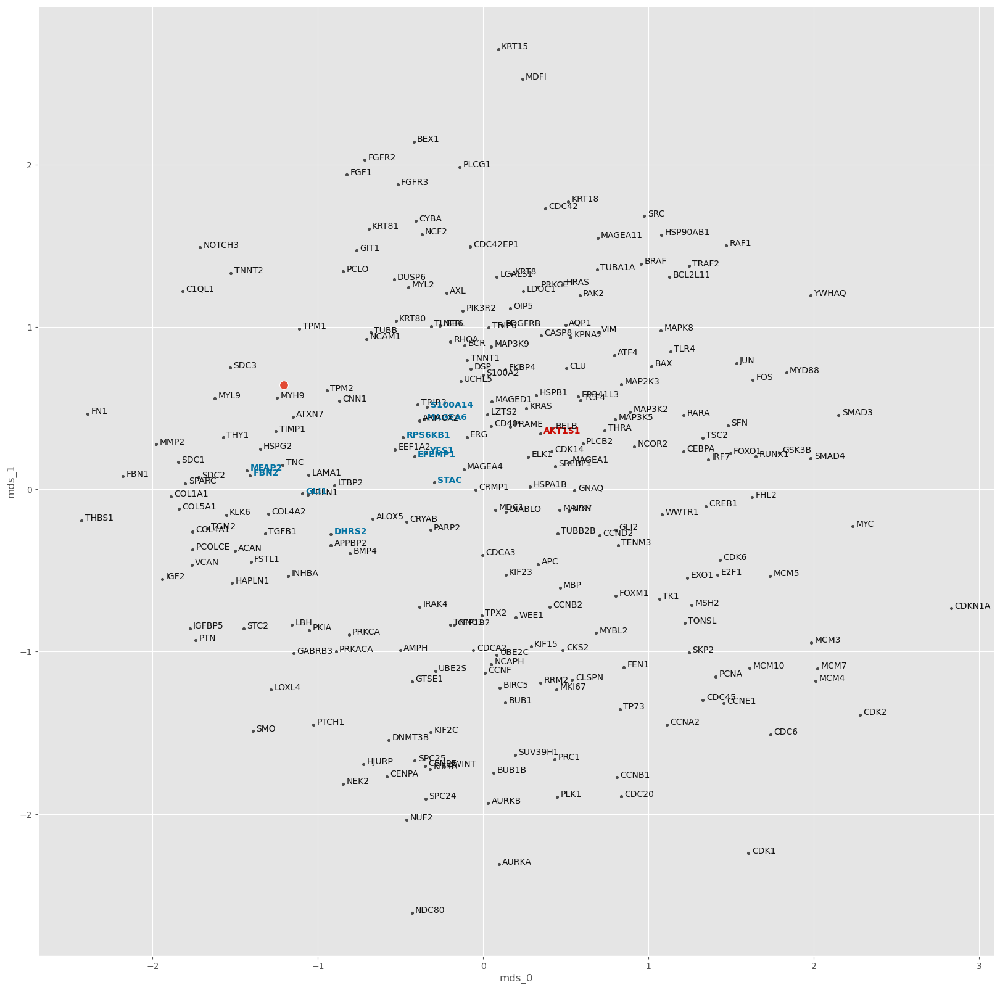

APC
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.015482007747604734
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.040568627417087555
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


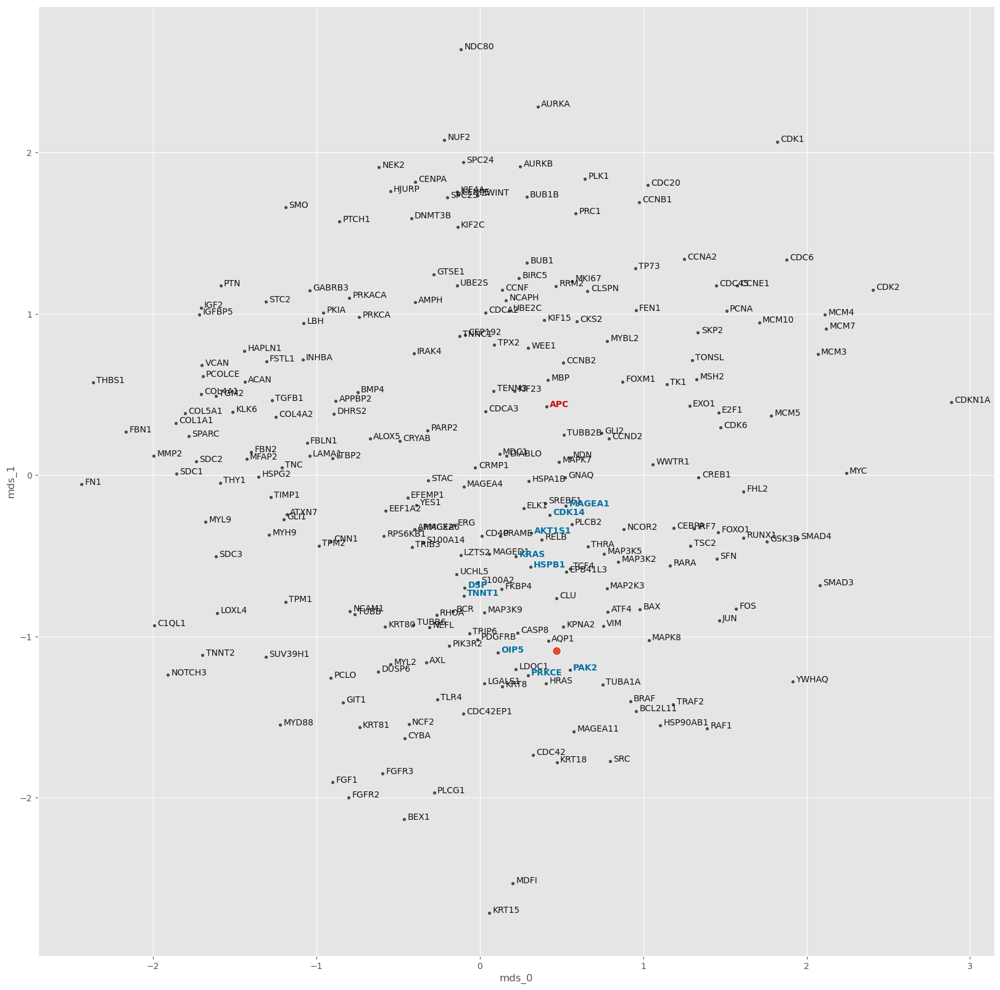

ATF4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.016516191884875298
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.035286709666252136
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


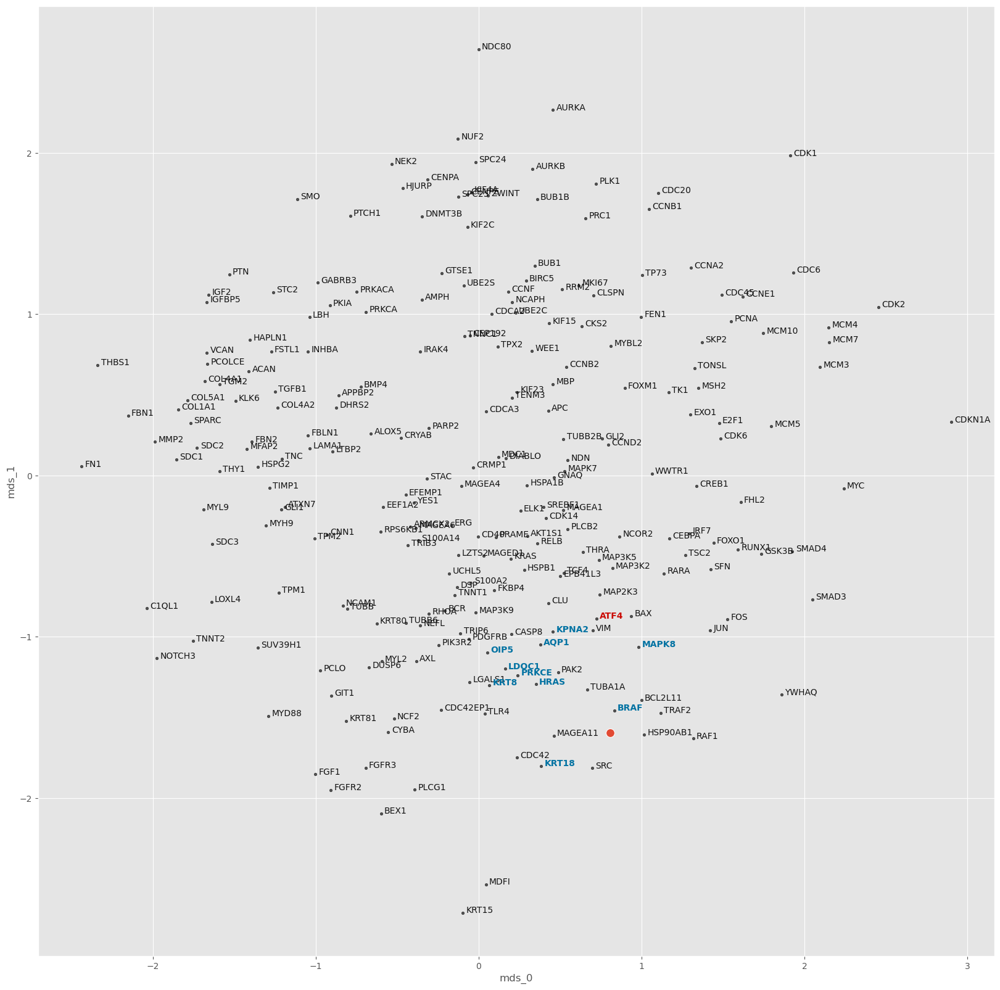

BAX
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.01603730231346119
train top-k accuracies: {1: 0.952381, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.952381, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.03012799844145775
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


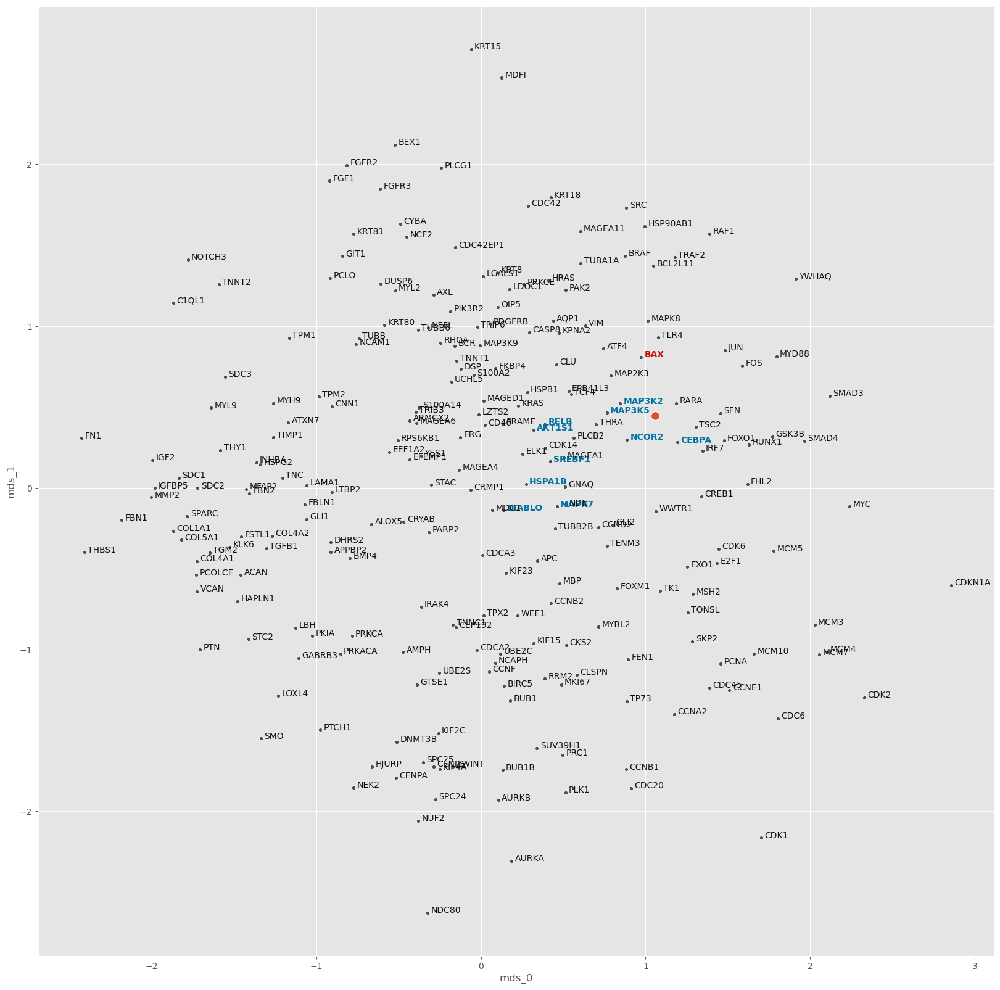

BCL2L11
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.015841566913184665
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.05224882811307907
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


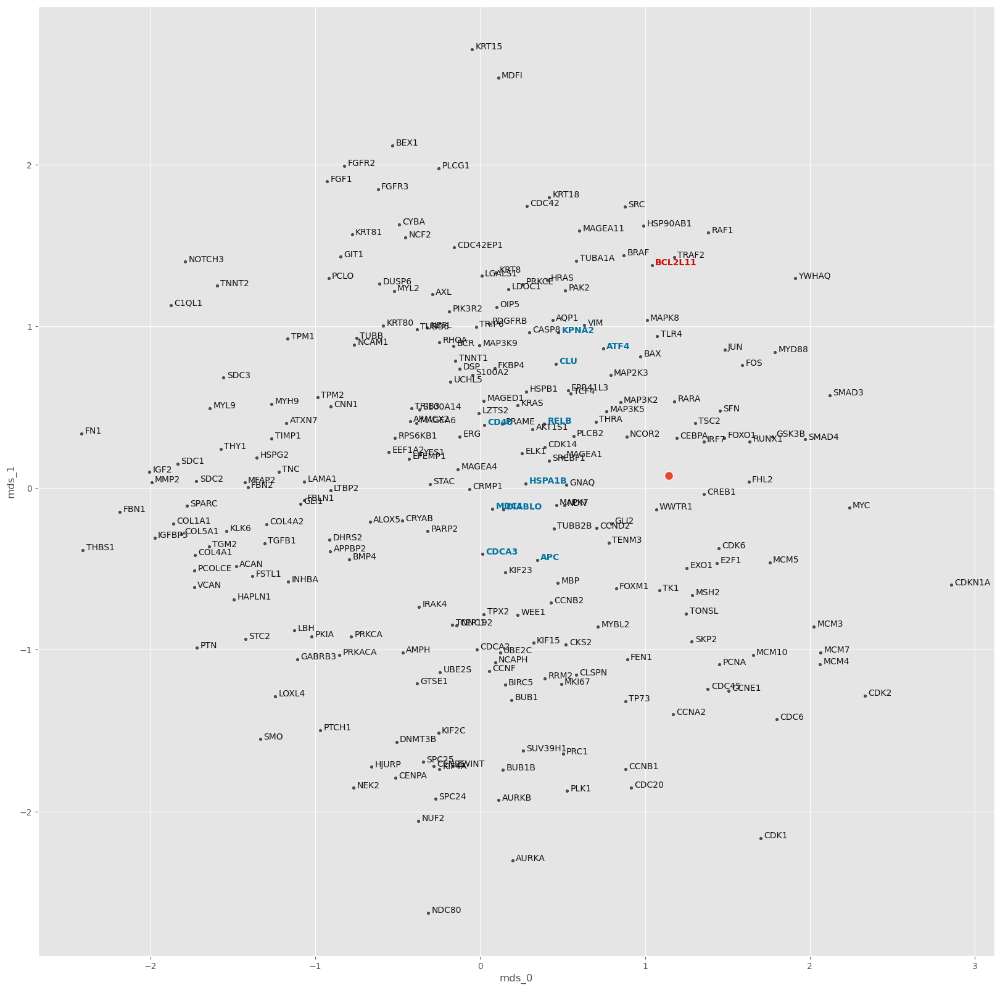

BRAF
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.015595795143218268
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.026666488498449326
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


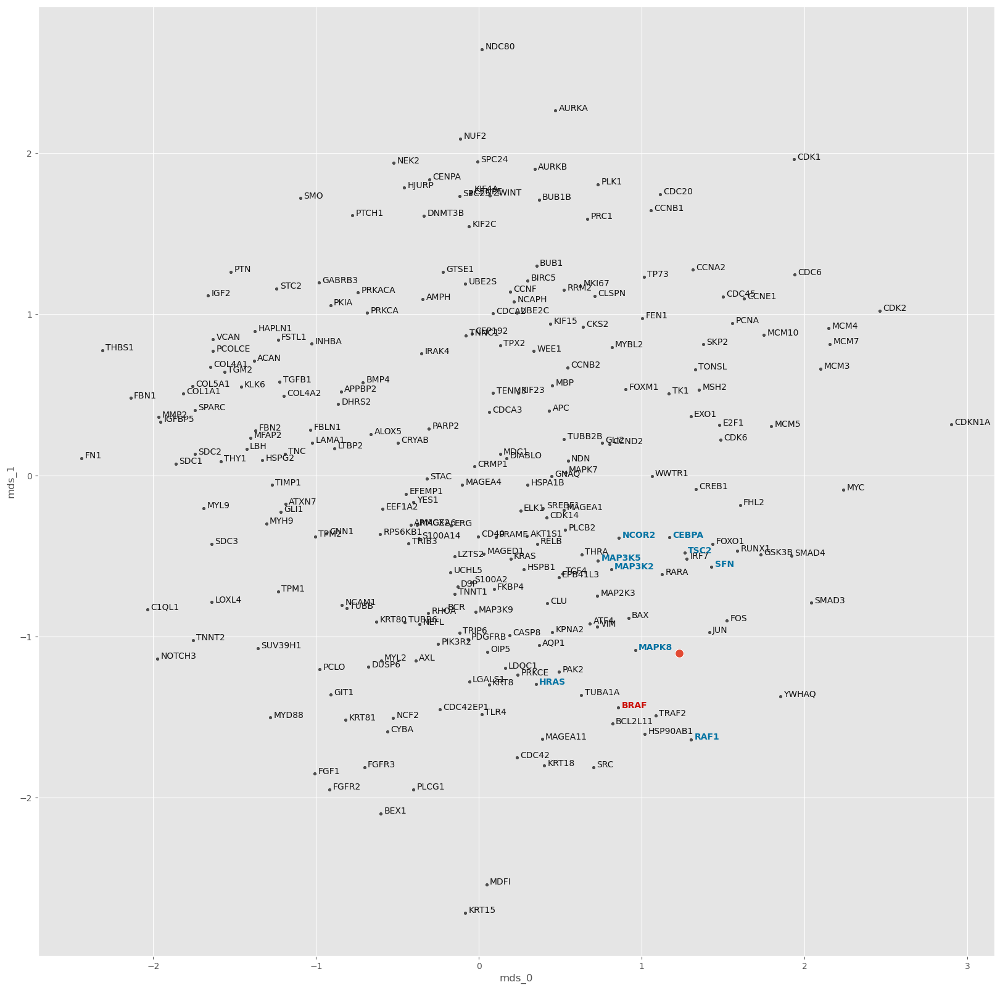

CASP8
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.01572527053455512
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.08520866930484772
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


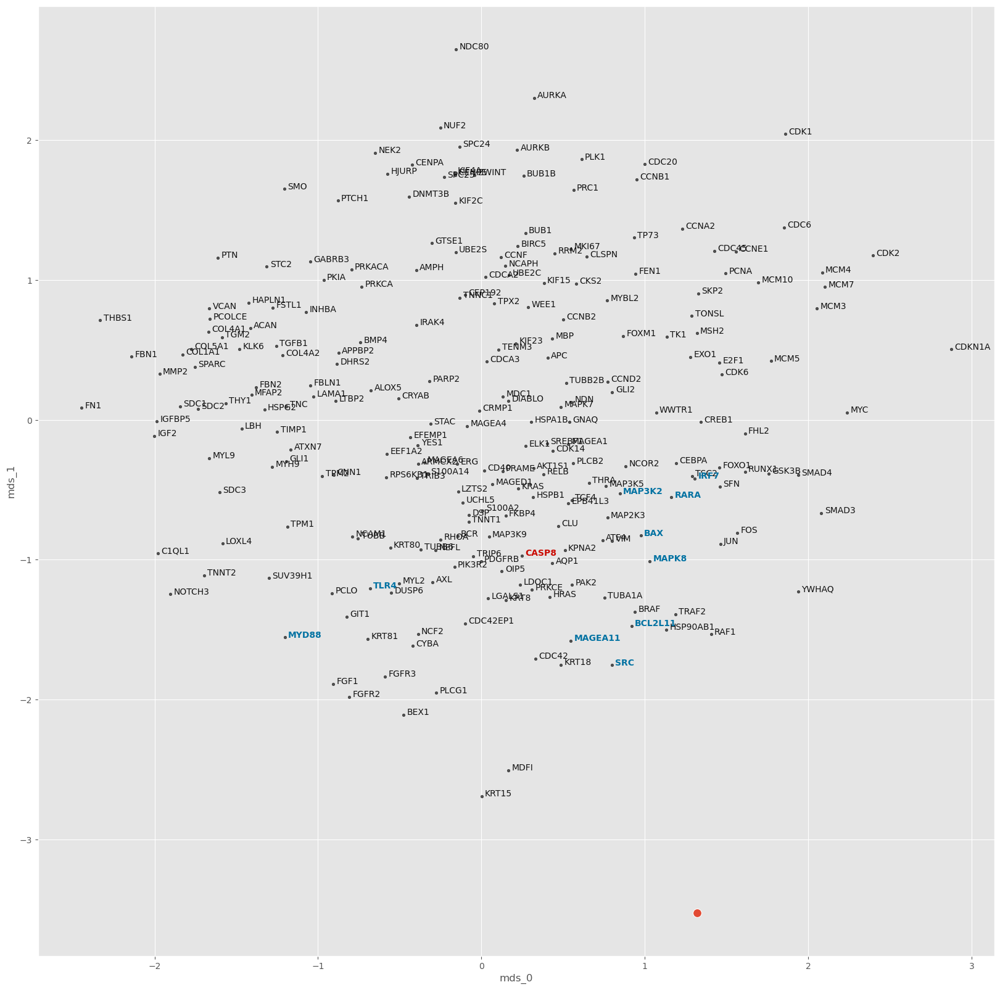

CDC42
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.016143543645739555
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.061933621764183044
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


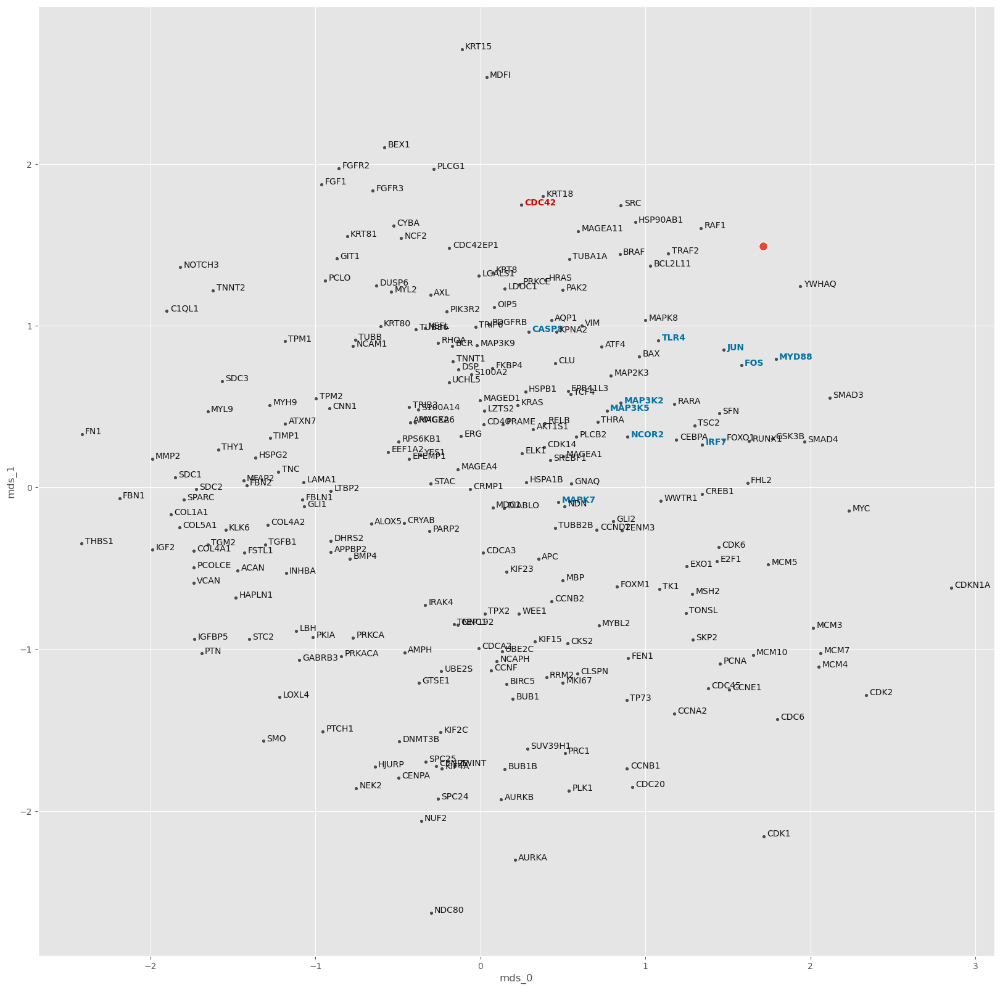

CDKN1A
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.015645697358108702
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.13617581129074097
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


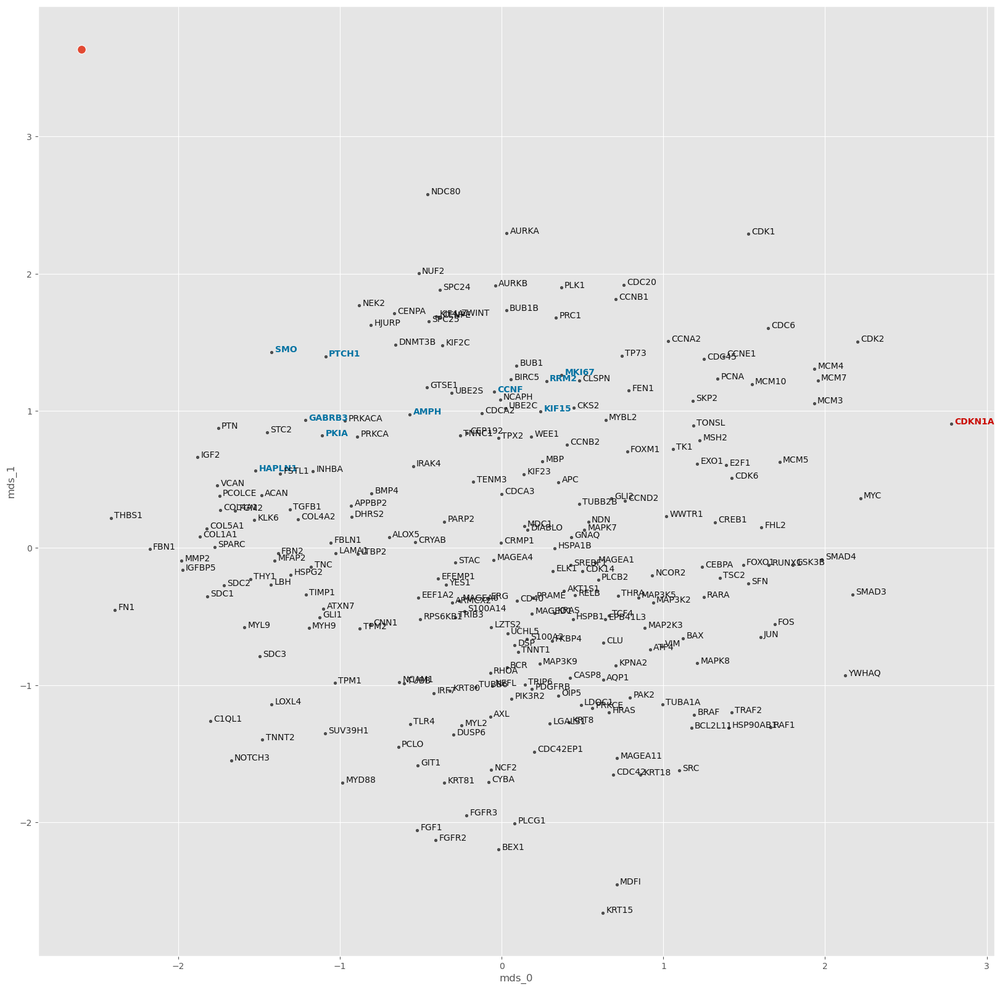

CEBPA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.015206309434558665
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.03685237467288971
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


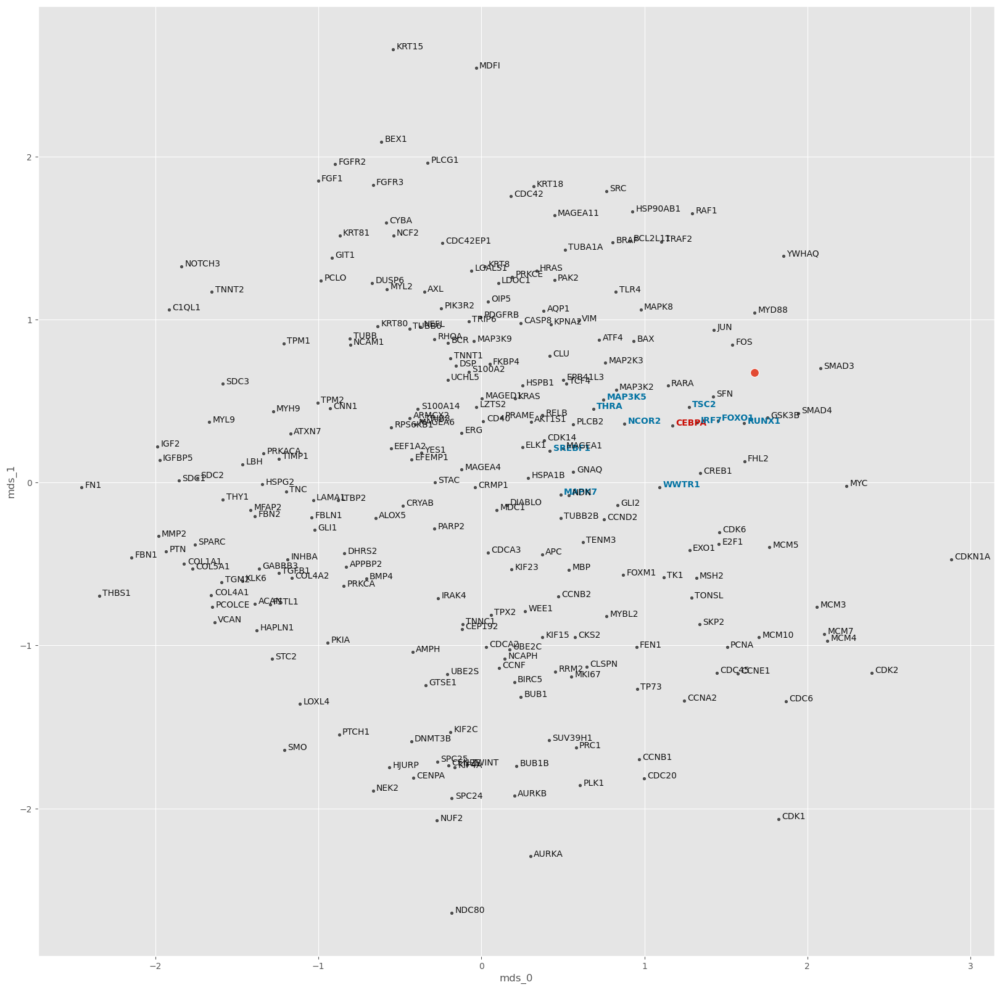

CREB1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.014983715001671087
train top-k accuracies: {1: 0.952381, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.952381, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.047322750091552734
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


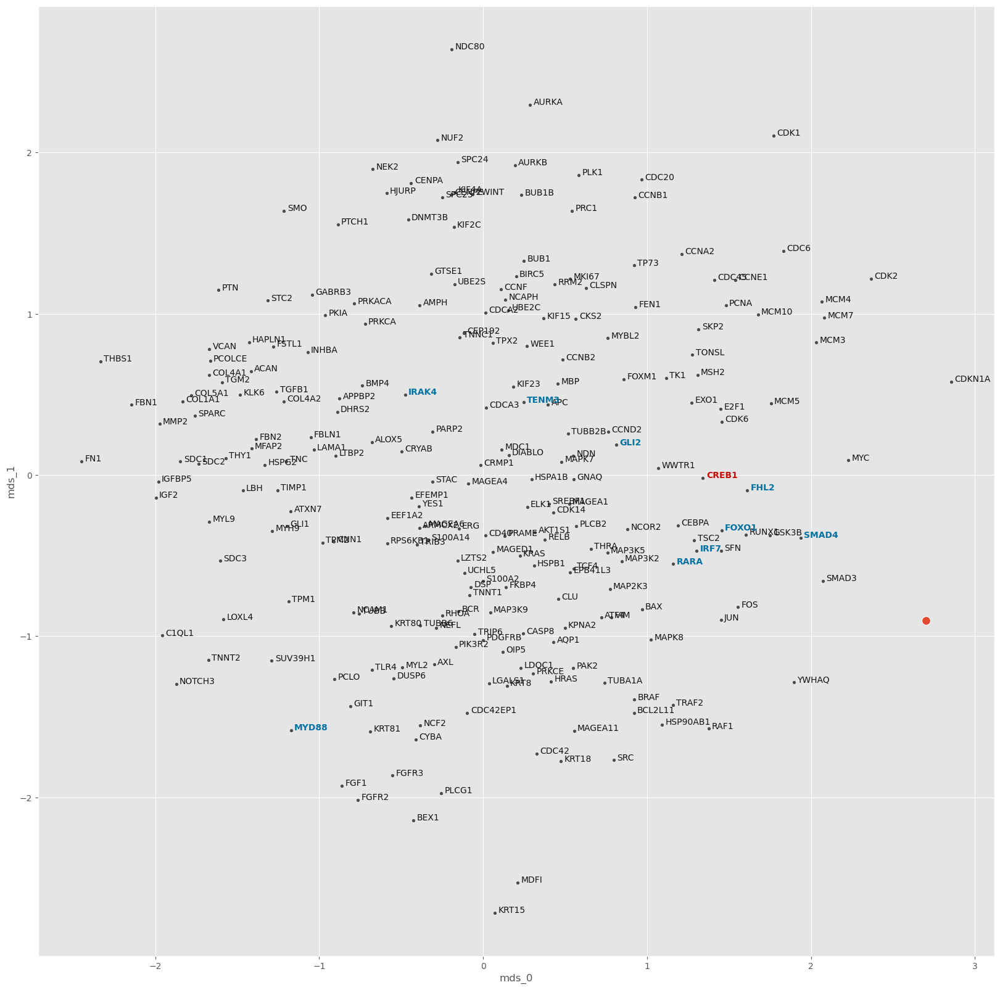

DIABLO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.014669112462018217
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.038464151322841644
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


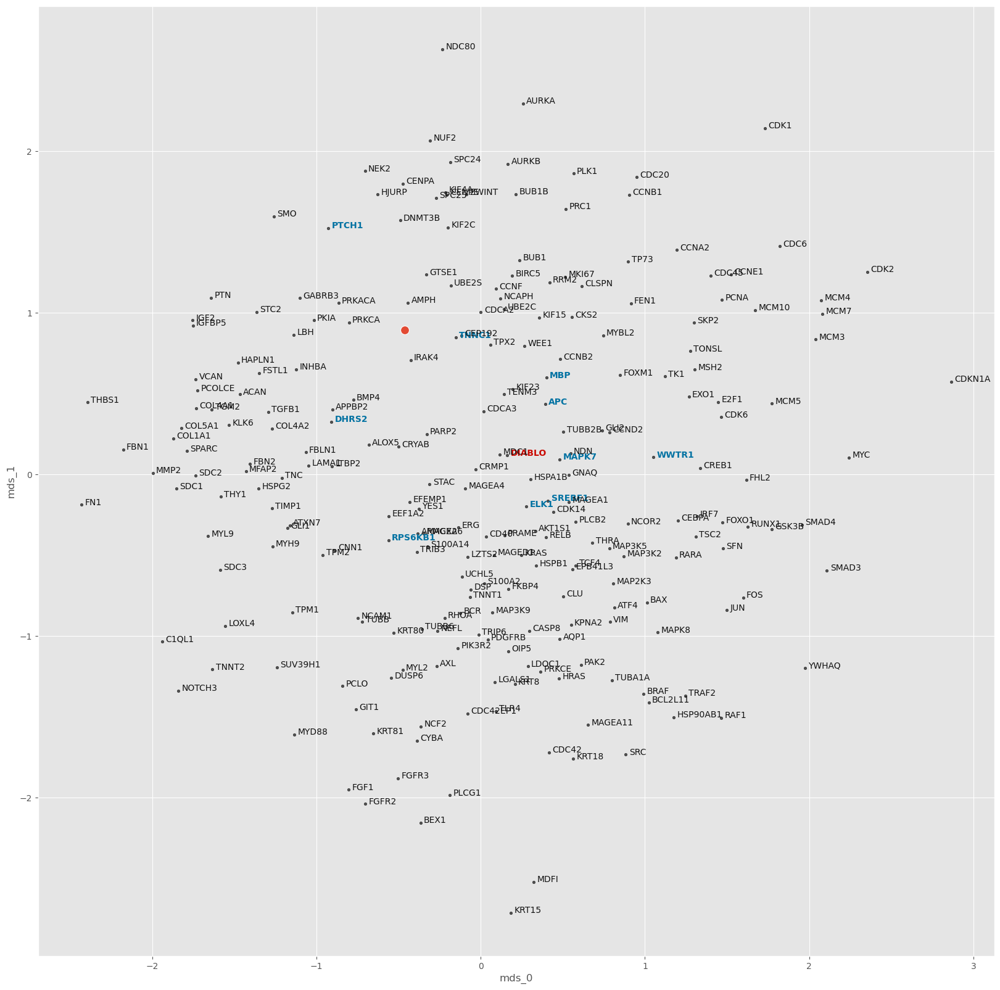

E2F1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.015306447676959493
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.07505117356777191
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


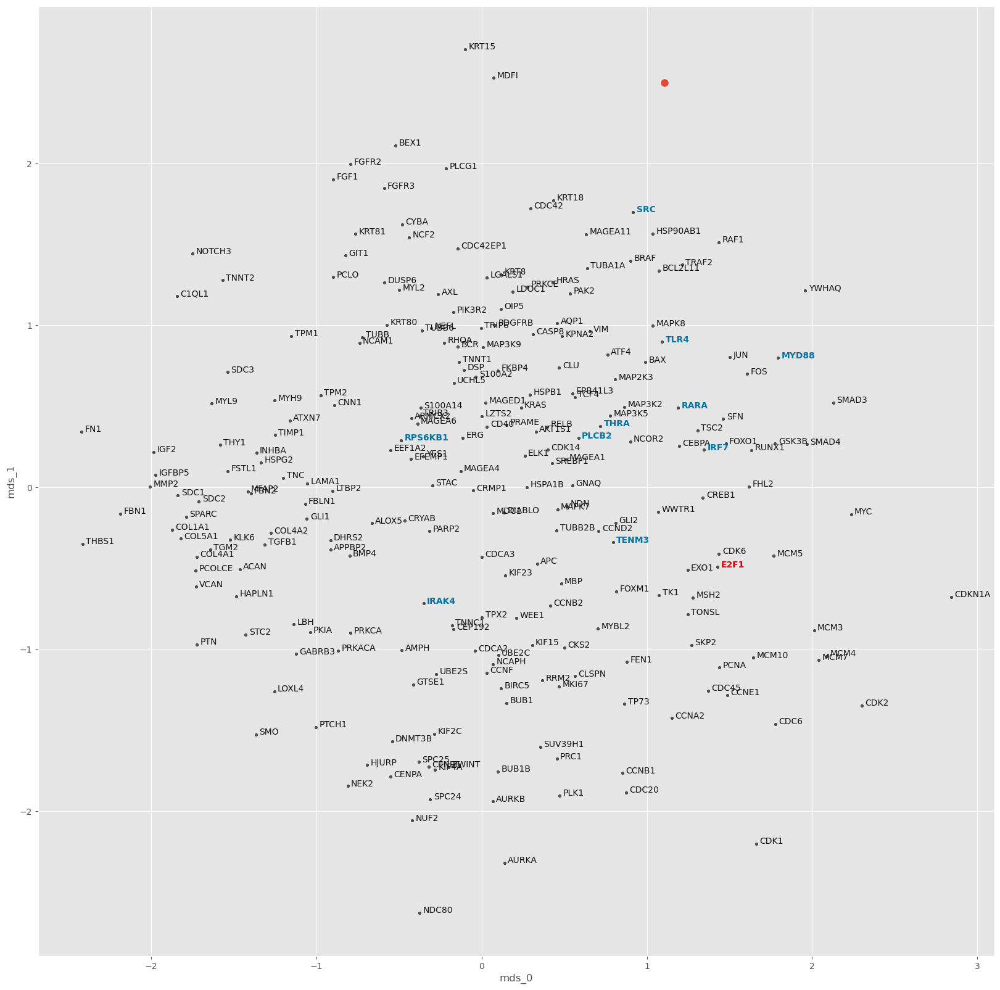

ELK1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.01561367099306413
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.050252728164196014
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


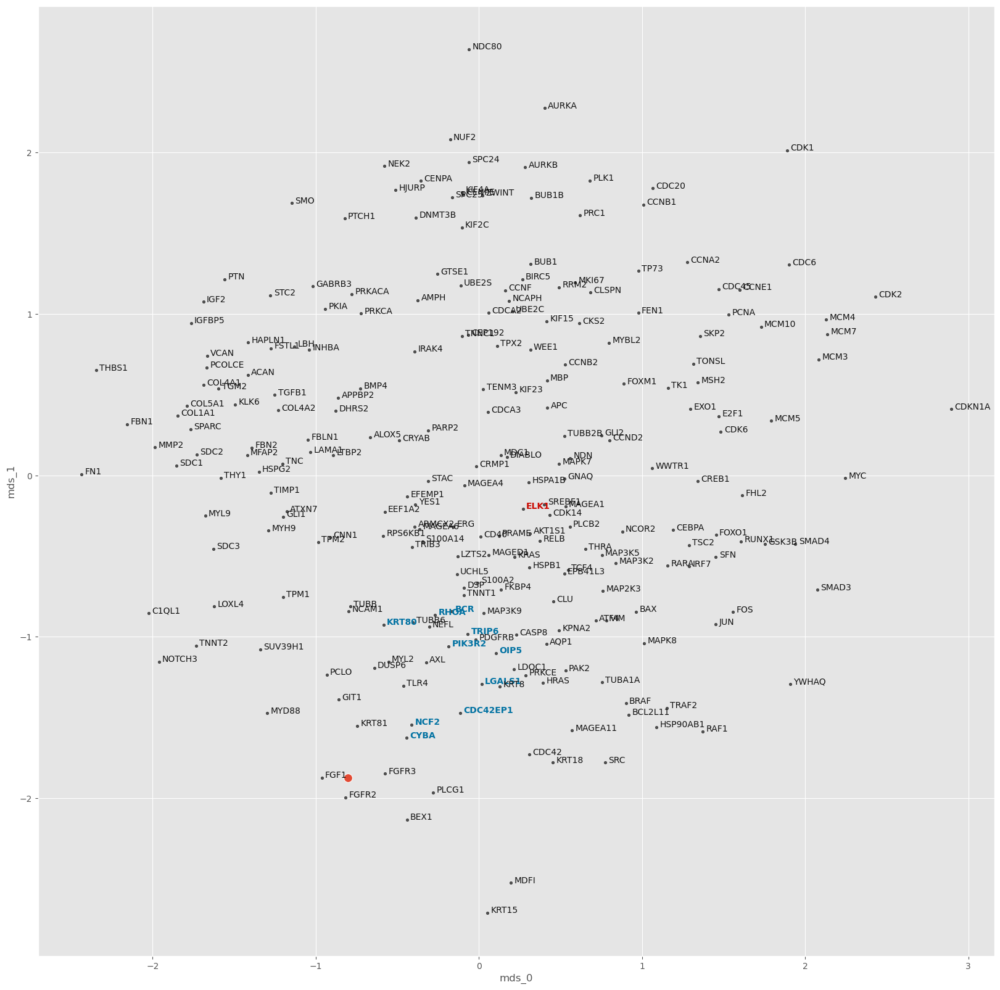

ERG
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.01653241268580868
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0574478805065155
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


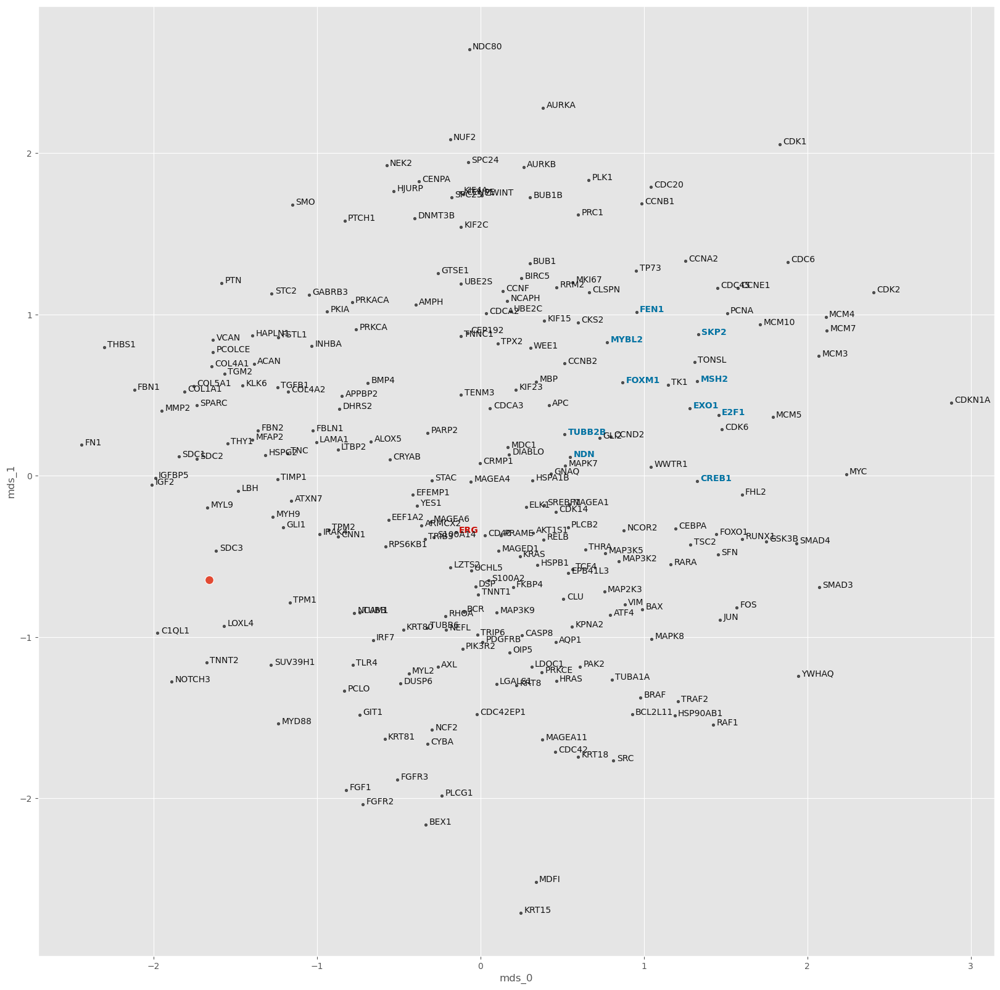

FGFR3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.015553452473665987
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.047978997230529785
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


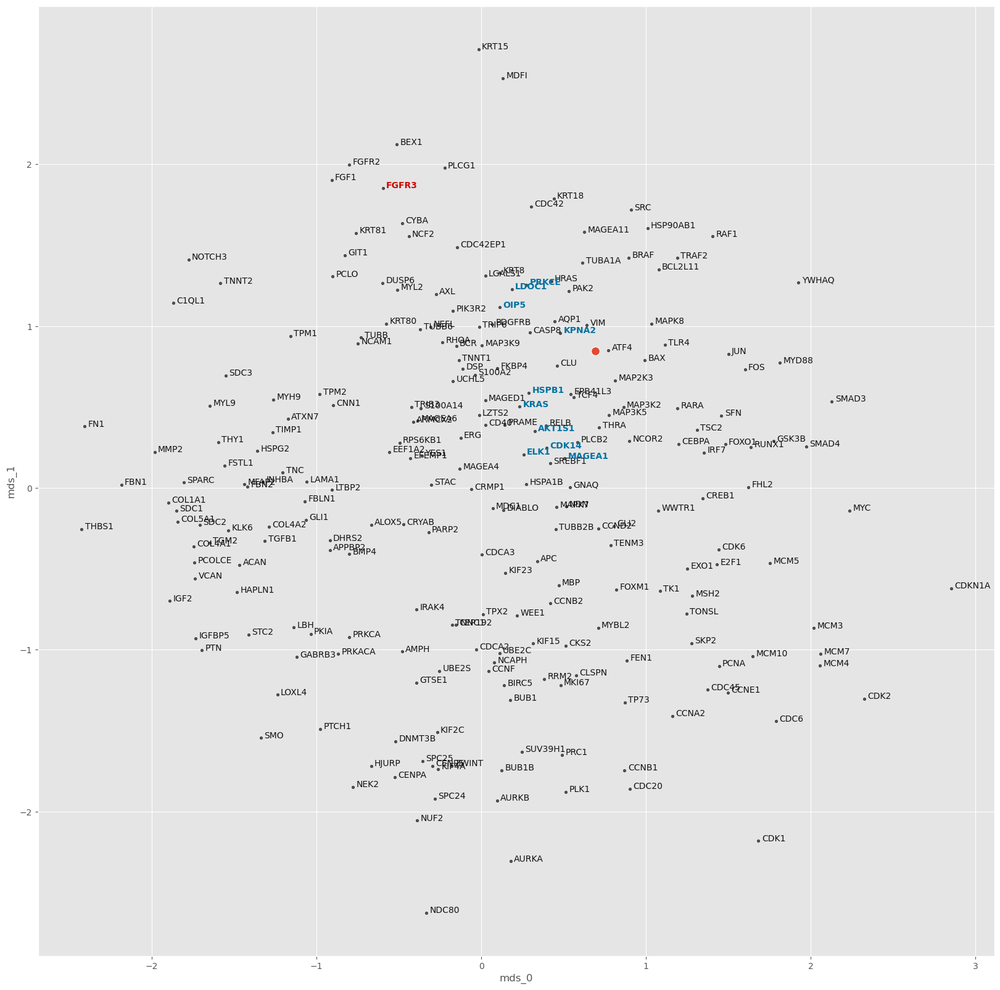

FOXO1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.015852485472957294
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.027186693623661995
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


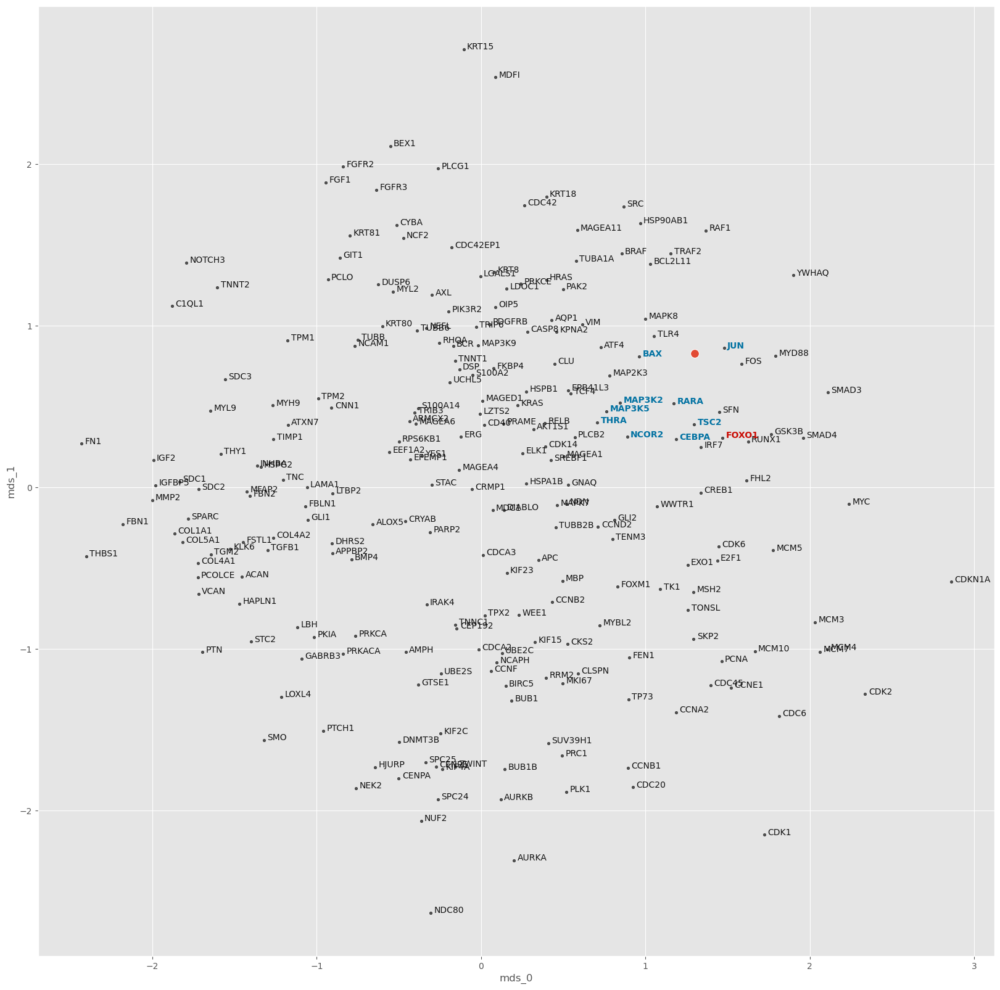

GLI1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.015826975438921226
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.053355276584625244
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


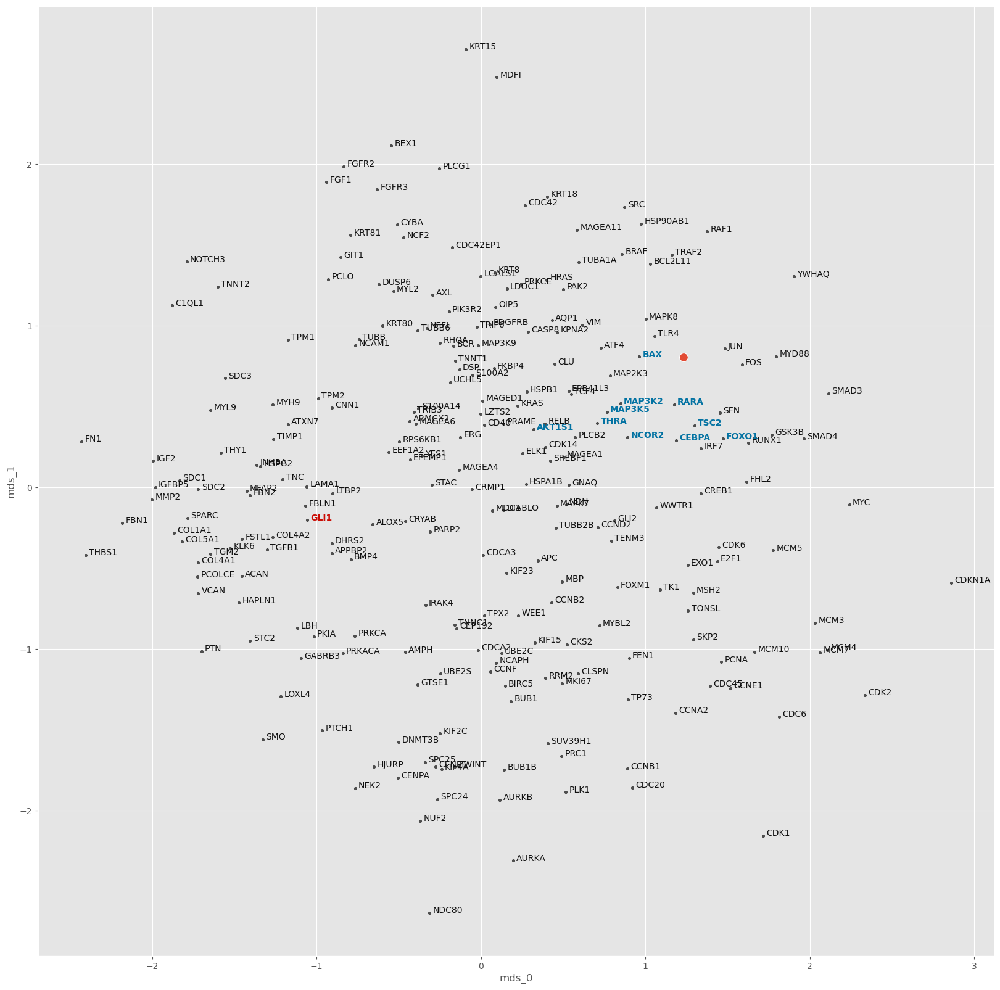

HRAS
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.01522244011894578
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.1233348697423935
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


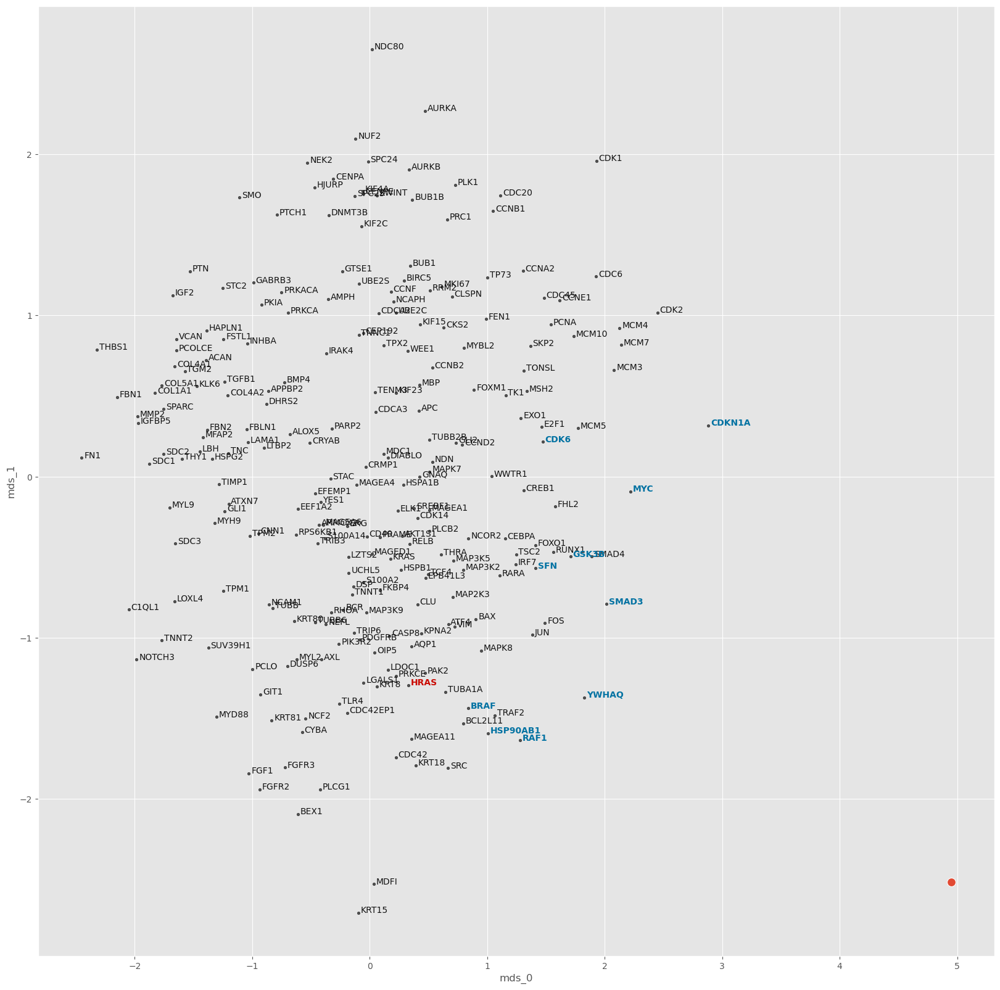

IRAK4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.014780690671787375
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0500410757958889
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


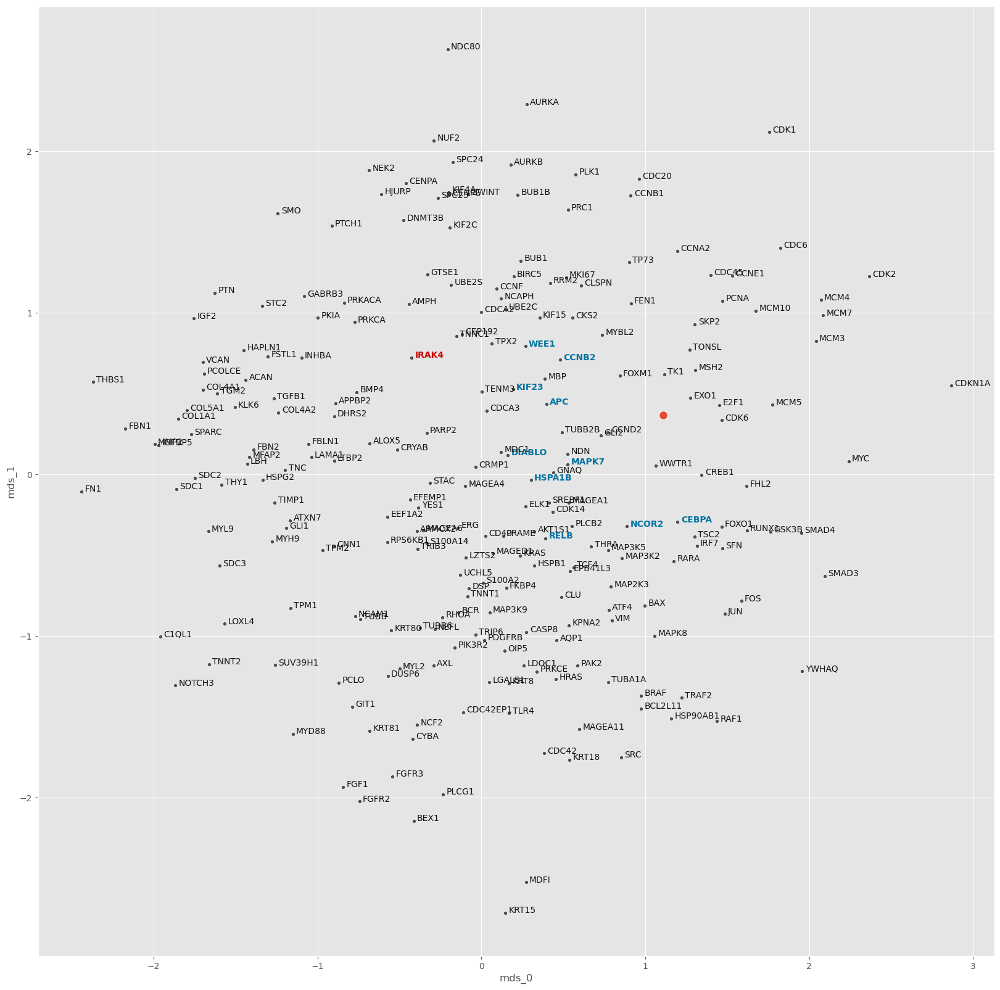

JUN
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.016174778963128727
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.06604243814945221
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


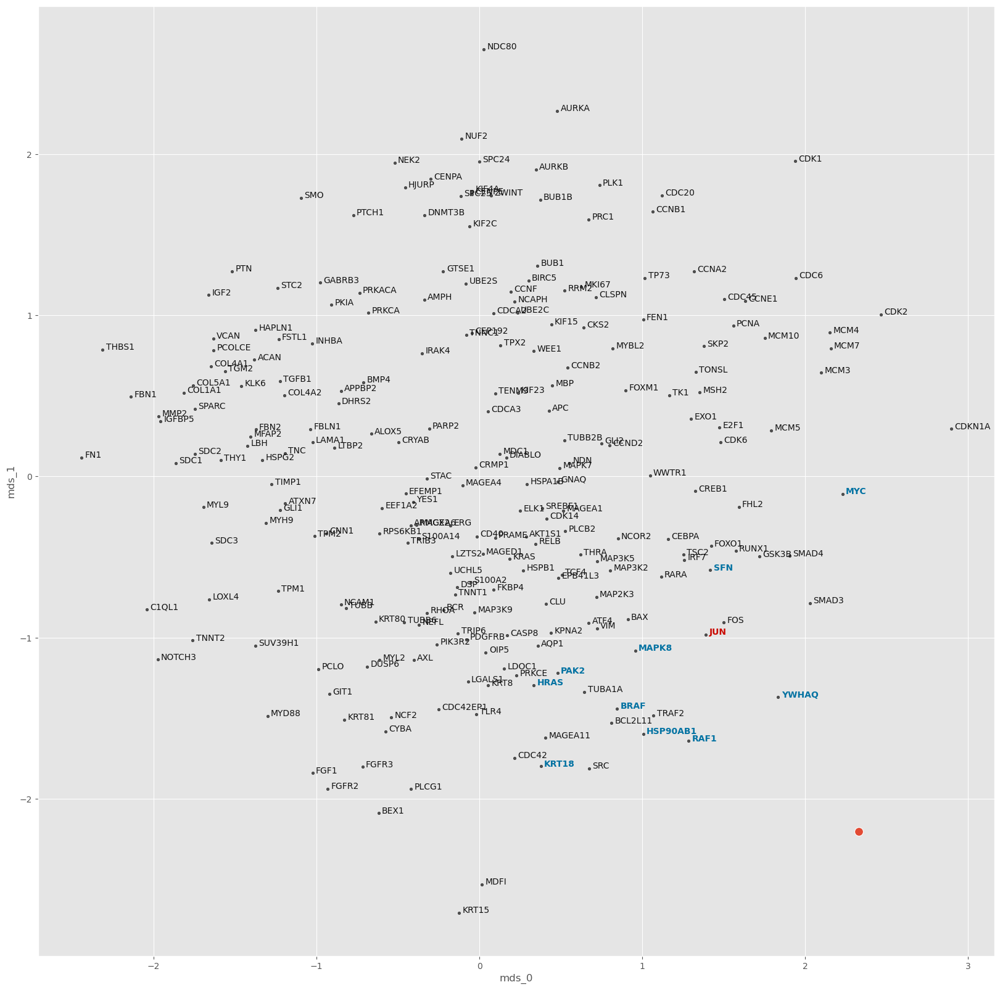

KRAS
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.01607659902601015
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.024904301390051842
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


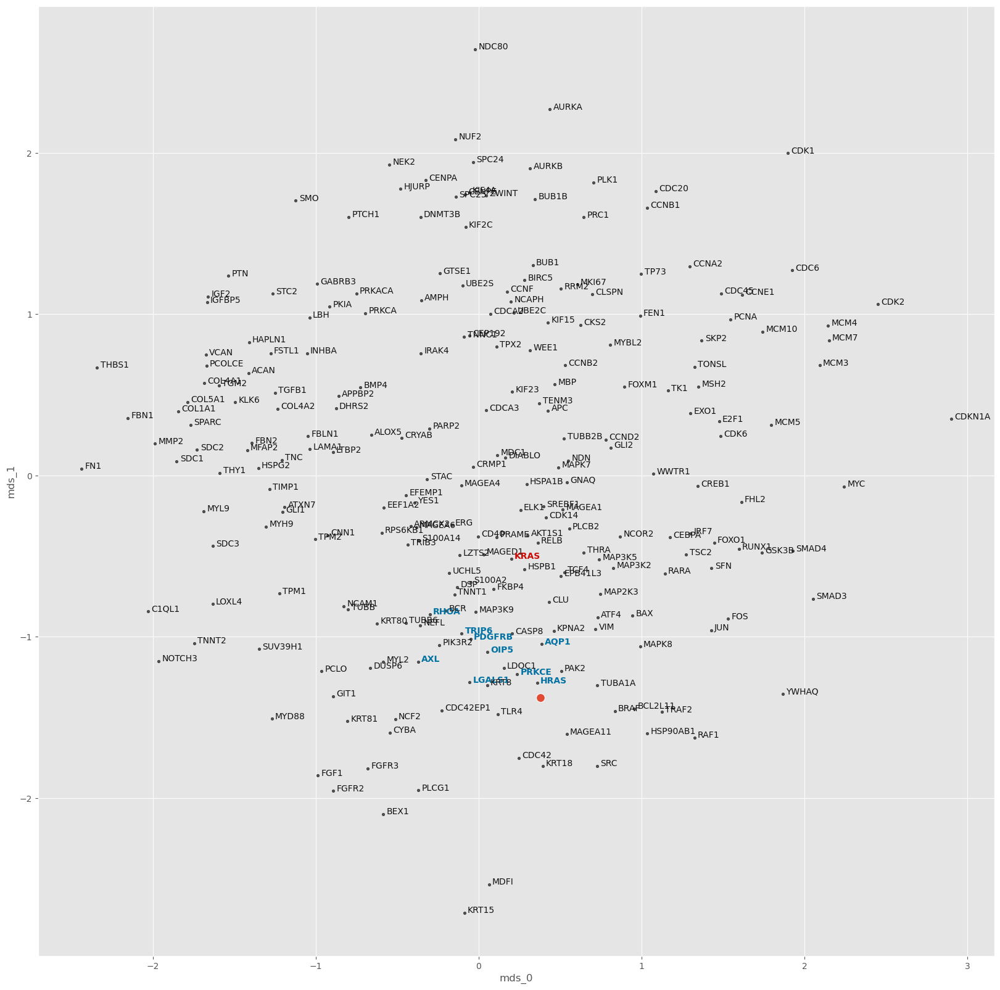

MAP2K3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.016574177092739513
train top-k accuracies: {1: 0.952381, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.952381, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.03684261813759804
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


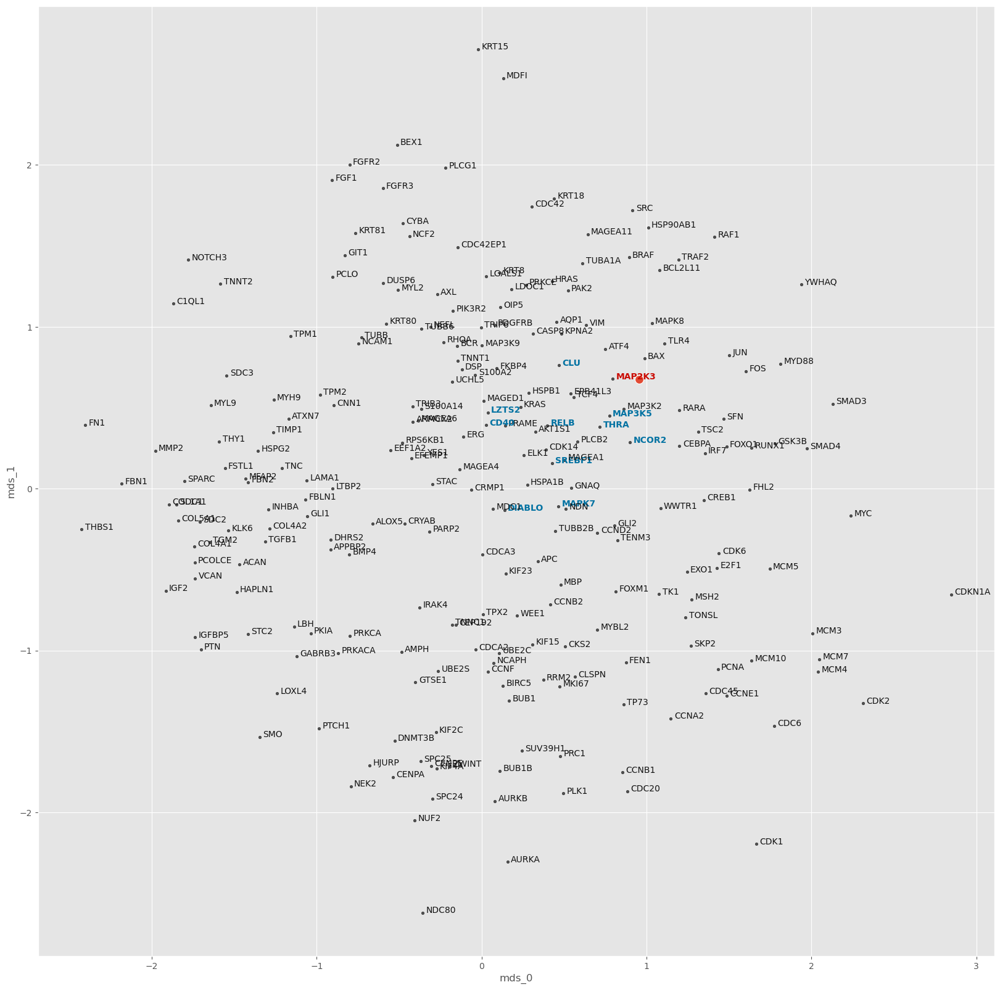

MAP3K2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.015994166245772726
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.030966928228735924
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


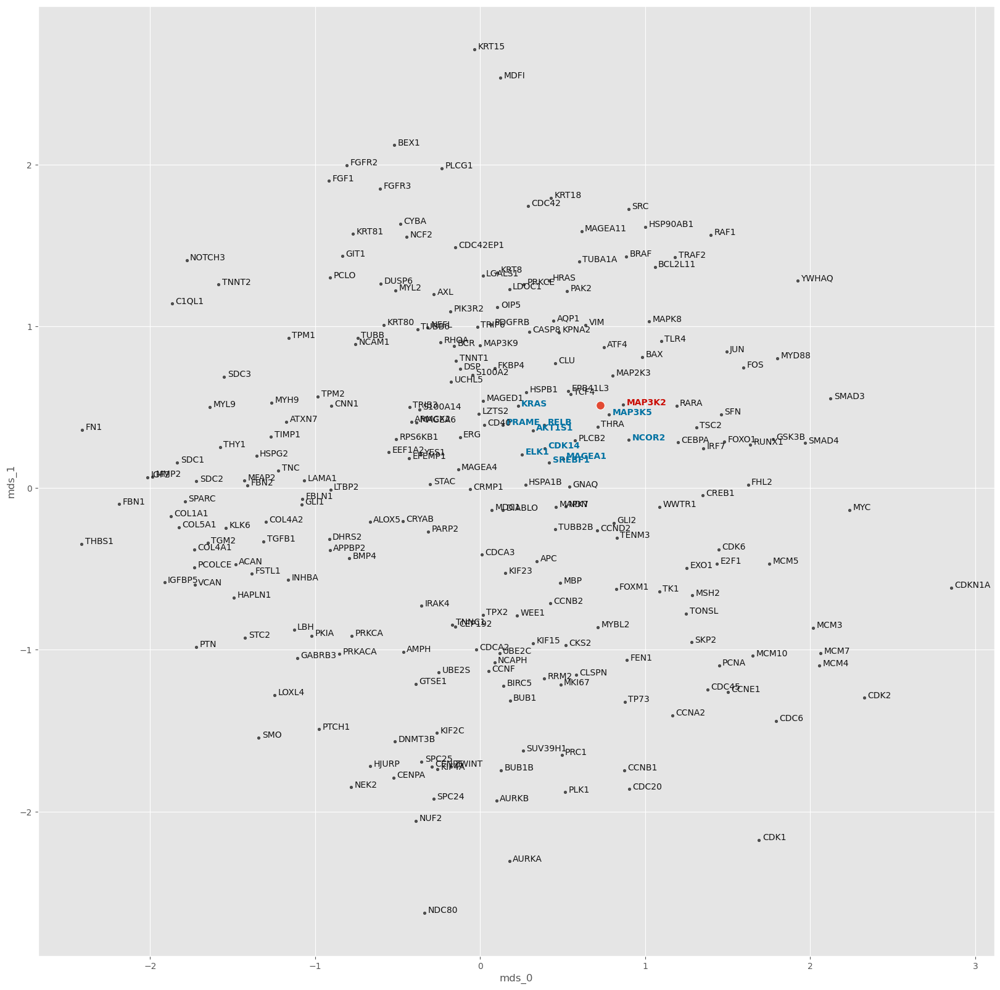

MAP3K5
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.016648173864398683
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.03324183076620102
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


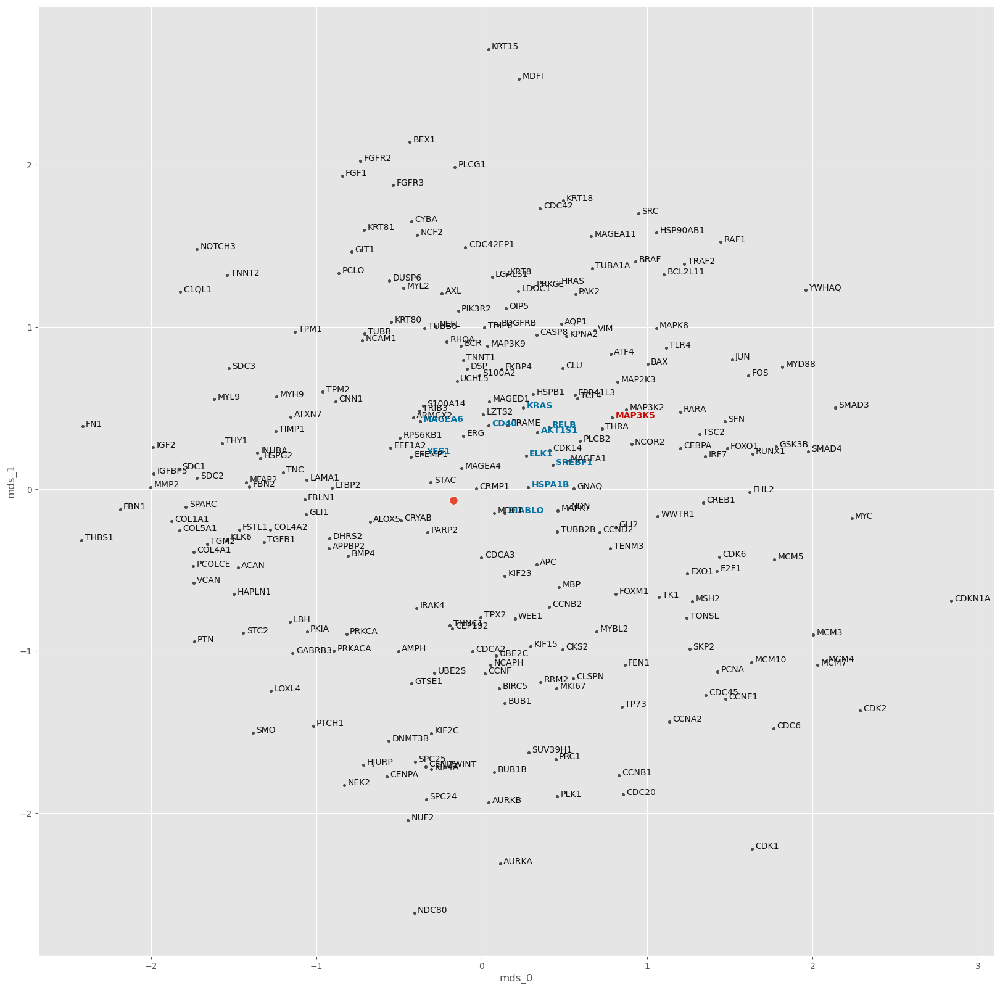

MAP3K9
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.015759167971000784
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.09592950344085693
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


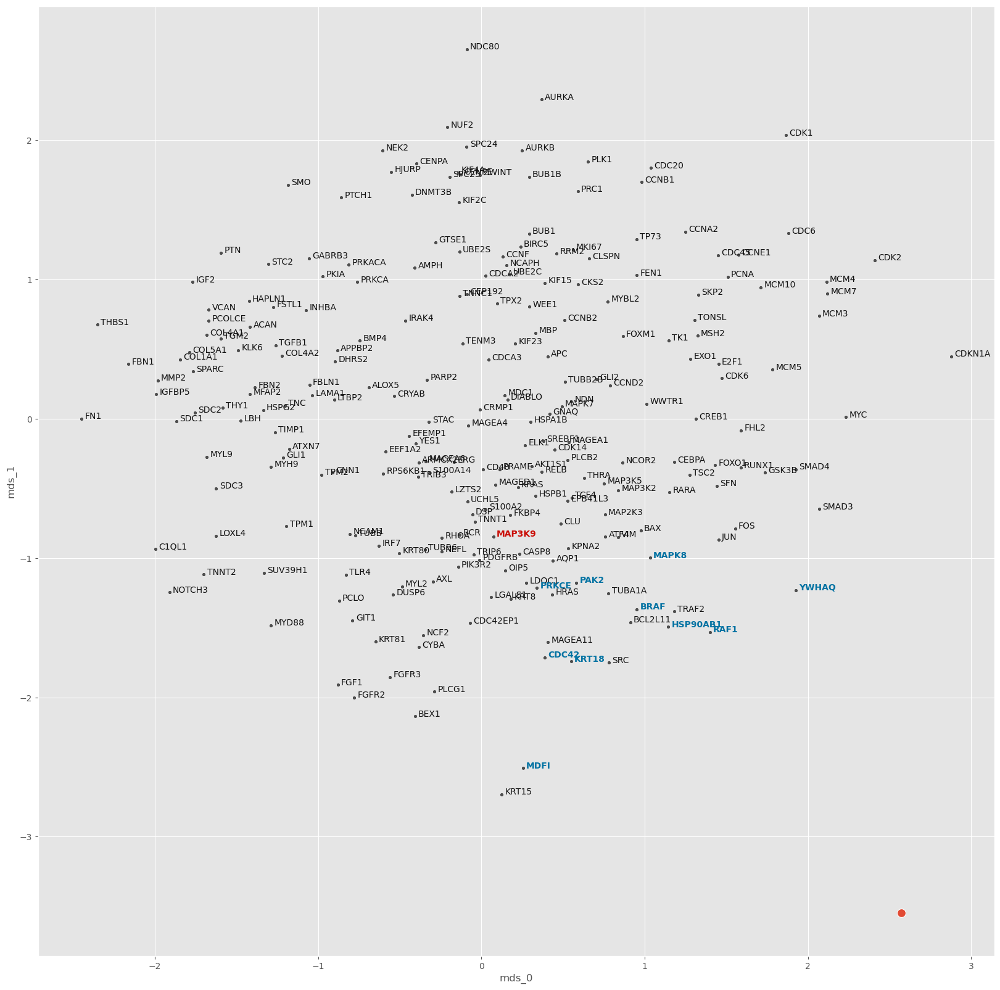

MAPK7
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.01525401332903476
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0293990857899189
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


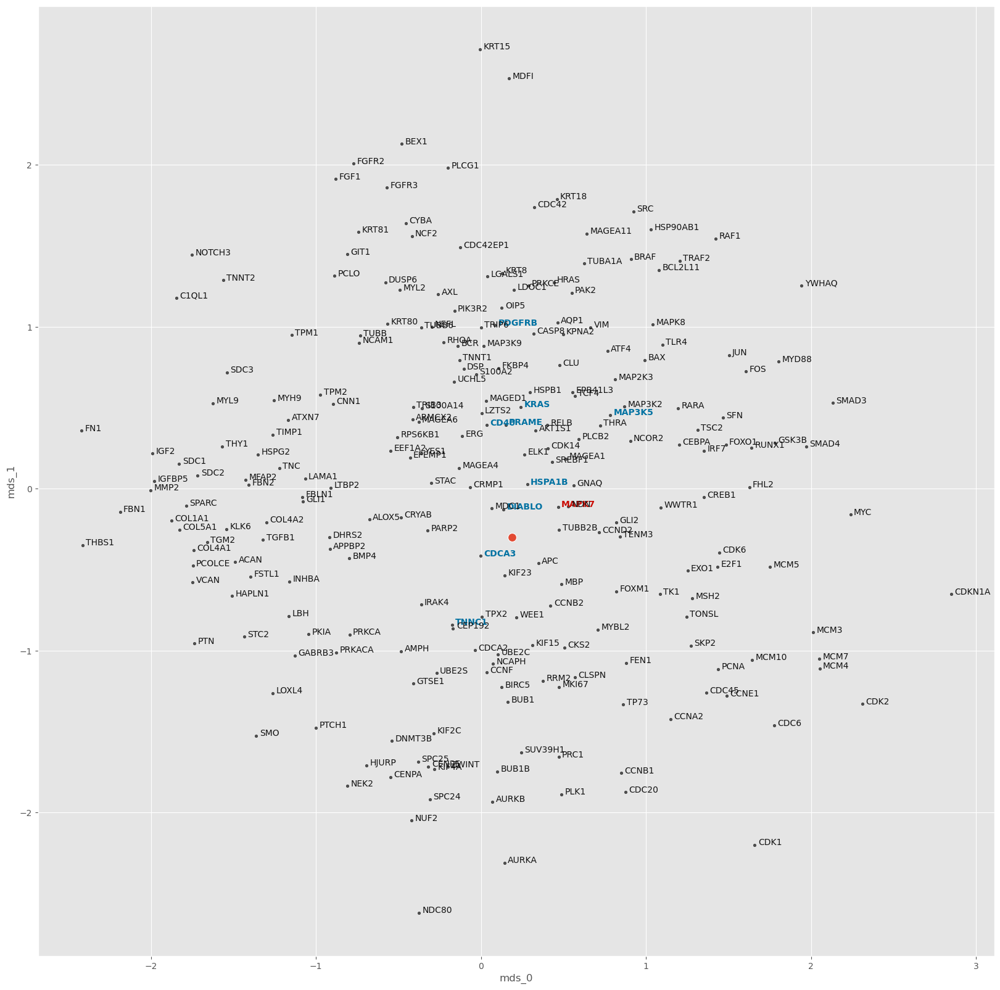

MYD88
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.016745686176277343
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0476861298084259
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


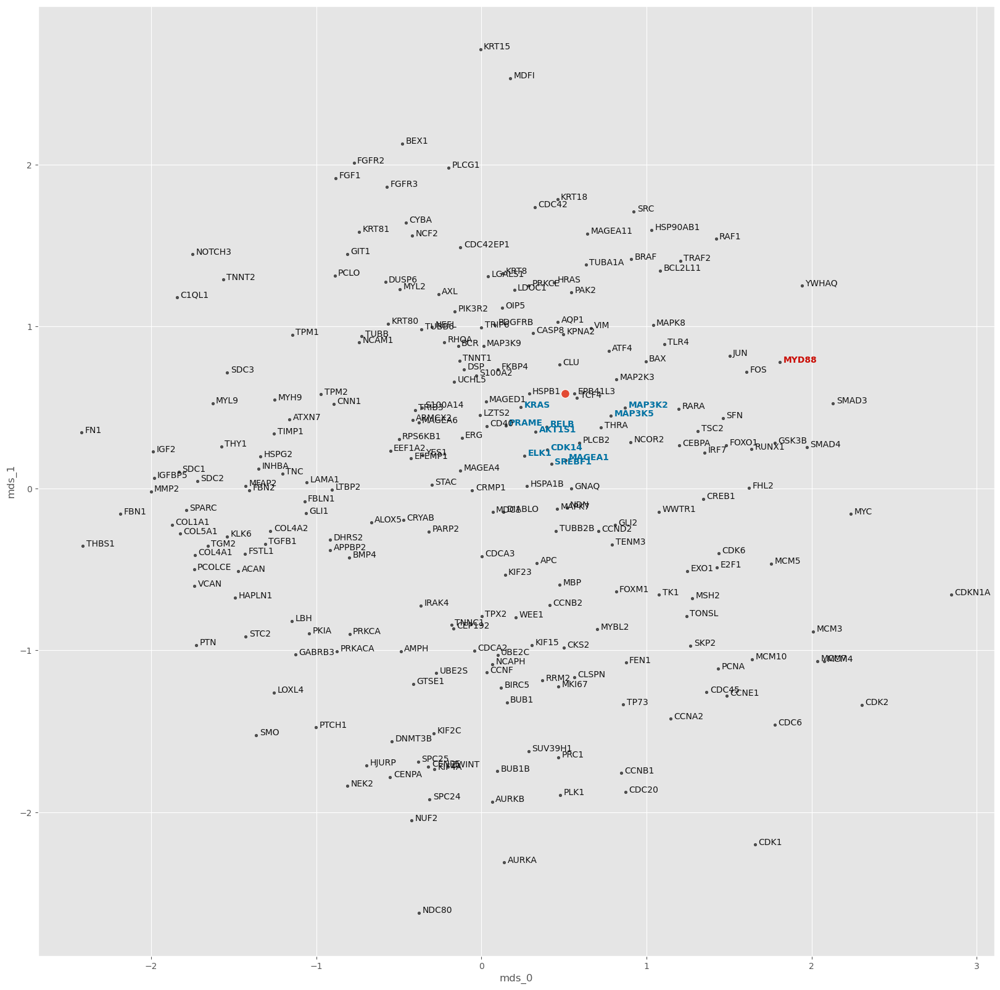

PIK3R2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.01639187220661413
train top-k accuracies: {1: 0.952381, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.952381, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.030566230416297913
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


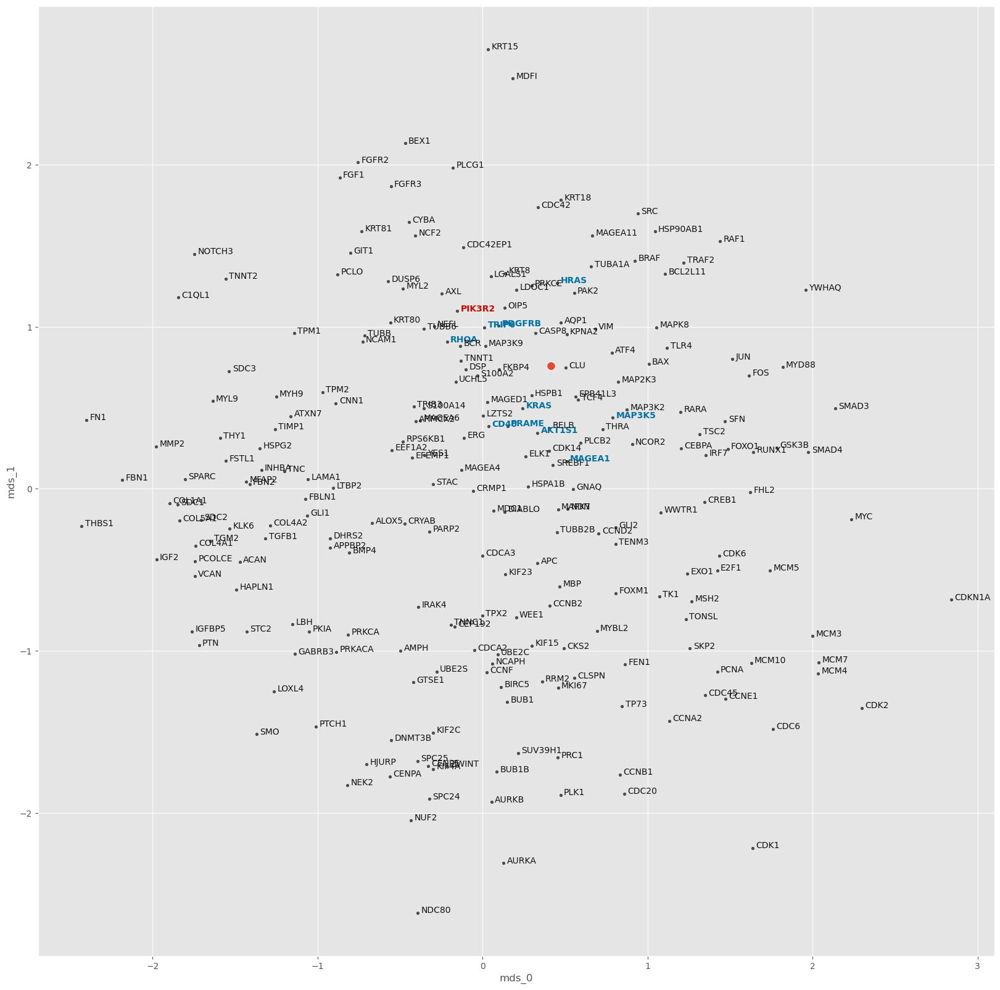

PKIA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.01665452326692286
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.042367808520793915
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


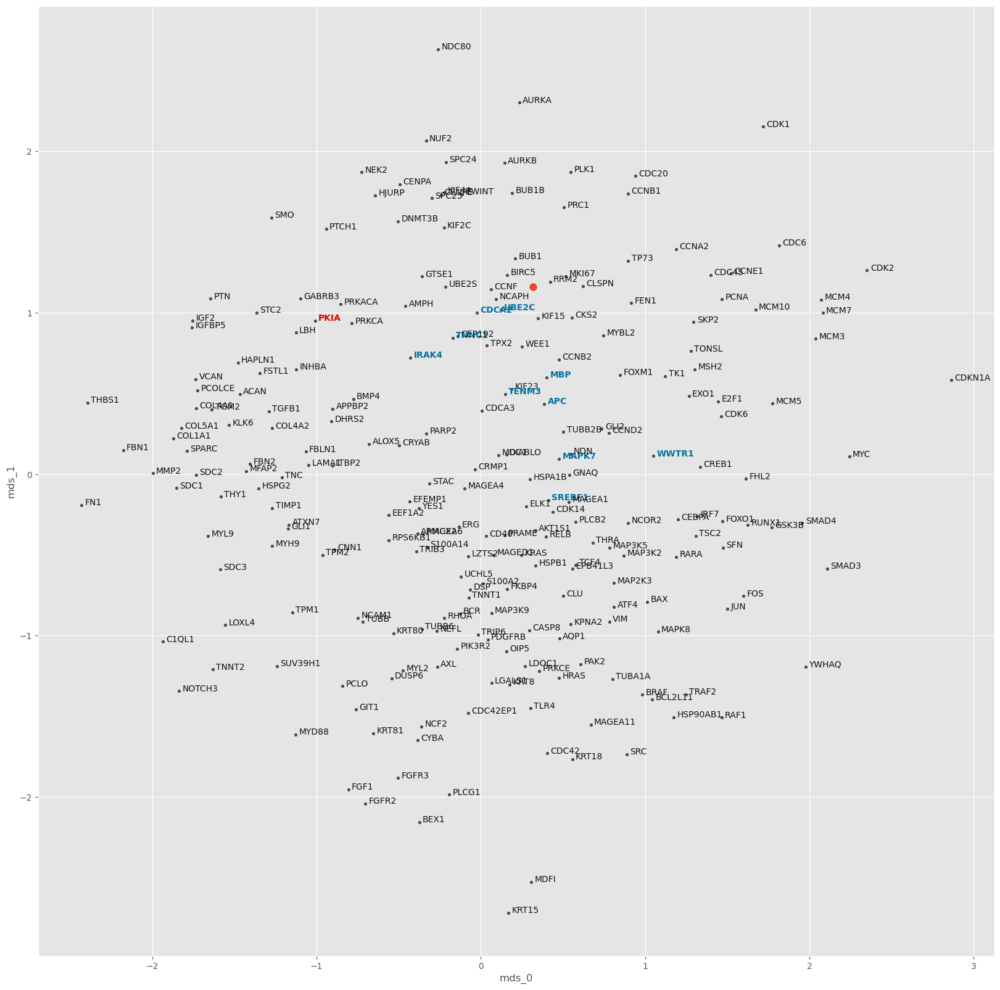

PRKACA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.015808311911920708
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.06936748325824738
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


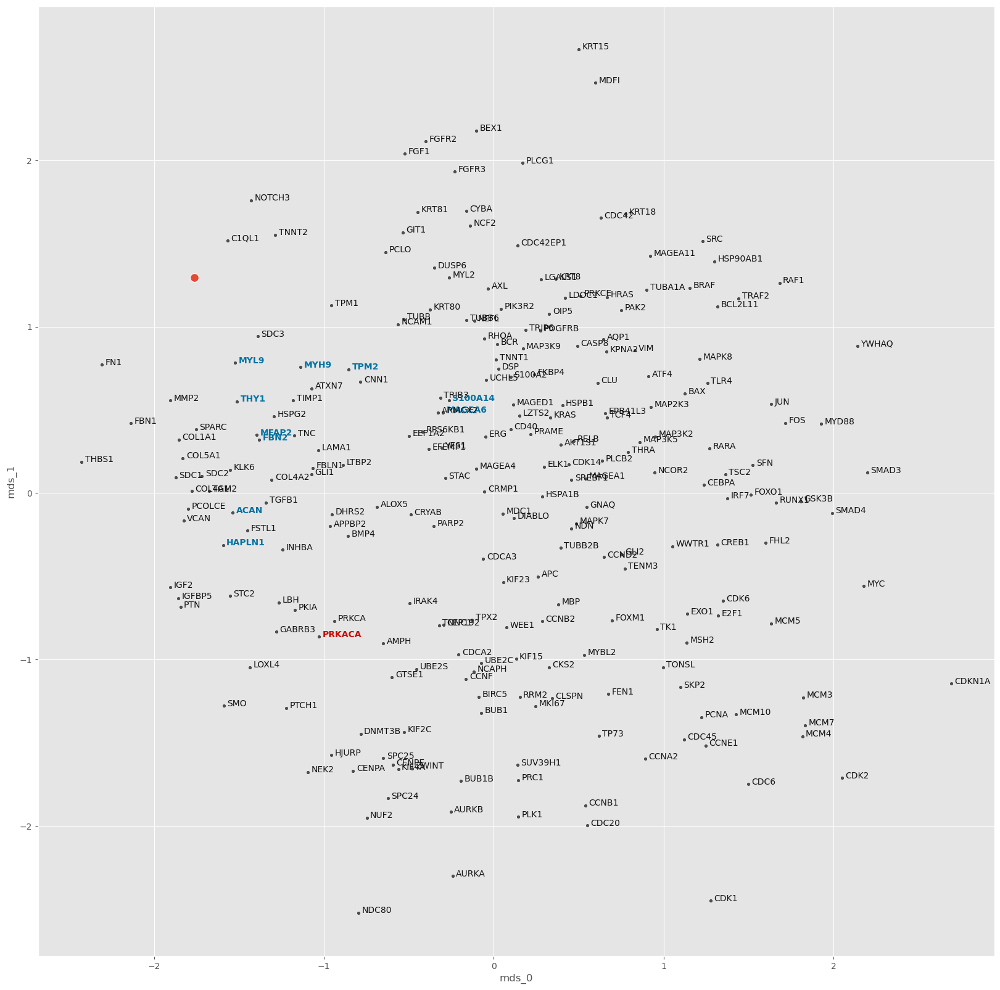

PRKCE
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.01573625561736879
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.024851838126778603
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


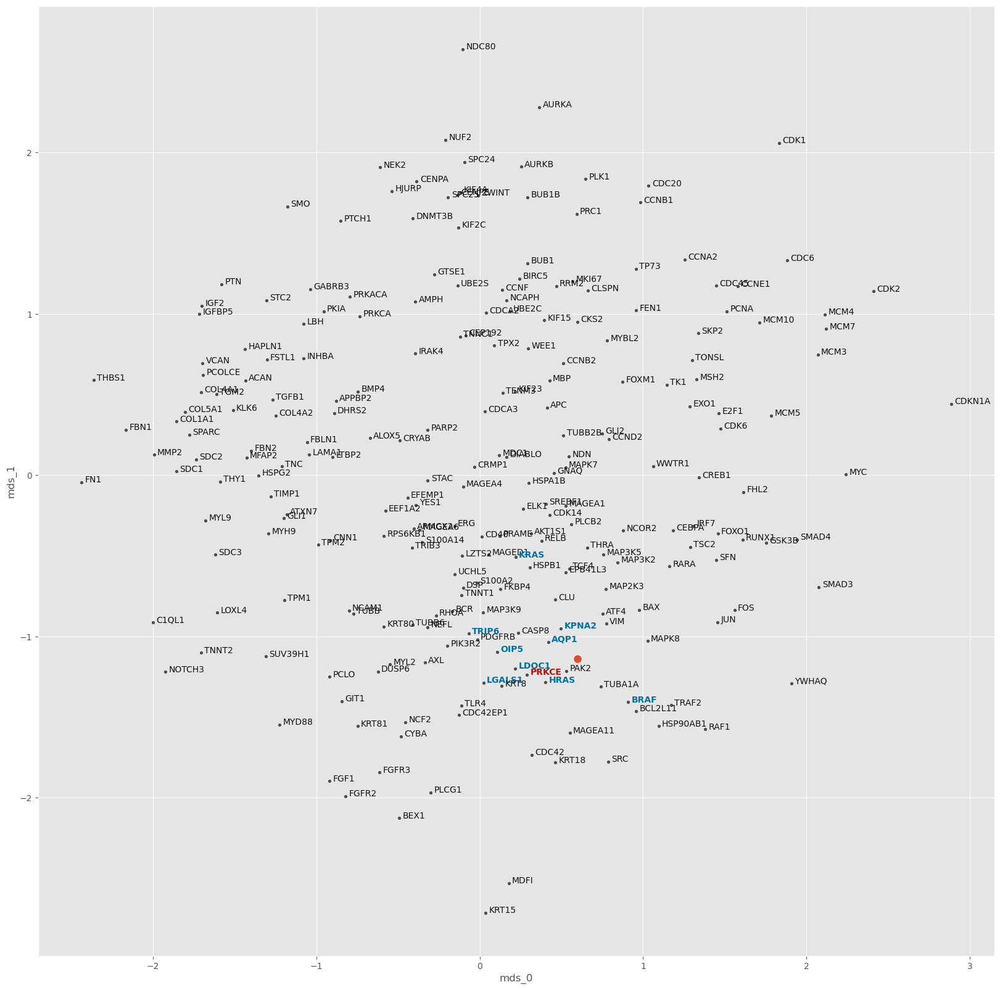

RAF1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.015875636067773615
train top-k accuracies: {1: 0.952381, 3: 0.97619, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.952381, 3: 0.97619, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.04389619827270508
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


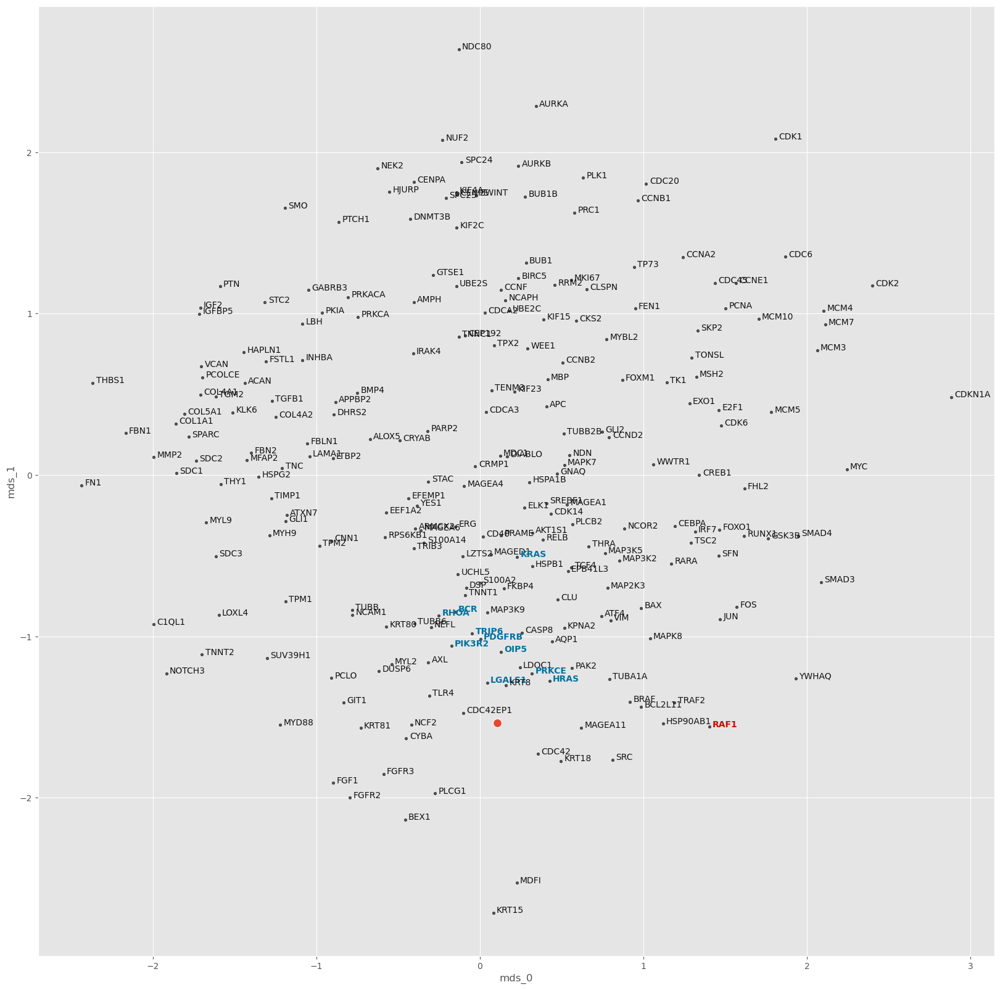

RELB
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.01519626108486028
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.06080517917871475
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


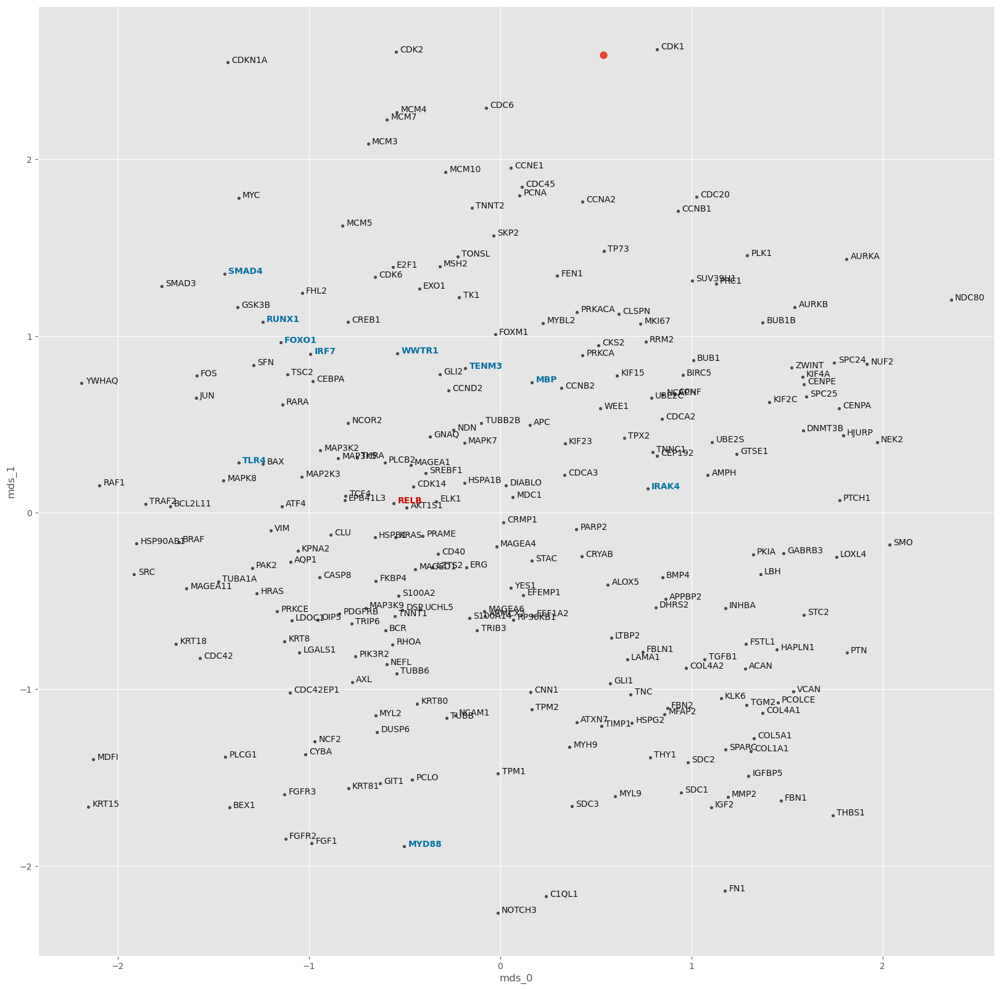

RHOA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.015333520647670542
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.03914450481534004
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


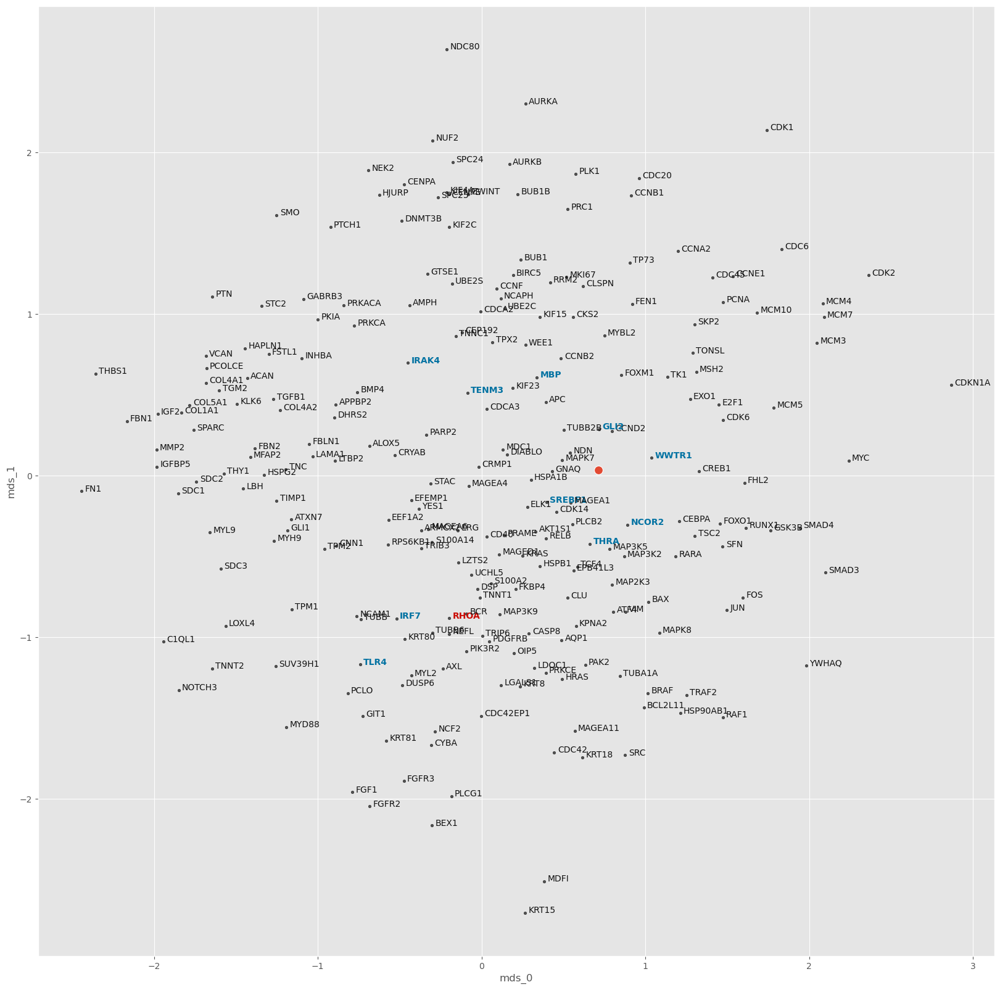

SMAD3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.01670818403363228
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.05842669680714607
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


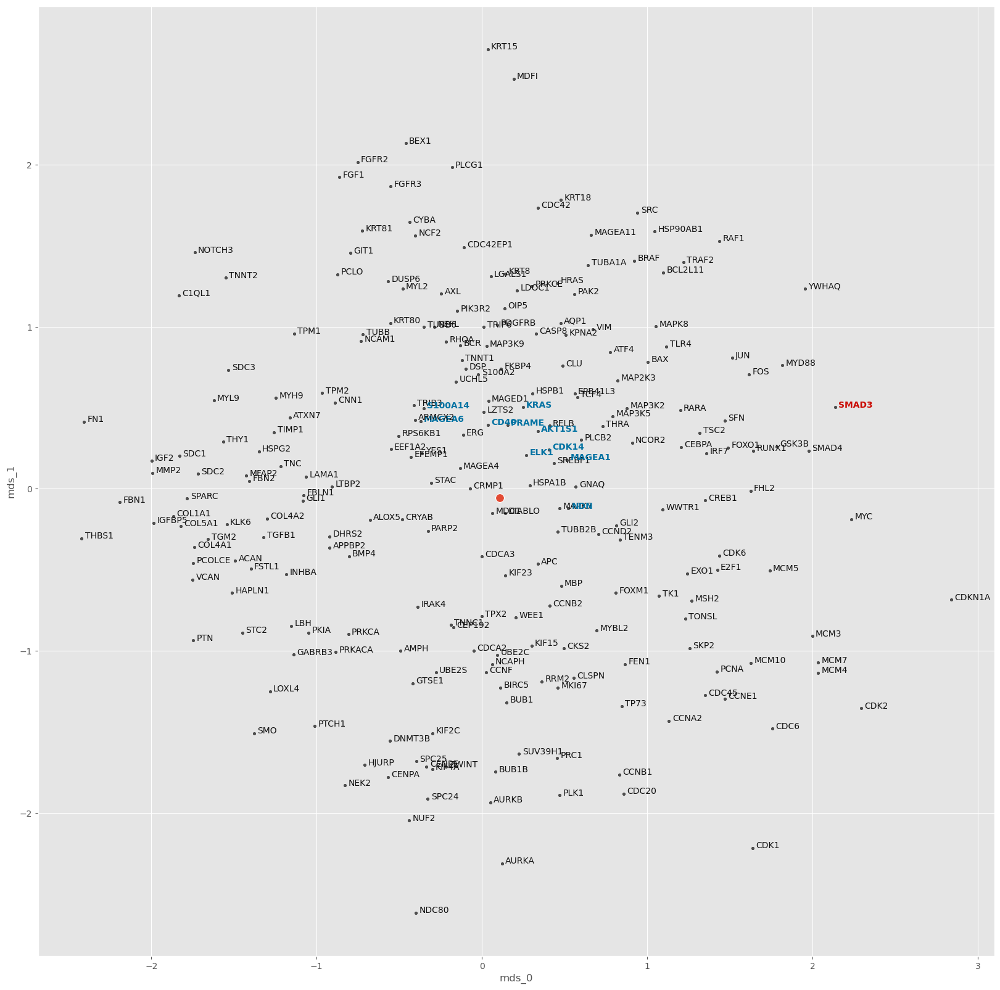

SMAD4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.015530949591525964
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.05222781375050545
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


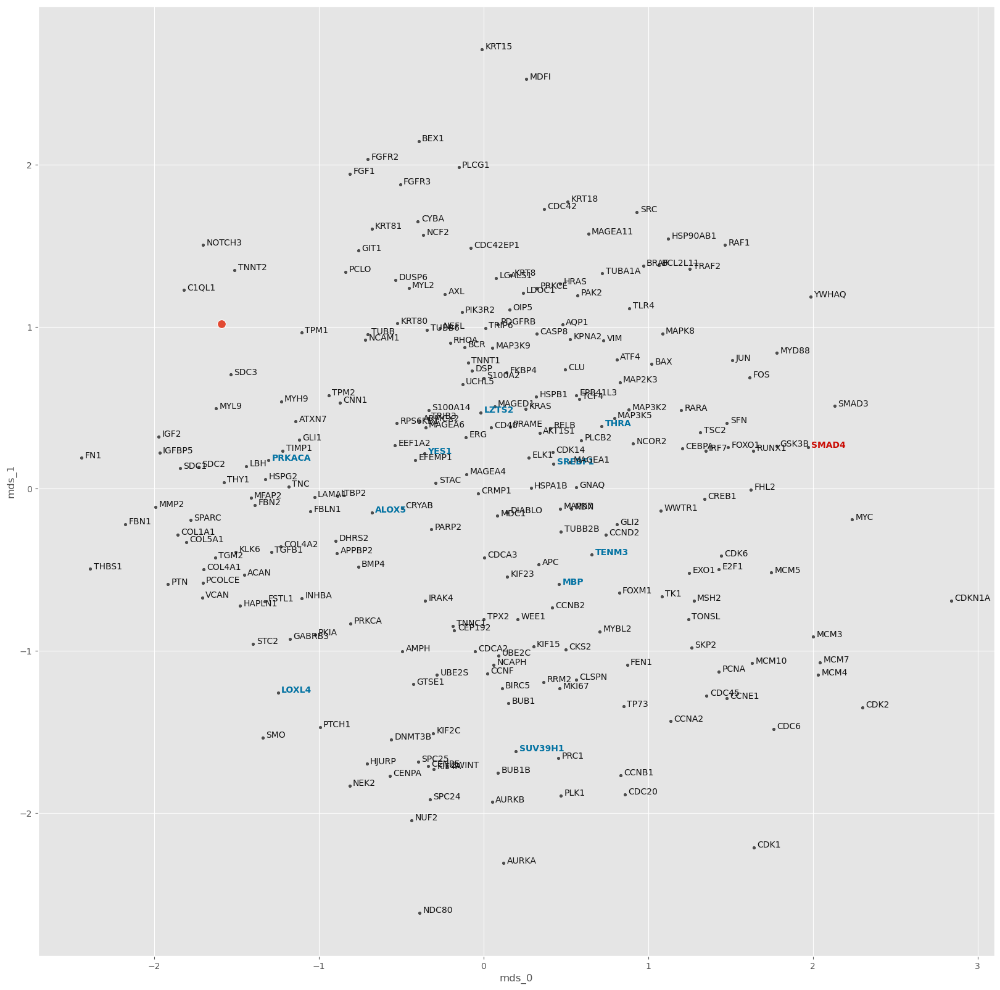

SMO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.015513972290569828
train top-k accuracies: {1: 0.952381, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.952381, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.06187235191464424
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


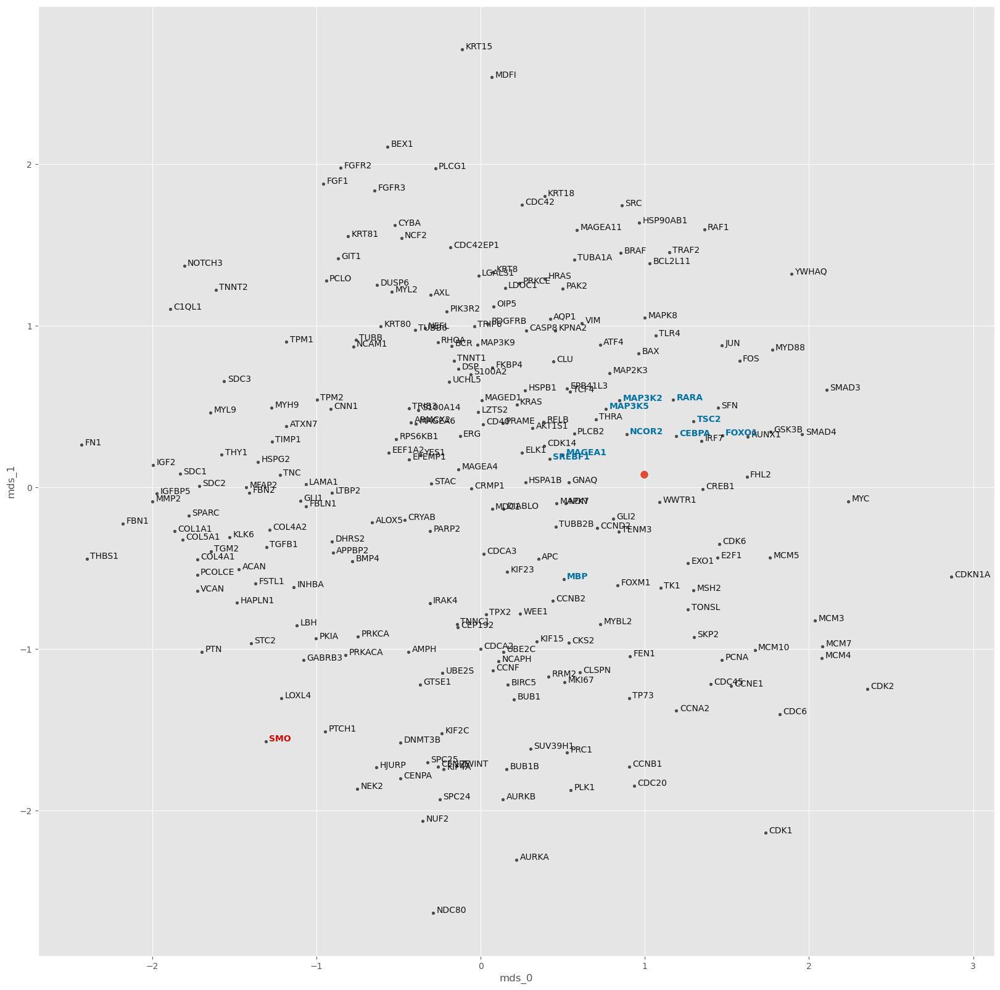

SRC
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.015929608916242916
train top-k accuracies: {1: 0.952381, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.952381, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.045849598944187164
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


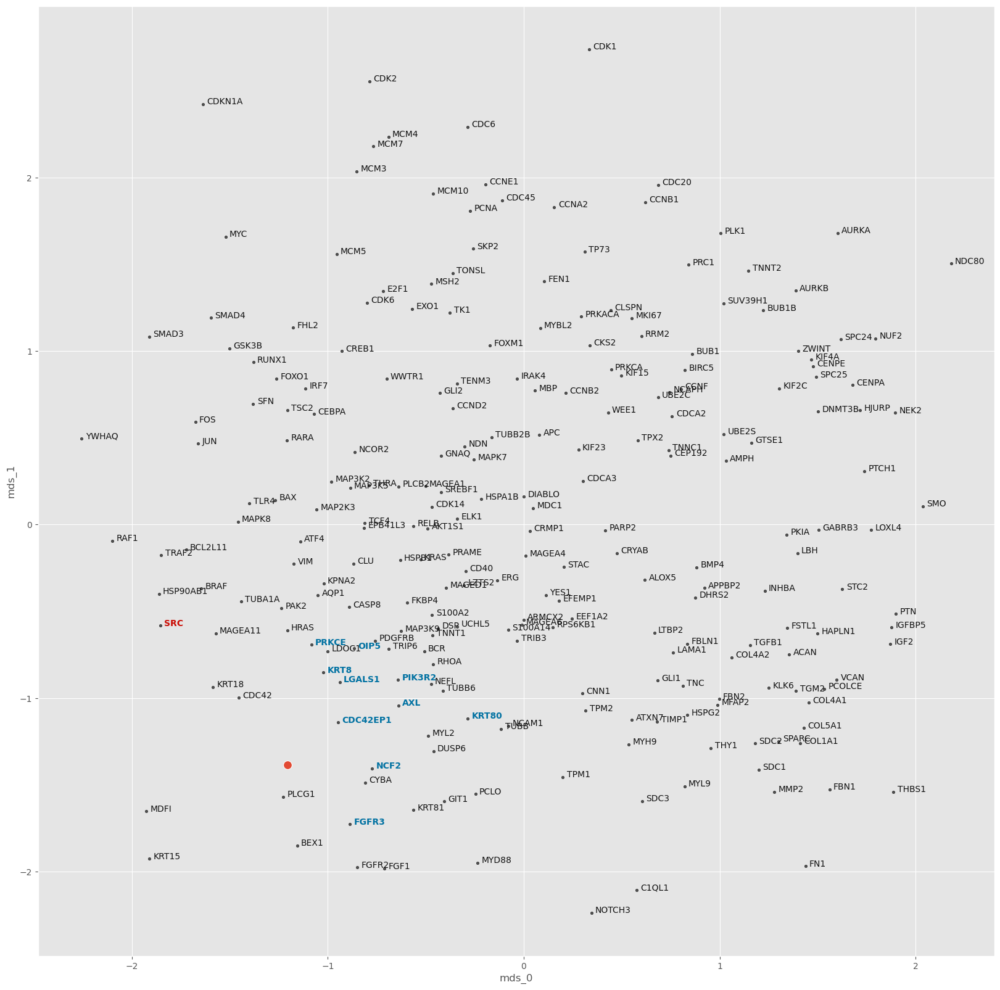

SREBF1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.015132232214368525
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.026179388165473938
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


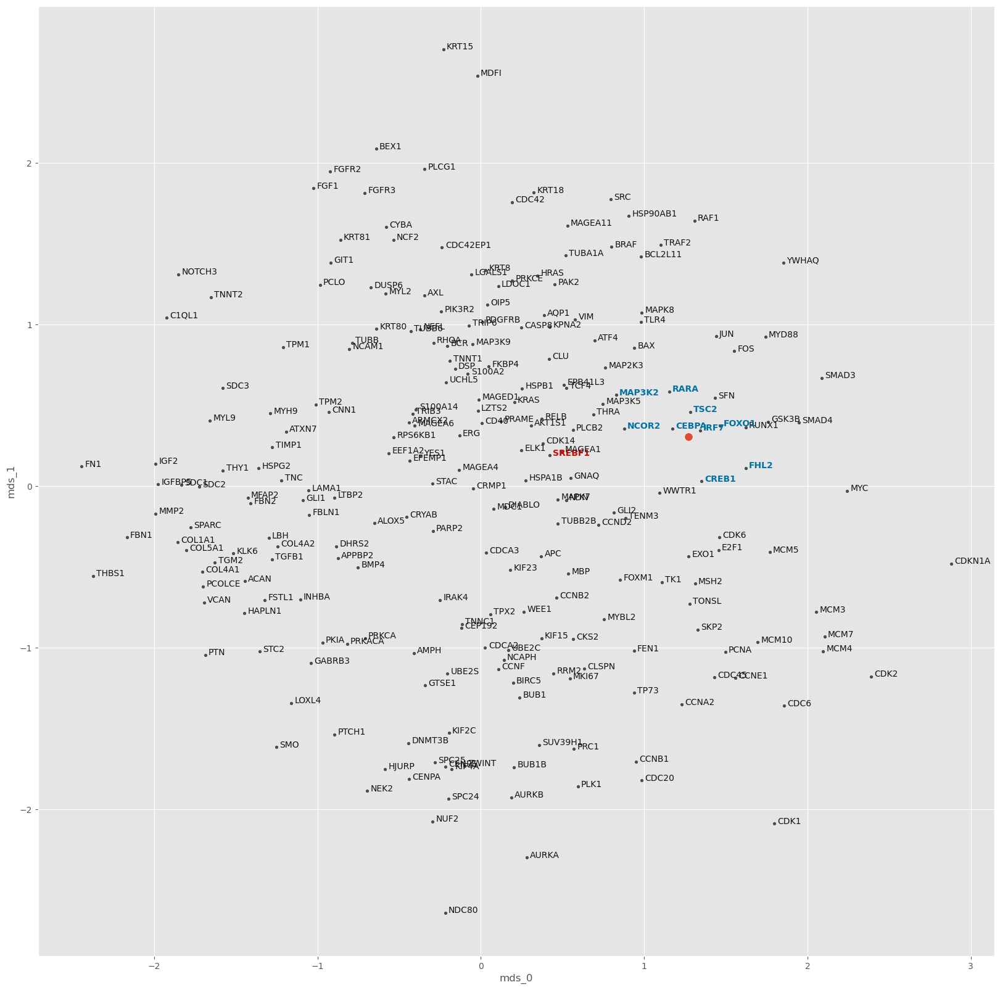

TRAF2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.01534207524465663
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.04454875737428665
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


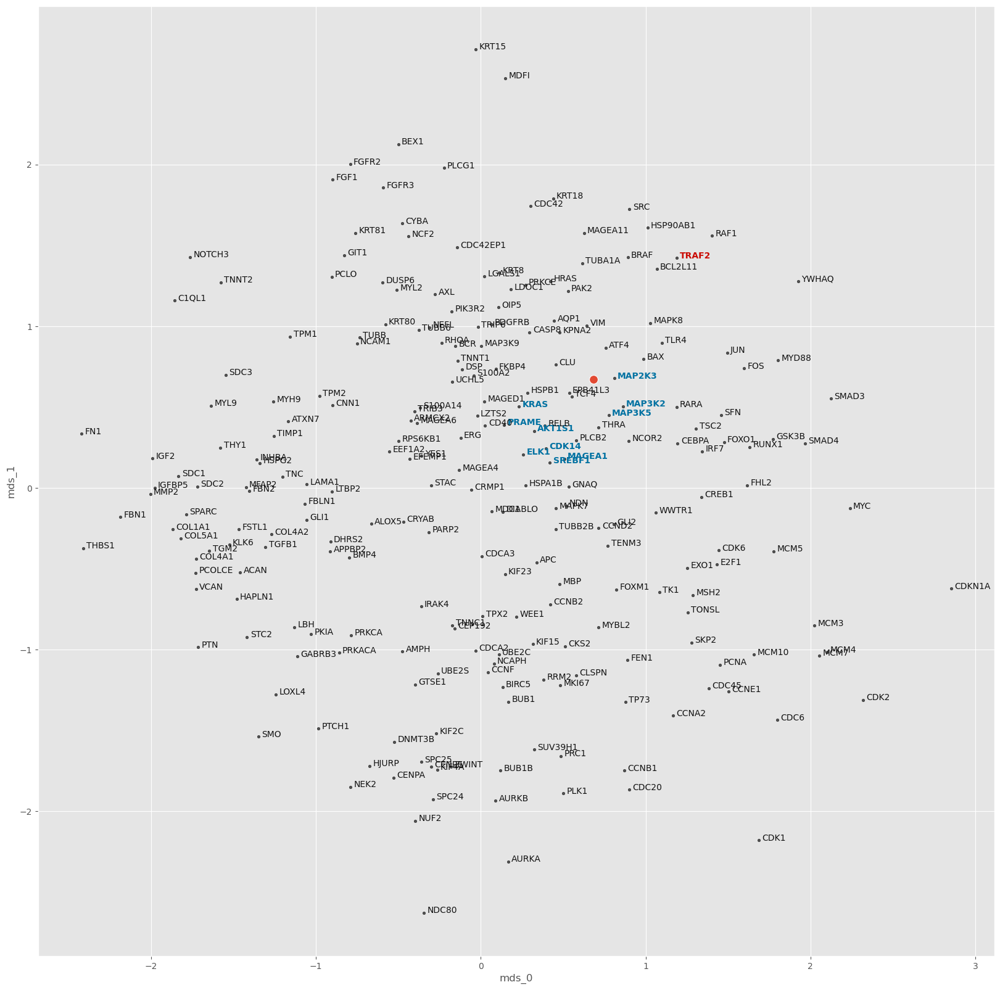

TSC2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.01547937671698275
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.03359989821910858
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


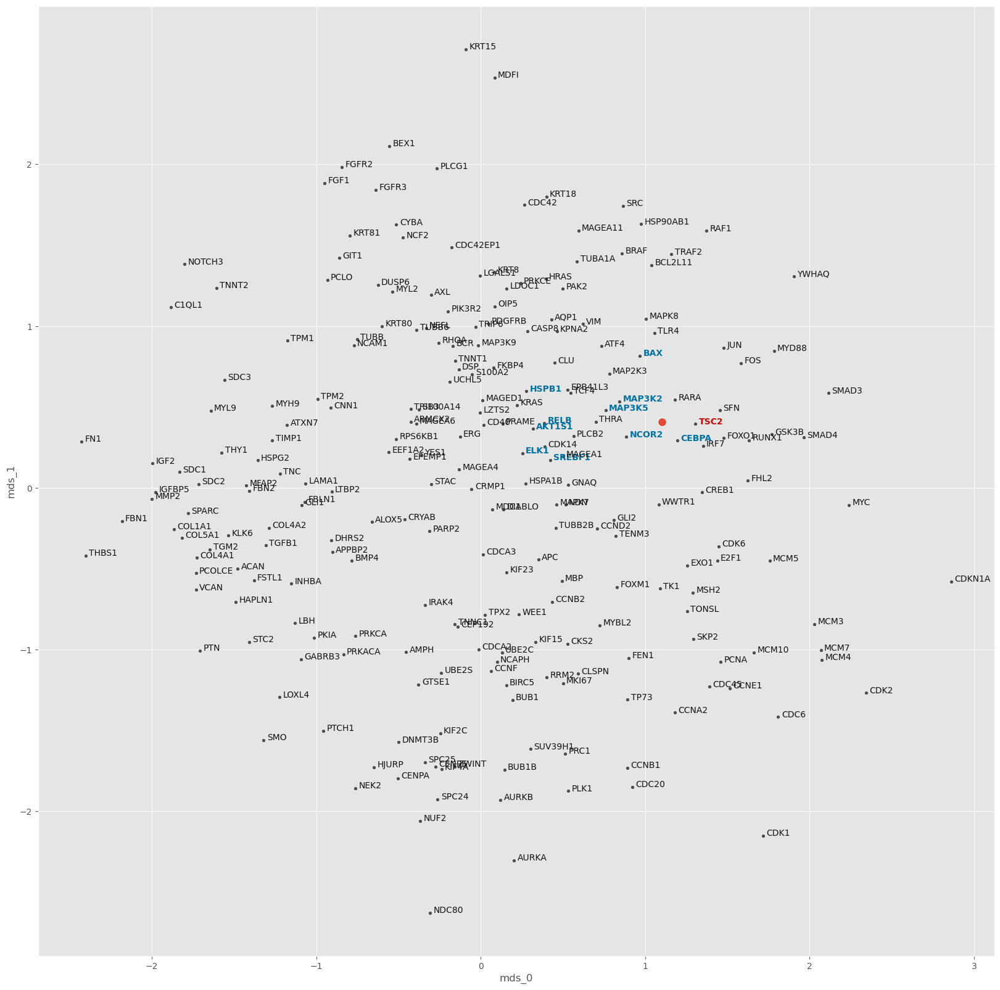

WWTR1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.016186595007422425
train top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.97619, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.08511747419834137
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


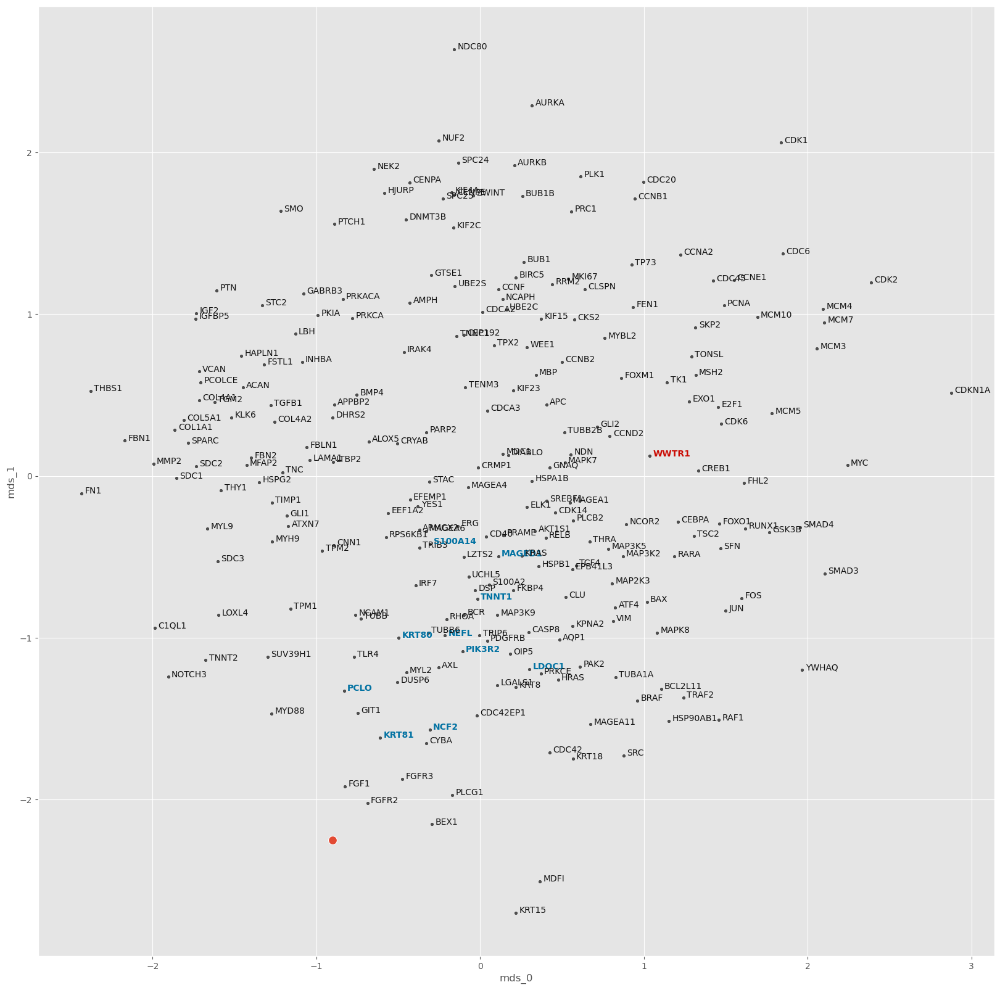

<IPython.core.display.Javascript object>

In [65]:
target_topk_accs = {}
mean_lin_nns = {}
for i in tqdm(range(len(data_dicts))):
    data_dict = data_dicts[i]
    model = torch.nn.Sequential(
        torch.nn.Linear(1024, 1024),
    )
    optimizer = Adam(model.parameters(), lr=1e-3)
    criterion = torch.nn.L1Loss()
    target = sorted(list(shared_targets))[i]
    print(target)
    fitted_model, topk_acc, _, mean_knns = train_model_topk_acc(
        model=model,
        data_dict=data_dict,
        optimizer=optimizer,
        criterion=criterion,
        n_epochs=1000,
        early_stopping=1000,
        nn_clf=nn_clf,
        log_epochs=False,
        use_val_data=False,
    )
    target_topk_accs[target] = topk_acc
    mean_lin_nns[target] = mean_knns[0]
    fig, ax, _ = plot_translation(
        fitted_model.to("cpu"),
        data_dict["test"].dataset,
        node_embs,
        figsize=[20, 20],
        crop=False,
        highlight_target=target,
        pred_size=100,
        reg_size=10,
        highlight_nns=mean_lin_nns[target][:10],
    )
    ax.get_legend().remove()
    plt.show()
    plt.close()

In [33]:
mean_lin_nns["CEBPA"]

array(['ERG', 'SREBF1', 'RELB', 'NCOR2', 'MAPK7', 'THRA', 'MAP3K5',
       'EEF1A2', 'HSPA1B', 'AKT1S1', 'CD40', 'MAP3K2', 'DIABLO', 'LZTS2',
       'ELK1', 'CASP8', 'KRAS', 'YES1', 'CDCA3', 'WWTR1', 'MAP2K3',
       'PRAME', 'JUN', 'AQP1', 'CEBPA', 'APC', 'EFEMP1', 'RPS6KB1',
       'EPB41L3', 'TCF4', 'MAGEA1', 'TSC2', 'TRIP6', 'MBP', 'TRIB3',
       'IRF7', 'ATF4', 'FOS', 'BCR', 'CLU', 'CDK14', 'RUNX1', 'STAC',
       'ALOX5', 'PLCB2', 'RARA', 'RHOA', 'KIF23', 'PDGFRB', 'GLI2',
       'TENM3', 'TNNC1', 'MAGED1', 'NDN', 'BAX', 'PARP2', 'KPNA2', 'MDC1',
       'GNAQ', 'FOXO1', 'CREB1', 'MAGEA6', 'IRAK4', 'WEE1', 'UBE2C',
       'CEP192', 'CDCA2', 'HSPB1', 'S100A2', 'TUBB2B', 'S100A14',
       'MAP3K9', 'MAPK8', 'TLR4', 'TPX2', 'CCND2', 'NCAPH', 'DHRS2',
       'AXL', 'CCNB2', 'OIP5', 'HRAS', 'FOXM1', 'UCHL5', 'DSP', 'SUV39H1',
       'GLI1', 'GSK3B', 'CRYAB', 'LGALS1', 'MAGEA4', 'LTBP2', 'FKBP4',
       'PRKCA', 'FHL2', 'TNNT1', 'ARMCX2', 'APPBP2', 'PIK3R2', 'FBLN1',
       'PRKACA', '

<IPython.core.display.Javascript object>

In [29]:
mean_lin_topk_df = pd.DataFrame(target_topk_accs).transpose()
mean_lin_topk_df.loc[mean_lin_topk_df.loc[:, 50] > 0].sort_values(
    [1, 3, 5, 10, 20, 50], ascending=False
)

,1,3,5,10,20,50
KRAS,0.0,1.0,1.0,1.0,1.0,1.0
FOXO1,0.0,0.0,1.0,1.0,1.0,1.0
MAPK7,0.0,0.0,1.0,1.0,1.0,1.0
TSC2,0.0,0.0,1.0,1.0,1.0,1.0
CREB1,0.0,0.0,0.0,1.0,1.0,1.0
MAP3K5,0.0,0.0,0.0,1.0,1.0,1.0
SREBF1,0.0,0.0,0.0,1.0,1.0,1.0
AKT1S1,0.0,0.0,0.0,0.0,1.0,1.0
DIABLO,0.0,0.0,0.0,0.0,1.0,1.0
HRAS,0.0,0.0,0.0,0.0,1.0,1.0


<IPython.core.display.Javascript object>

In [30]:
mean_lin_topk_df.describe()

,1,3,5,10,20,50
count,43.0,43.000000,43.000000,43.000000,43.000000,43.000000
mean,0.0,0.023256,0.093023,0.162791,0.302326,0.488372
std,0.0,0.152499,0.293903,0.373544,0.464701,0.505781
min,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.0,0.000000,0.000000,0.000000,1.000000,1.000000
max,0.0,1.000000,1.000000,1.000000,1.000000,1.000000


<IPython.core.display.Javascript object>

In [31]:
iou_kegg_1nn_mean_lin = get_geneset_io(mean_lin_nns, inv_kegg_gs_dict, k=1)
iou_pid_1nn_mean_lin = get_geneset_io(mean_lin_nns, inv_pid_gs_dict, k=1)
iou_wiki_1nn_mean_lin = get_geneset_io(mean_lin_nns, inv_wiki_gs_dict, k=1)
iou_bc_1nn_mean_lin = get_geneset_io(mean_lin_nns, inv_bc_gs_dict, k=1)
iou_h_1nn_mean_lin = get_geneset_io(mean_lin_nns, inv_h_gs_dict, k=1)

<IPython.core.display.Javascript object>

In [32]:
iou_wiki_1nn_mean_lin

{'AKT1S1': 0.0,
 'APC': 0.11764705882352941,
 'ATF4': 0.16129032258064516,
 'BAX': 0.15384615384615385,
 'BCL2L11': 0.1111111111111111,
 'BRAF': 0.3870967741935484,
 'CASP8': 0.10869565217391304,
 'CDC42': 0.07692307692307693,
 'CDKN1A': 0.0,
 'CEBPA': 0.0,
 'CREB1': 0.1625,
 'DIABLO': 0.0,
 'E2F1': 0.04081632653061224,
 'ELK1': 0.0,
 'ERG': 0.0,
 'FGFR3': 0.16666666666666666,
 'FOXO1': 0.1509433962264151,
 'GLI1': 0.0,
 'HRAS': 0.025,
 'IRAK4': 0.0,
 'JUN': 0.0449438202247191,
 'KRAS': 0.5384615384615384,
 'MAP2K3': 0.02,
 'MAP3K2': 0.05555555555555555,
 'MAP3K5': 0.07936507936507936,
 'MAP3K9': 0.0,
 'MAPK7': 0.13793103448275862,
 'MYD88': 0.014492753623188406,
 'PIK3R2': 0.075,
 'PKIA': 0.0,
 'PRKACA': 0.09375,
 'PRKCE': 0.08928571428571429,
 'RAF1': 0.23232323232323232,
 'RELB': 0.12,
 'RHOA': 0.02127659574468085,
 'SMAD3': 0.0,
 'SMAD4': 0.0,
 'SMO': 0.0,
 'SRC': 0.0,
 'SREBF1': 0.07142857142857142,
 'TRAF2': 0.06349206349206349,
 'TSC2': 0.15,
 'WWTR1': 0.0}

<IPython.core.display.Javascript object>

---

### 3.2. Nonlinear mean prediction

We do apply the same scheme using a simple 3-layer nonlinear network.

  0%|          | 0/43 [00:00<?, ?it/s]

AKT1S1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.03376429226426851
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.43929582834243774
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


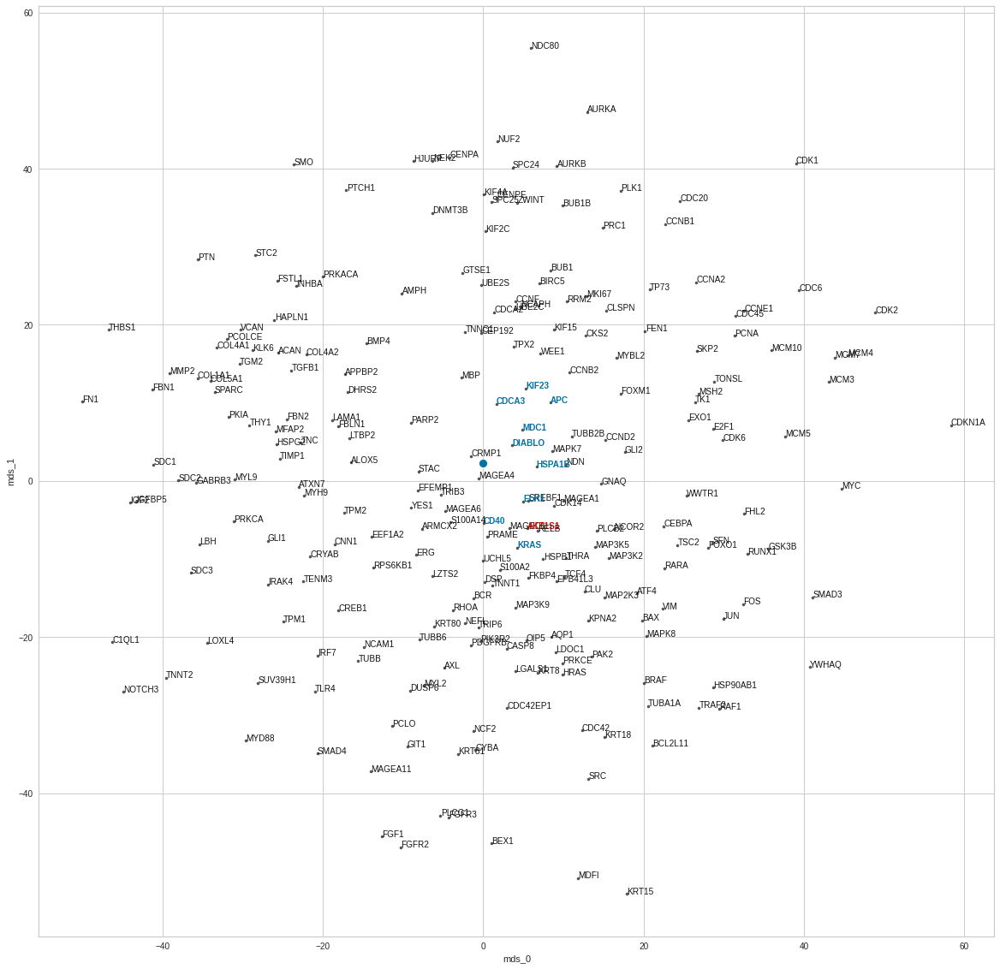

APC
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.040379666324172704
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.4725714325904846
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


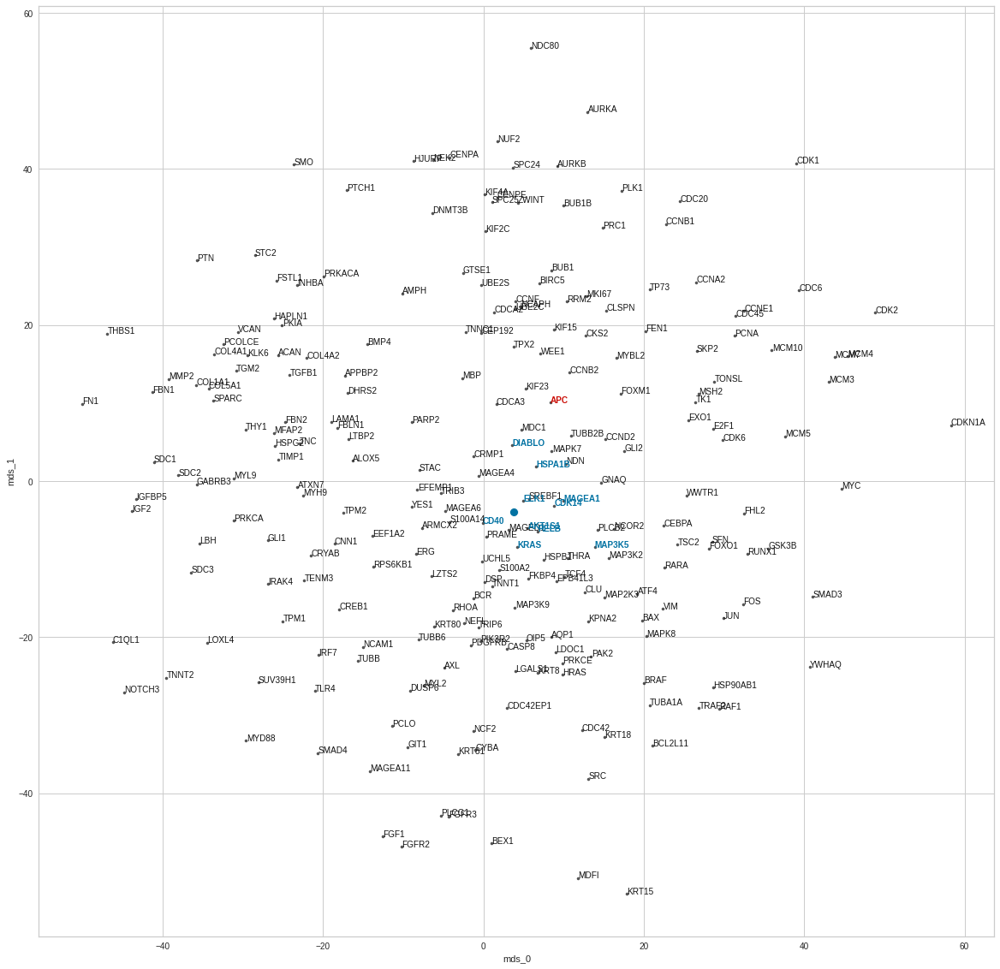

ATF4
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.035173150577715466
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.8815406560897827
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


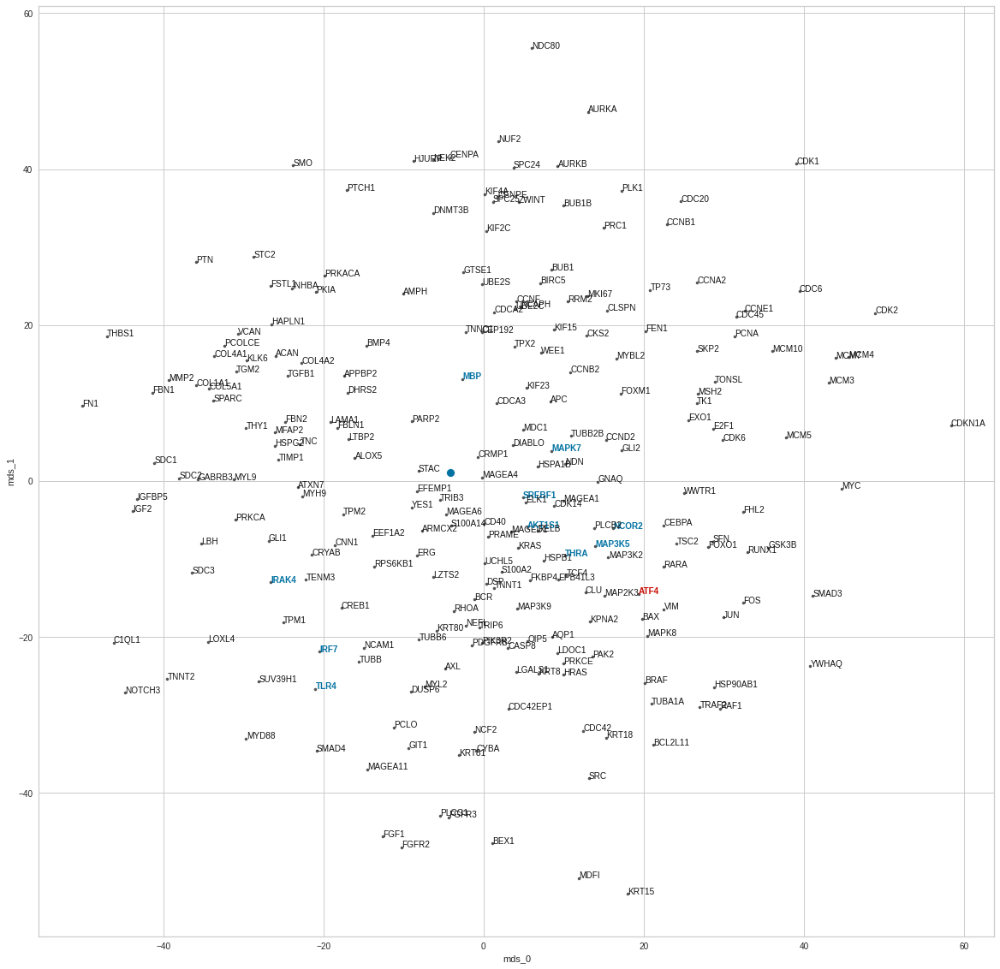

BAX
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.03840312343977746
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.5867807865142822
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


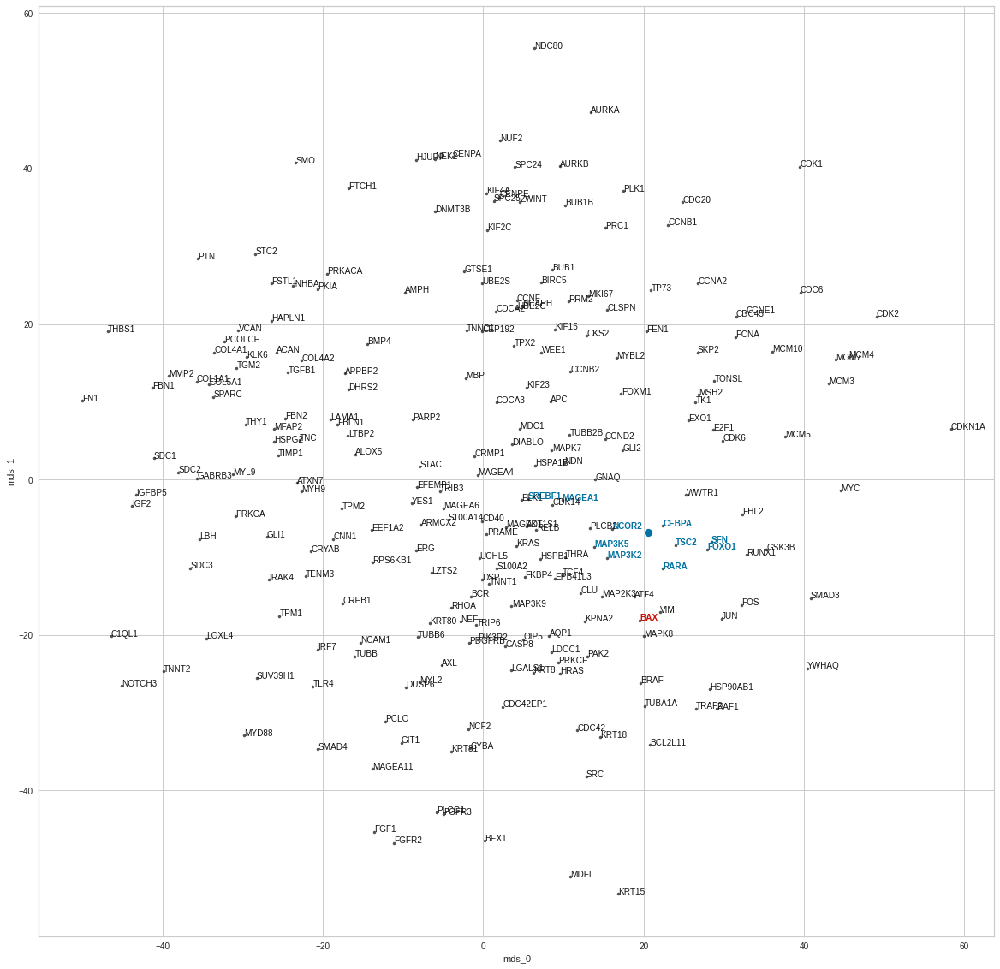

BCL2L11
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0345645034242244
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.8819488286972046
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


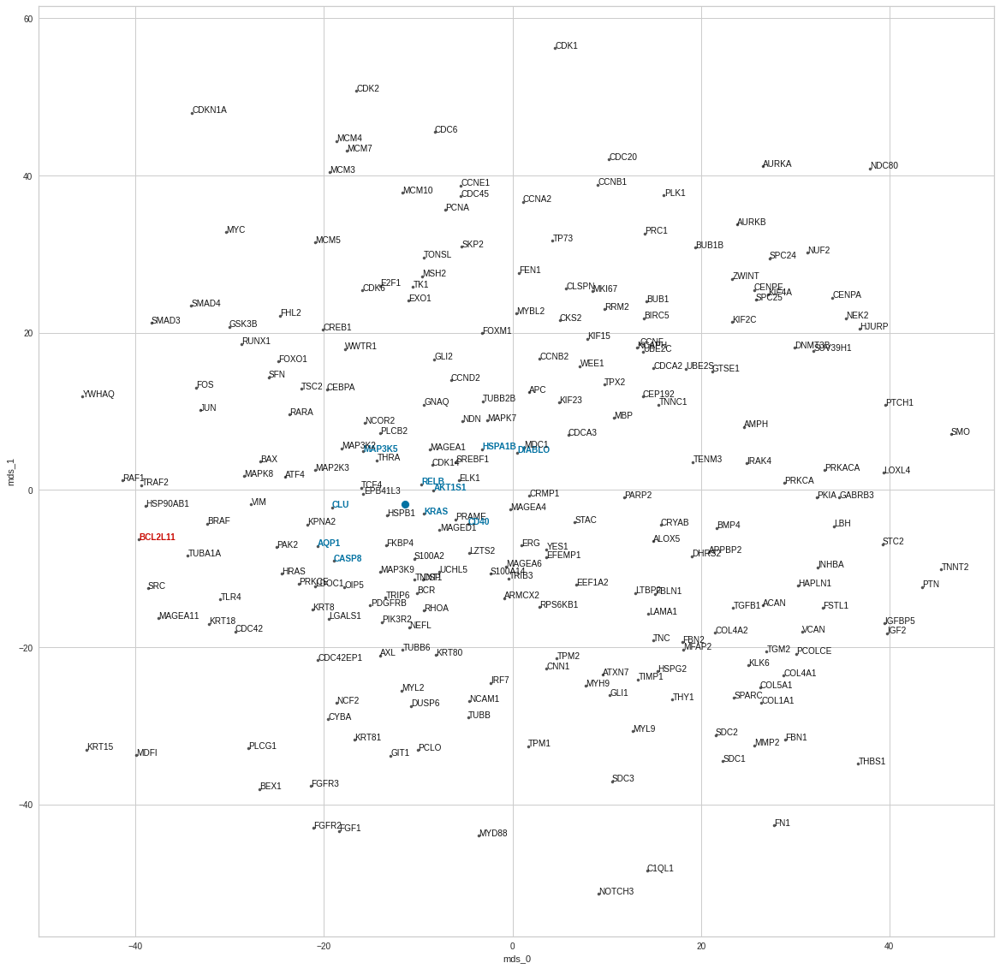

BRAF
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.04229186475276947
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.2471516877412796
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


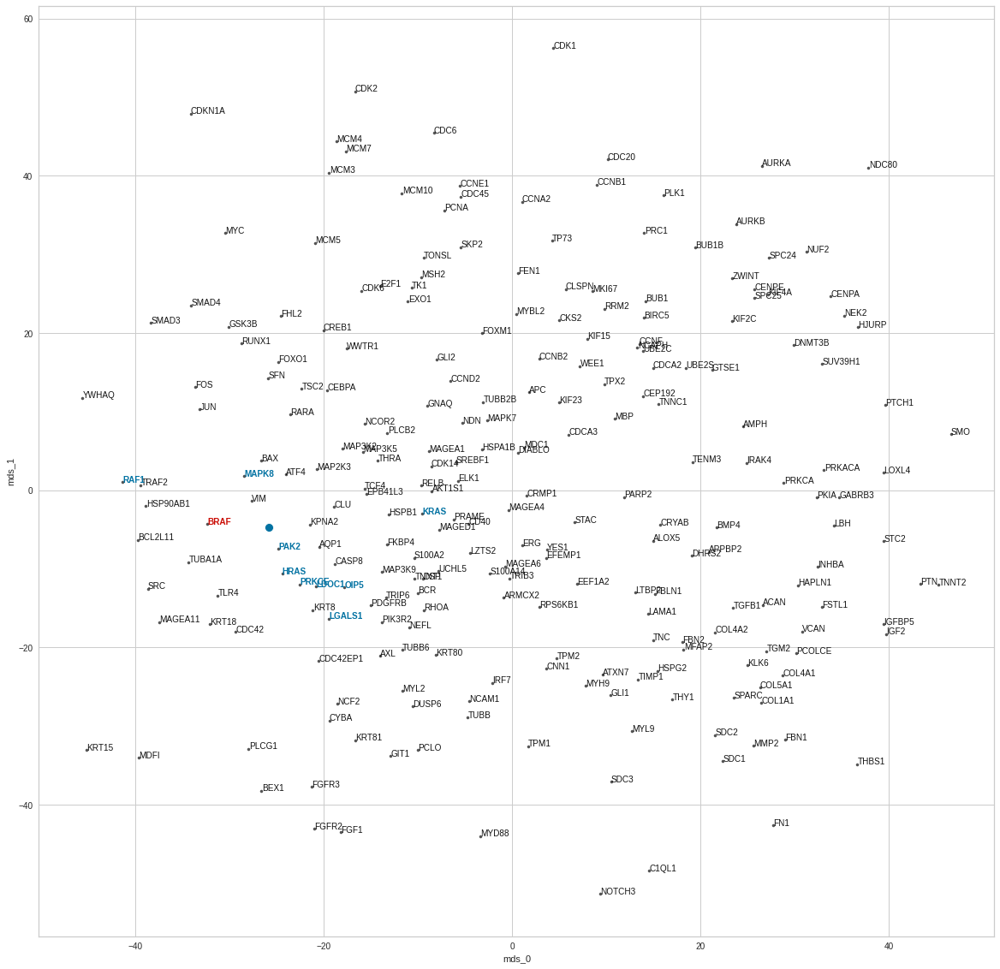

CASP8
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.036739787530331386
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.0019471645355225
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


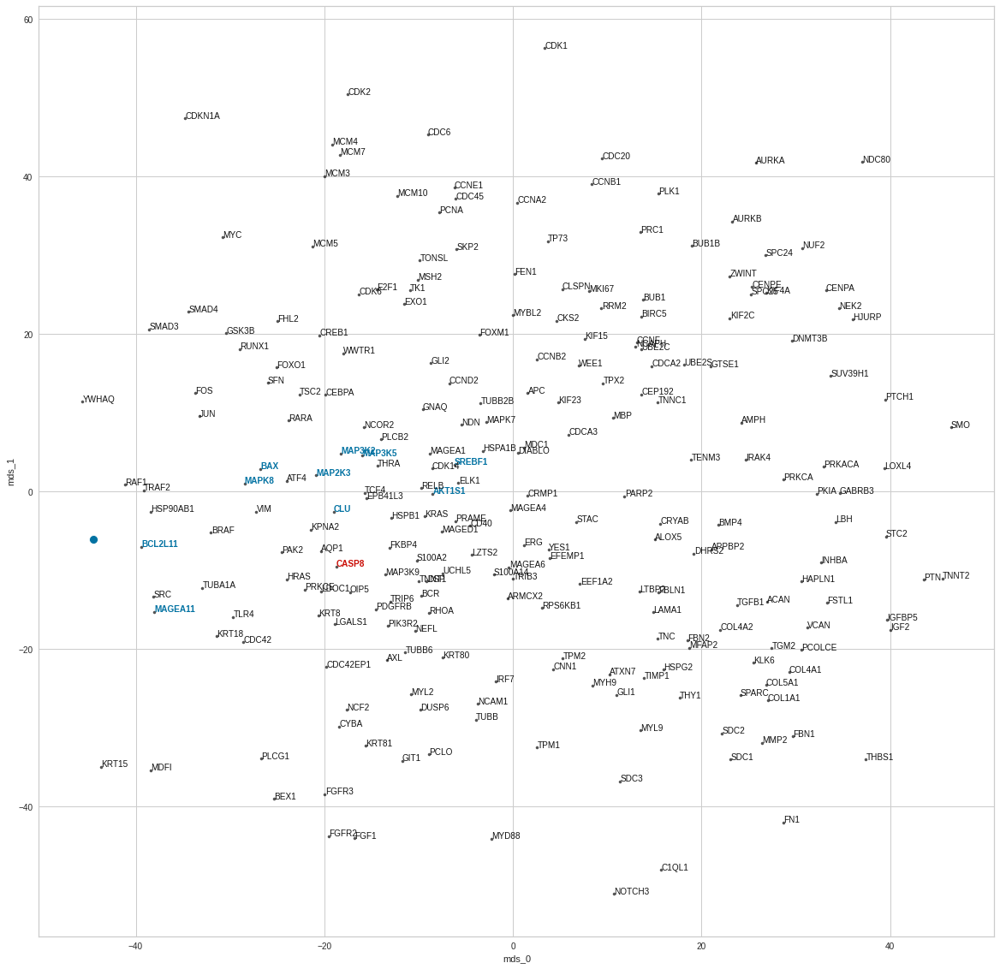

CDC42
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.03815475070760364
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.7260613441467285
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


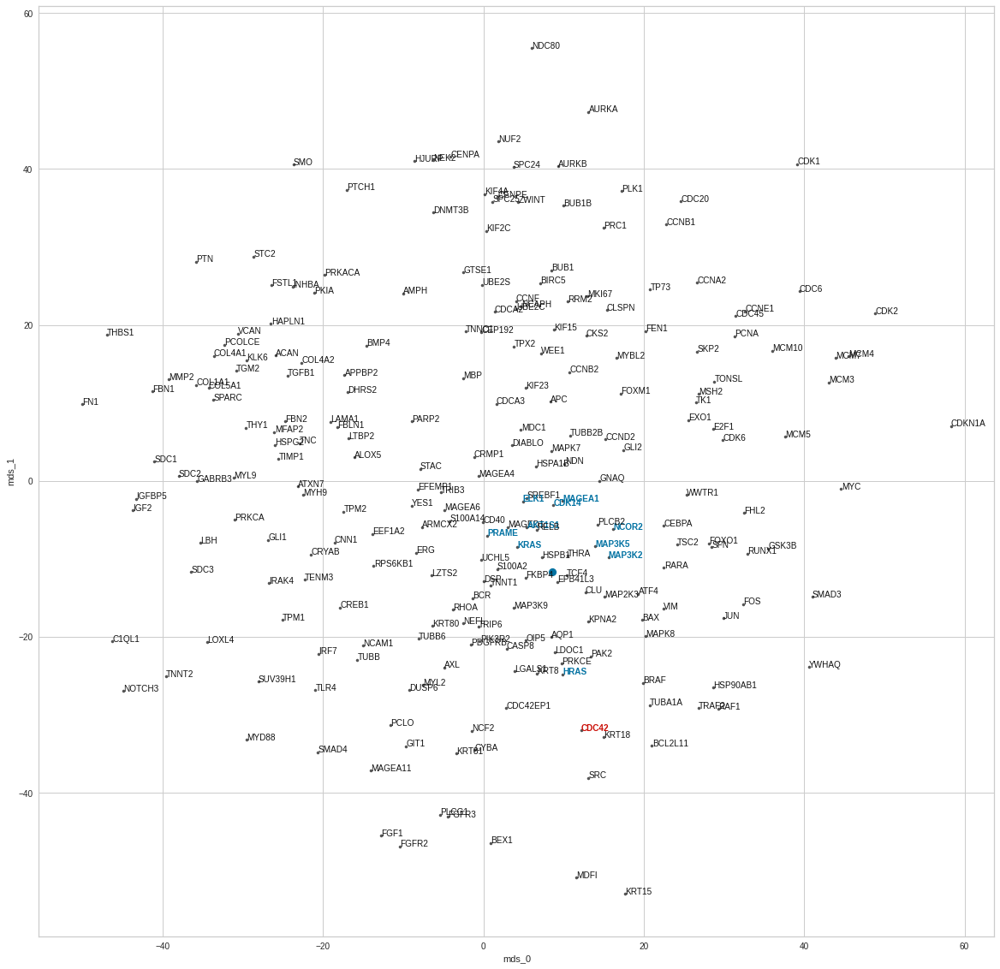

CDKN1A
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0384101475633326
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.6967378854751587
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


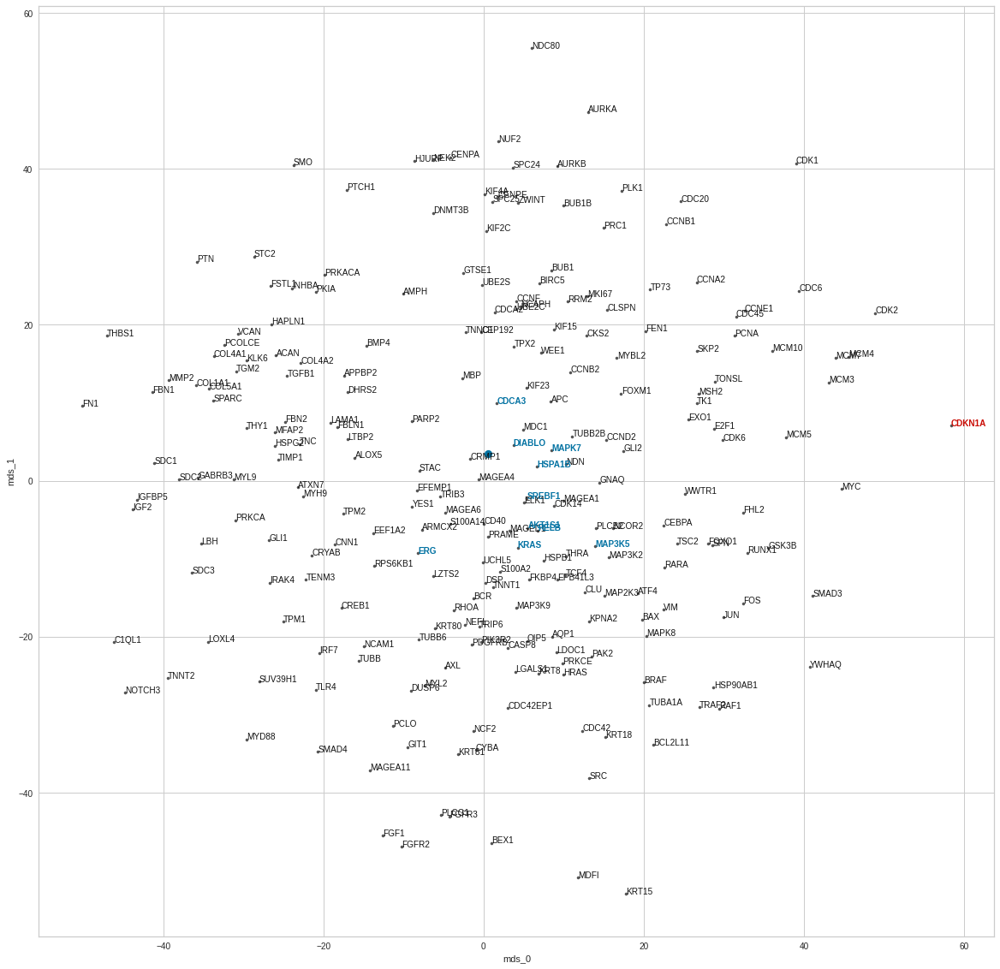

CEBPA
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.04036347053590275
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.6773232221603394
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


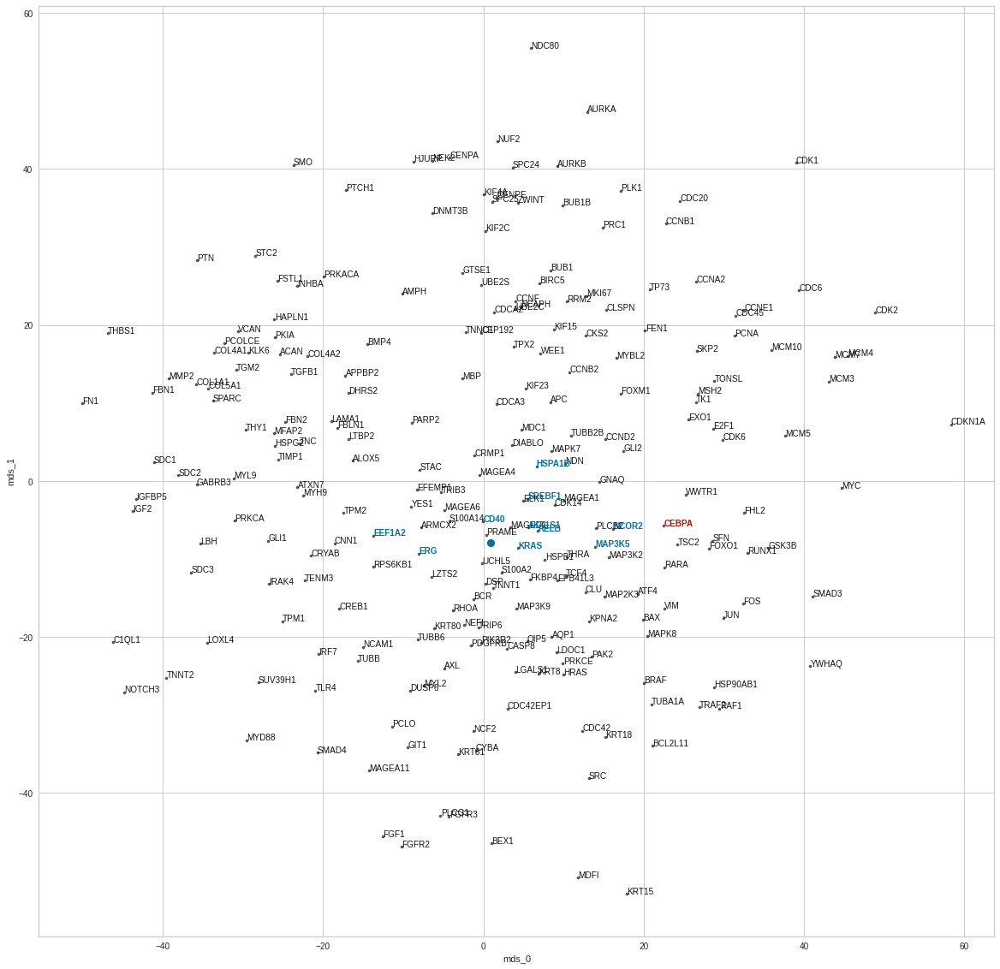

CREB1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.043640307017735074
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.5558624267578125
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


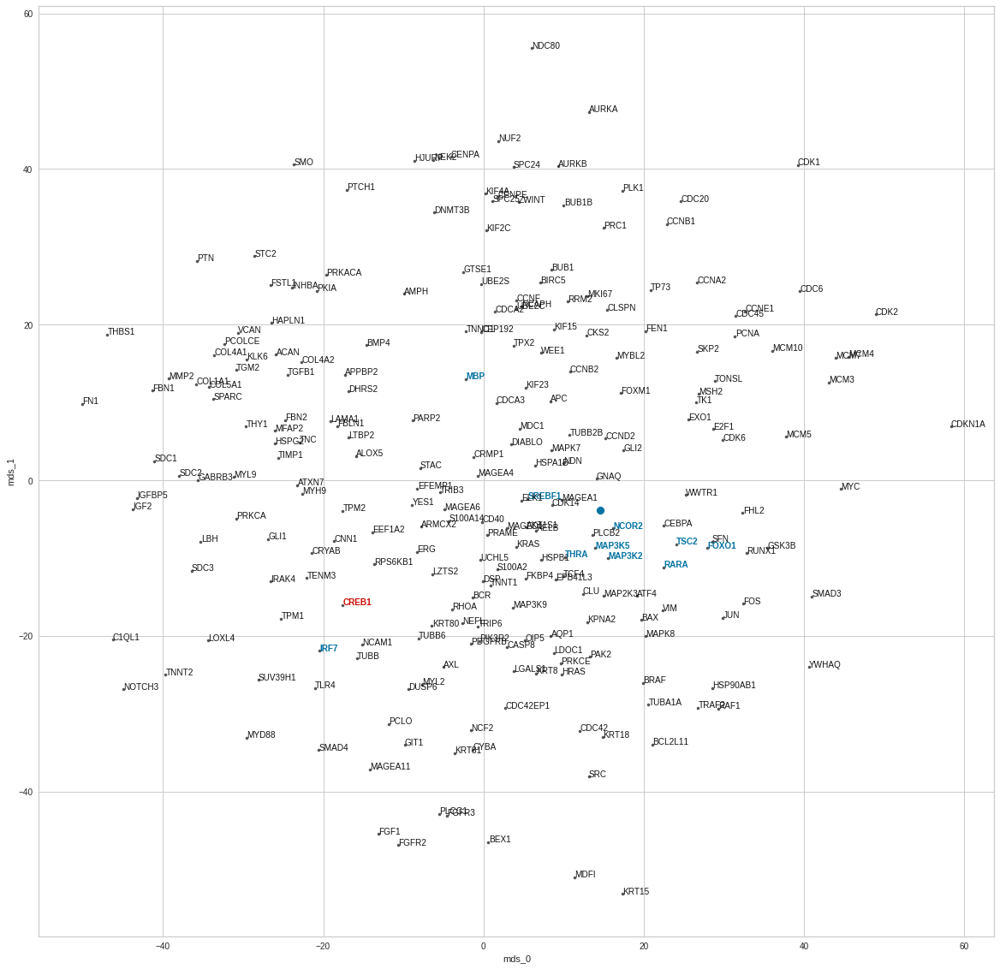

DIABLO
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.041188513061829975
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.7860947847366333
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


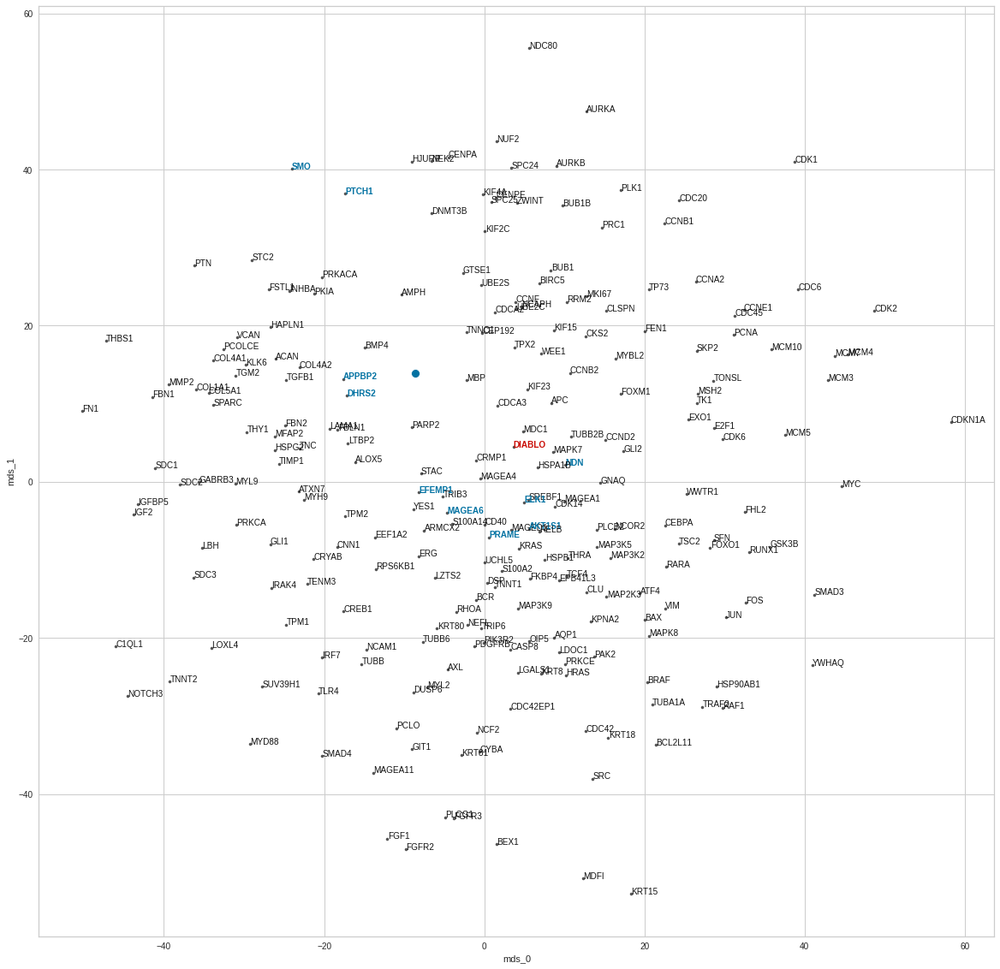

E2F1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.045845025174674536
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.116405725479126
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


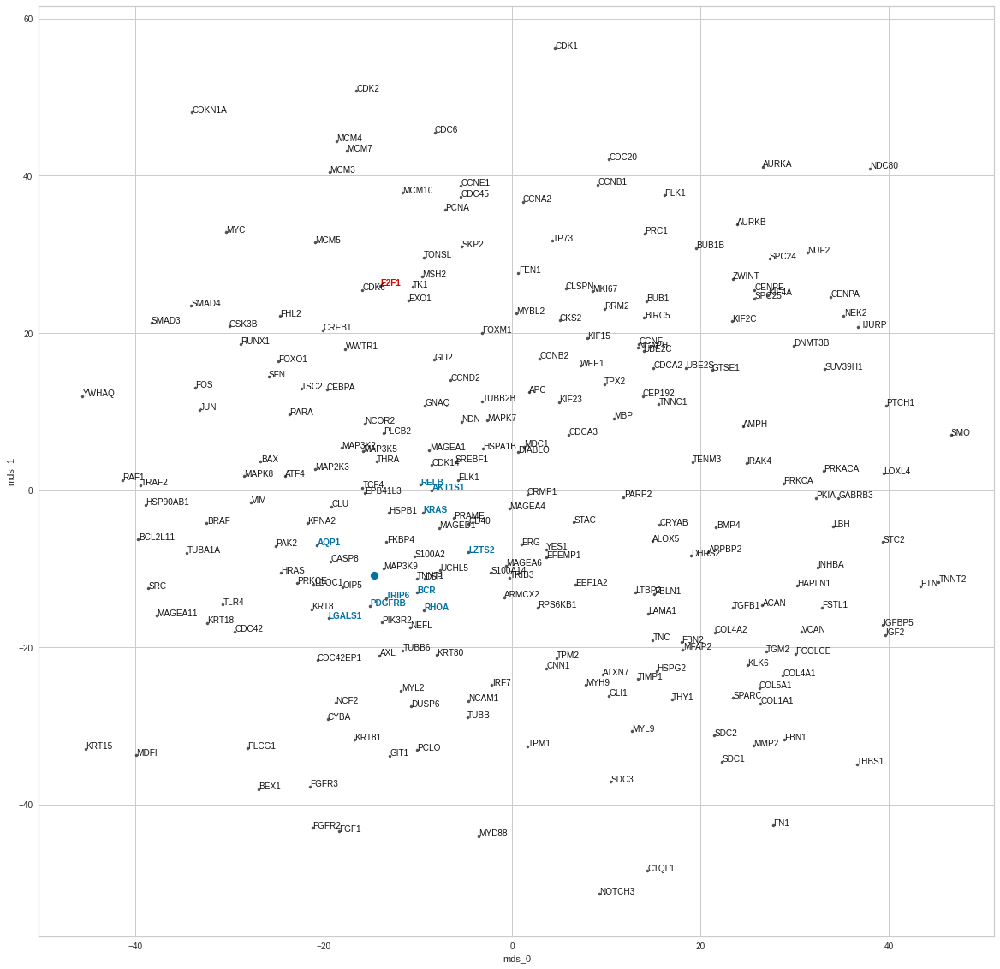

ELK1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.03843916792954717
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.8002995848655701
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


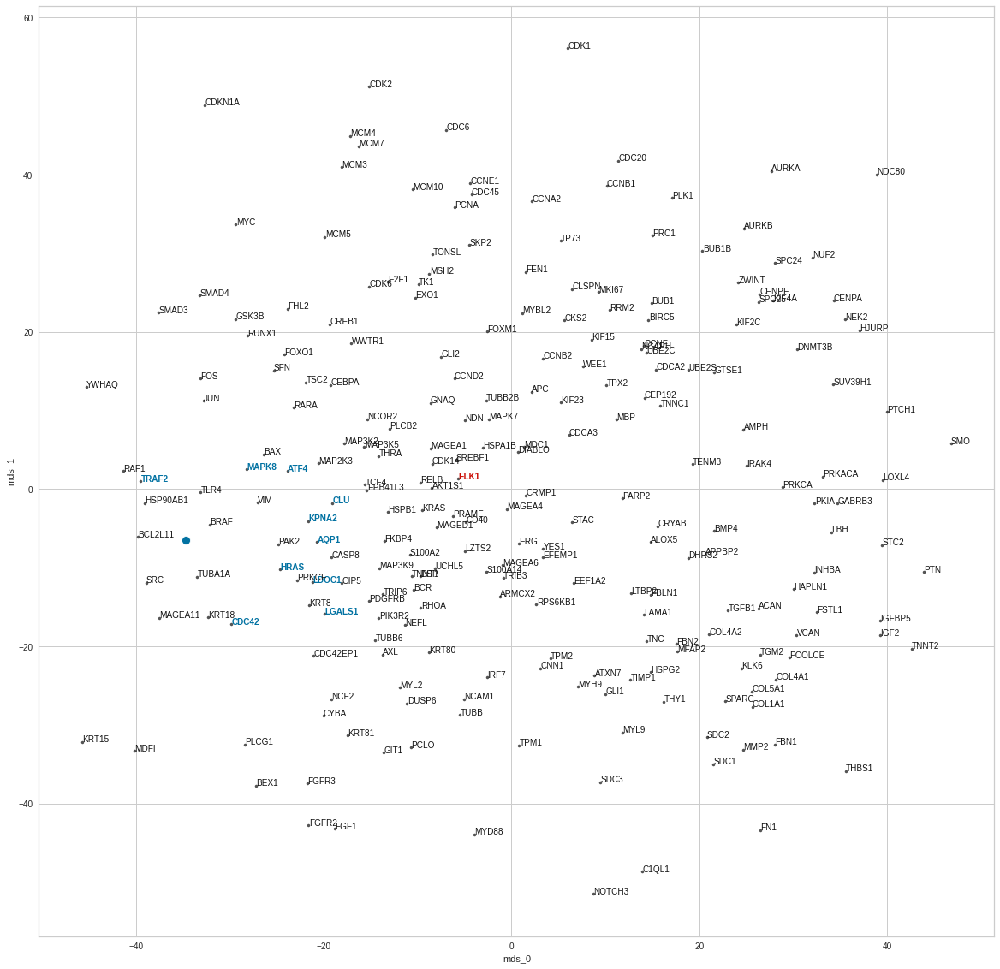

ERG
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.04094192793681508
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.0198124647140503
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


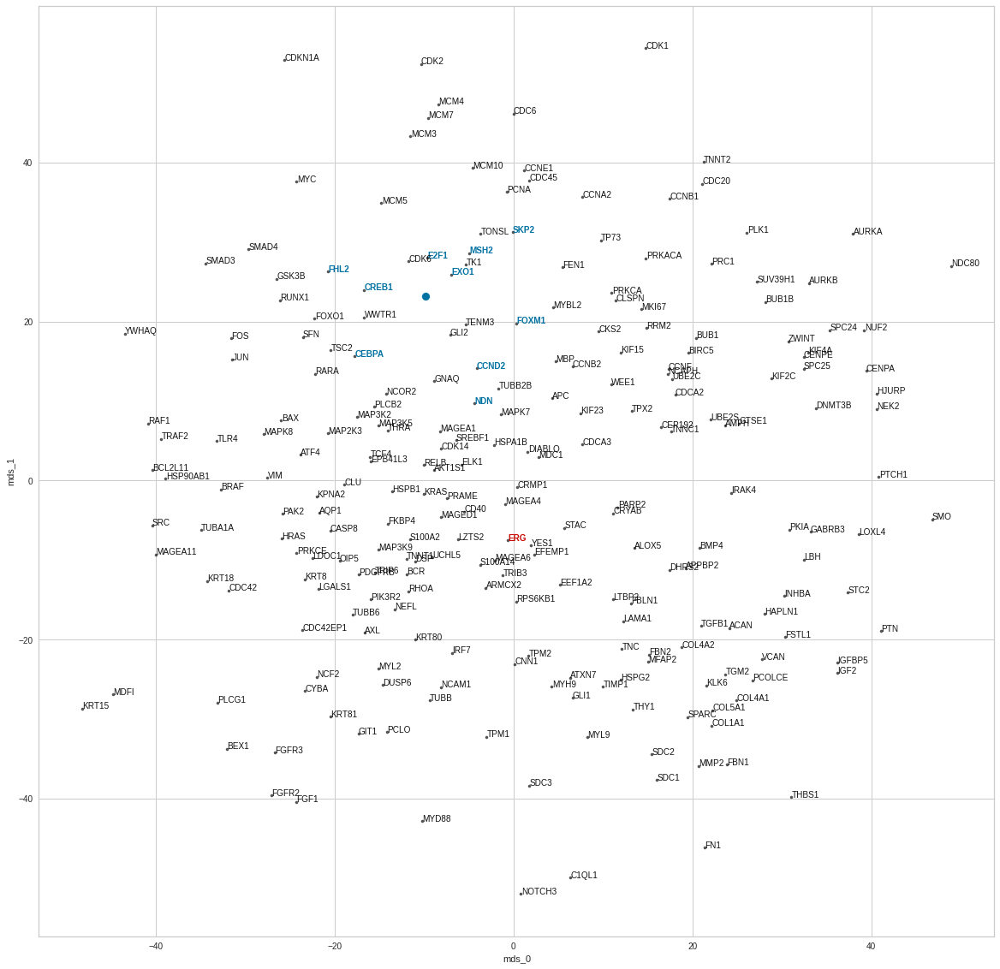

FGFR3
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.04656540974974632
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.037797212600708
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


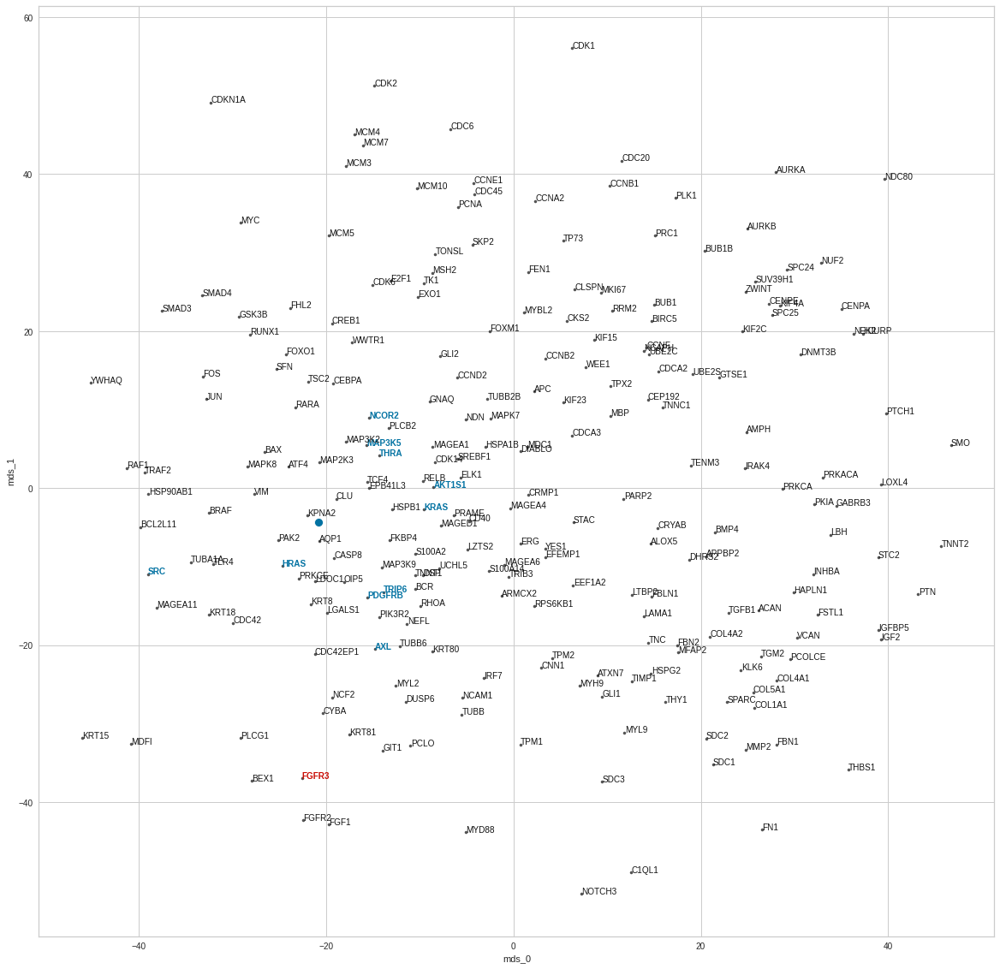

FOXO1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0443793579581238
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.32662877440452576
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


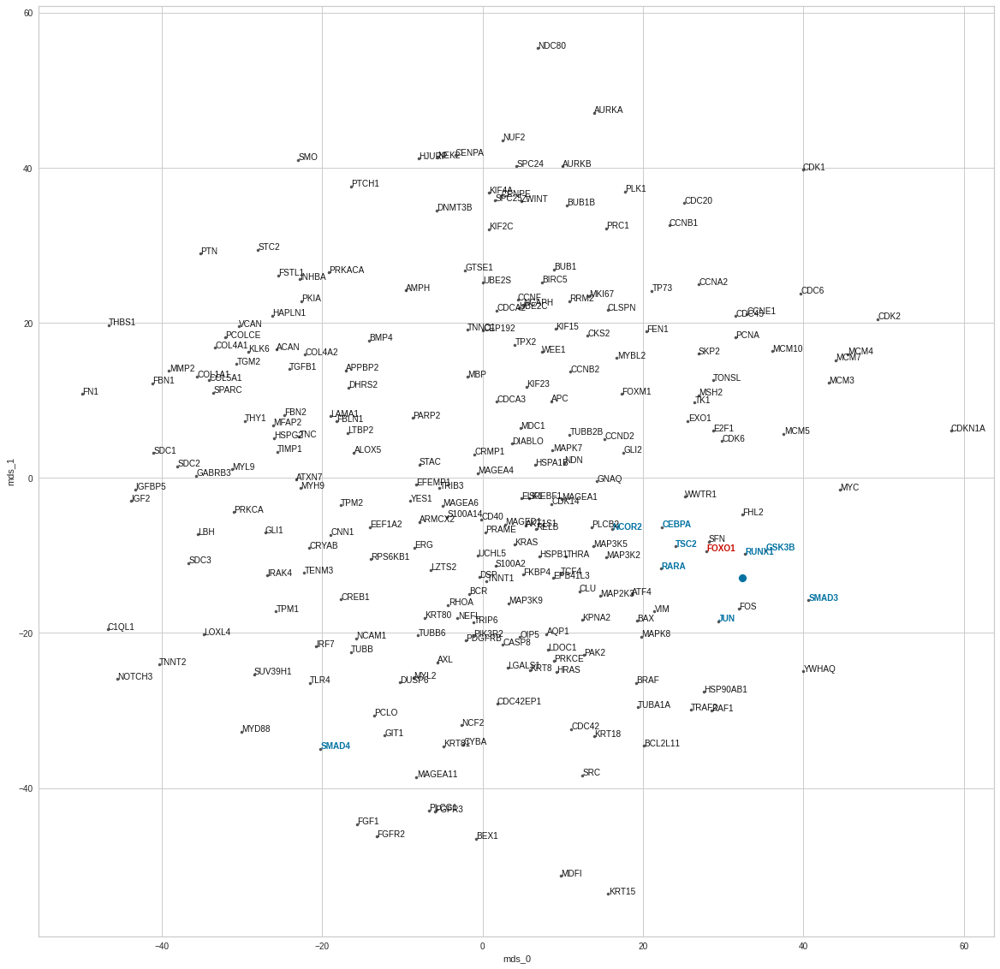

GLI1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.03426604496226424
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.8489304780960083
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


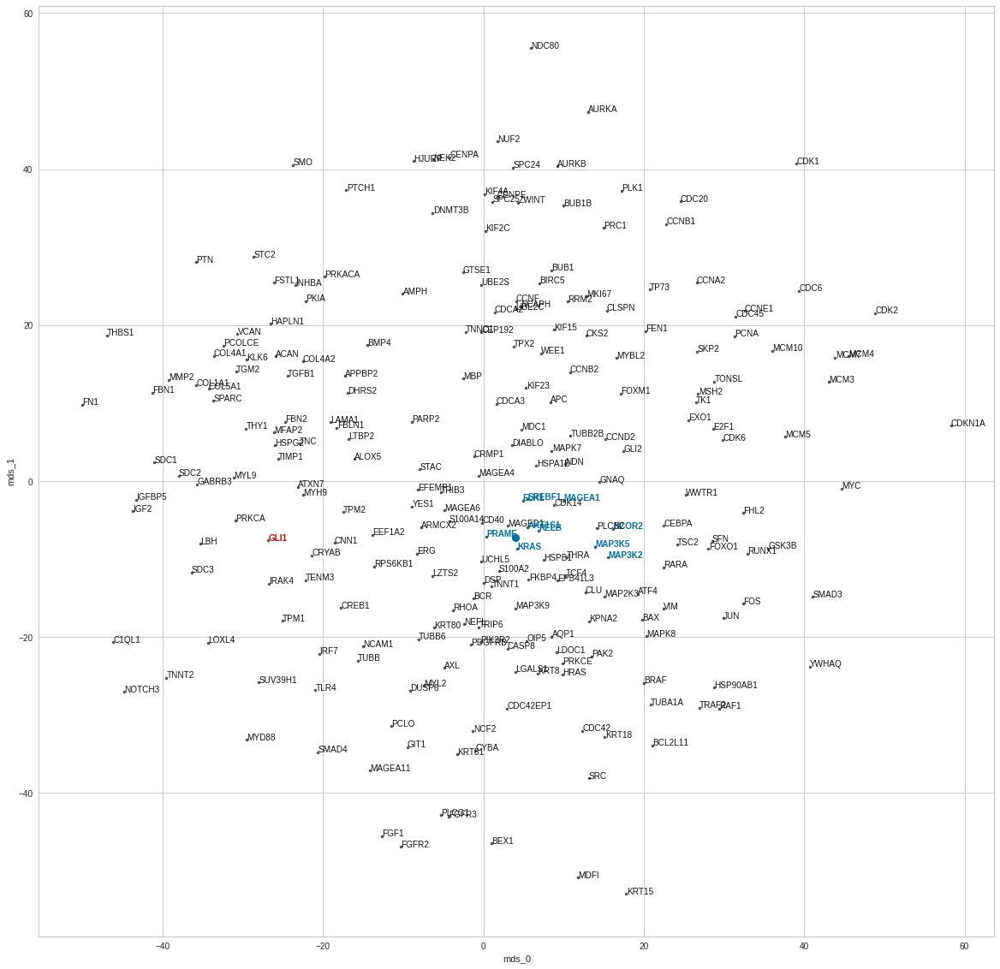

HRAS
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.038162827491760254
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.4007778763771057
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


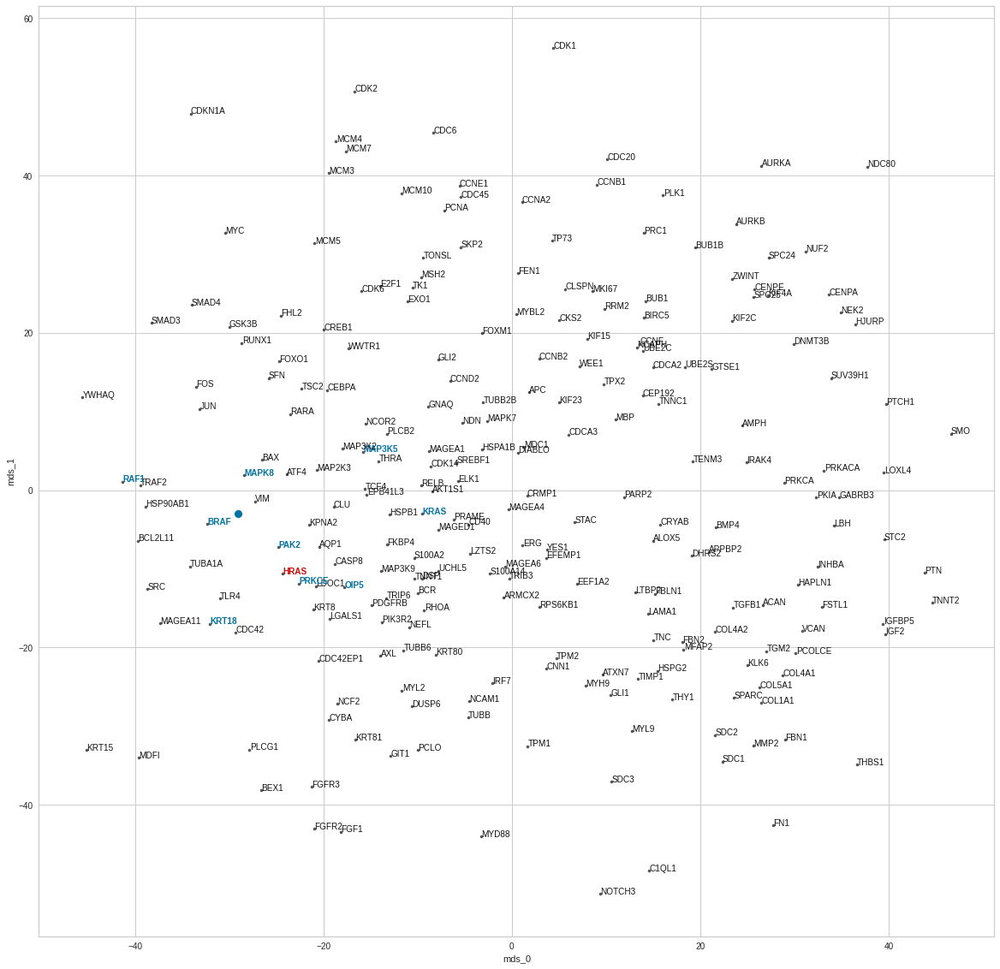

IRAK4
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.044183863060814996
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.0201504230499268
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


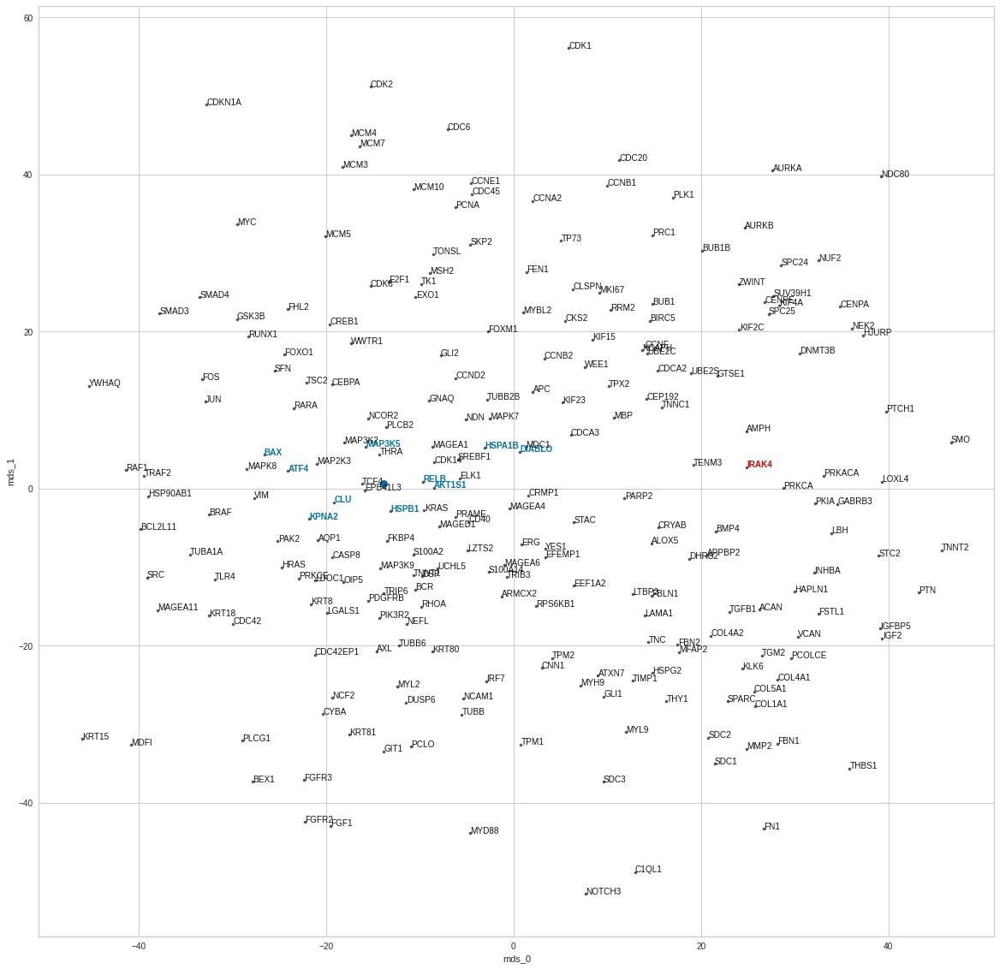

JUN
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.03697660033191953
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.5567161440849304
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


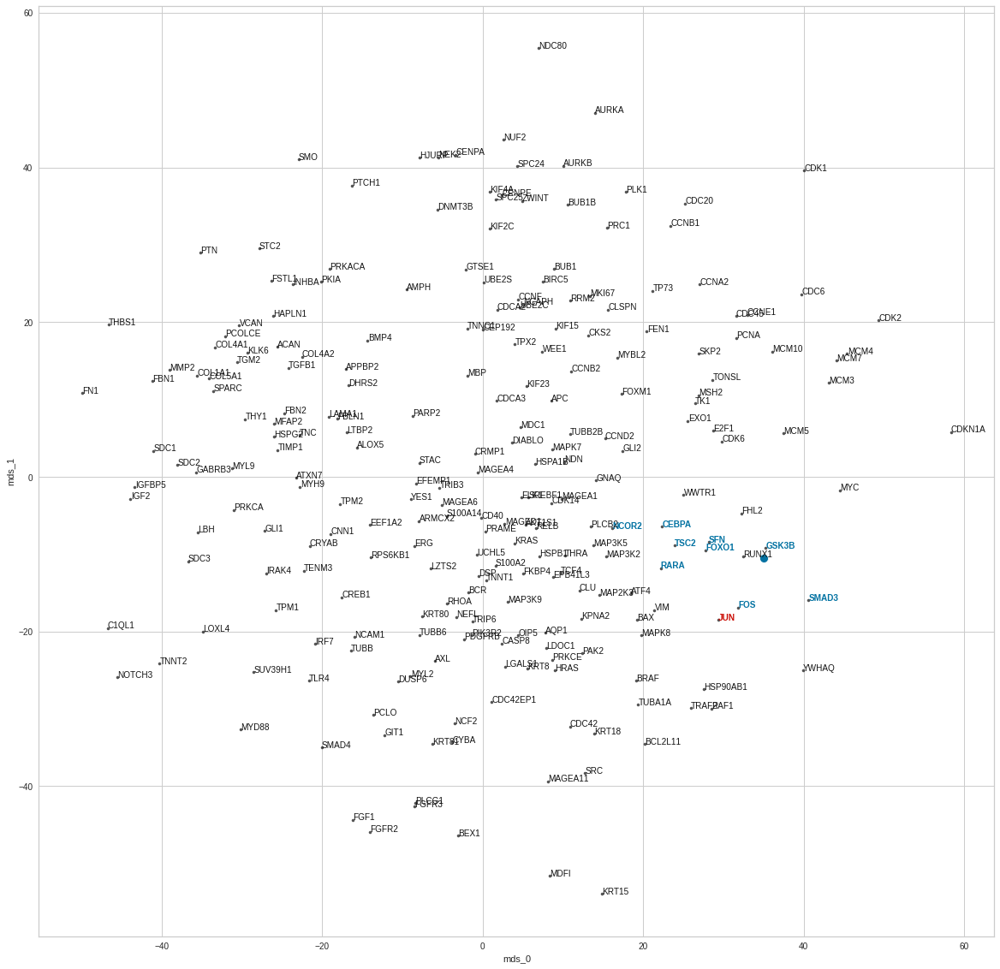

KRAS
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.043269251251504534
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.3997519612312317
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


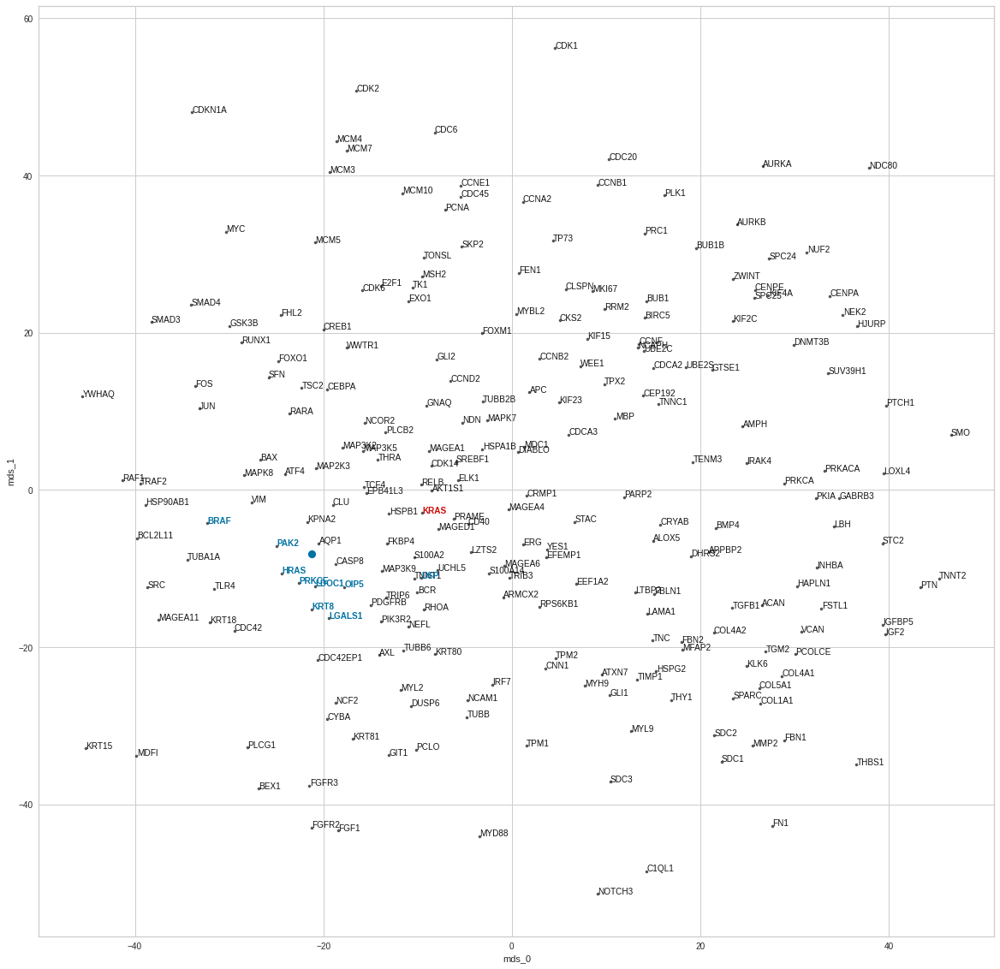

MAP2K3
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.03555496959459214
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.4890251159667969
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


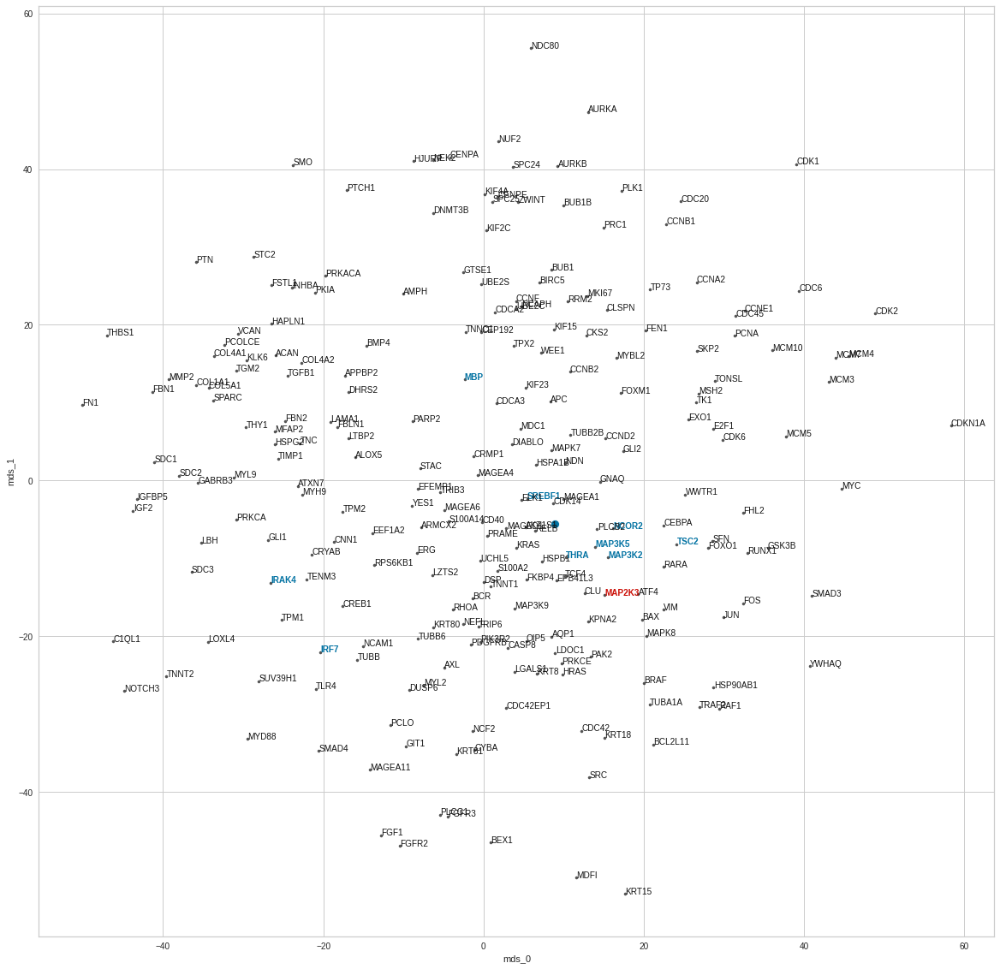

MAP3K2
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.043506565725519544
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.3112812936306
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


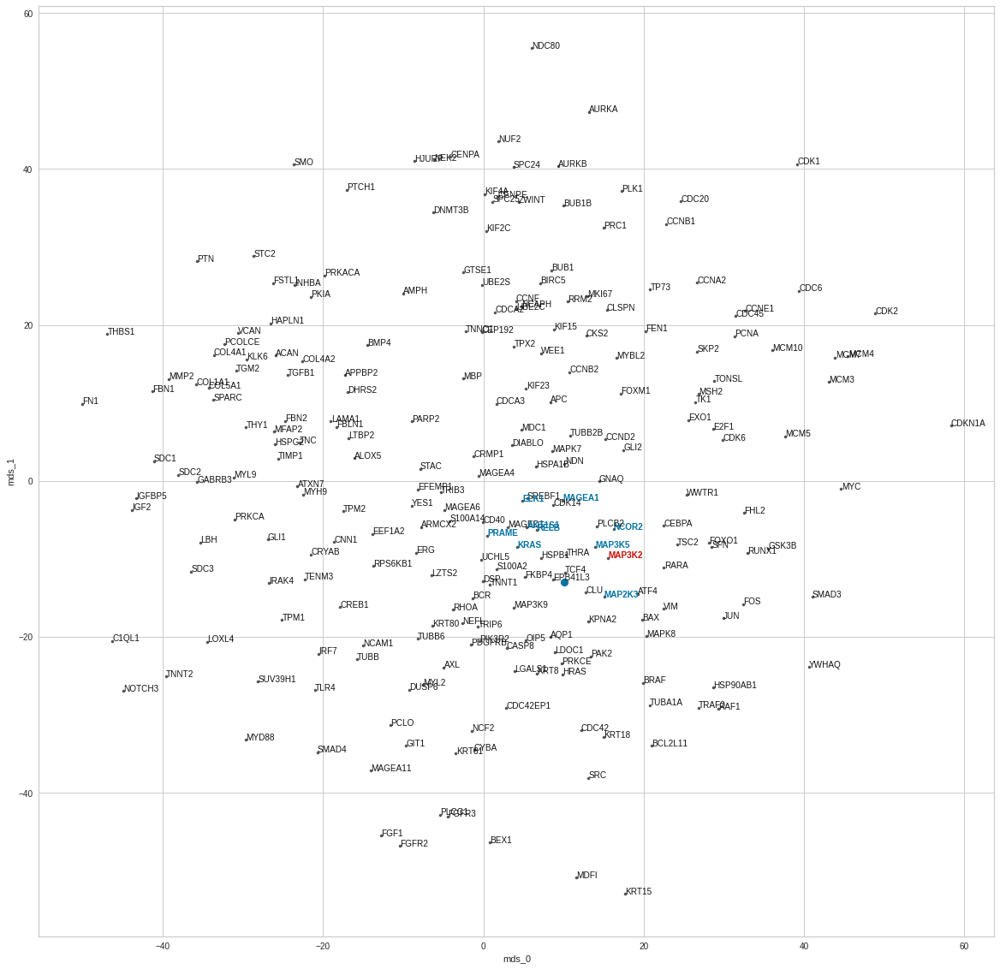

MAP3K5
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.045139490493706295
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.3984316885471344
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


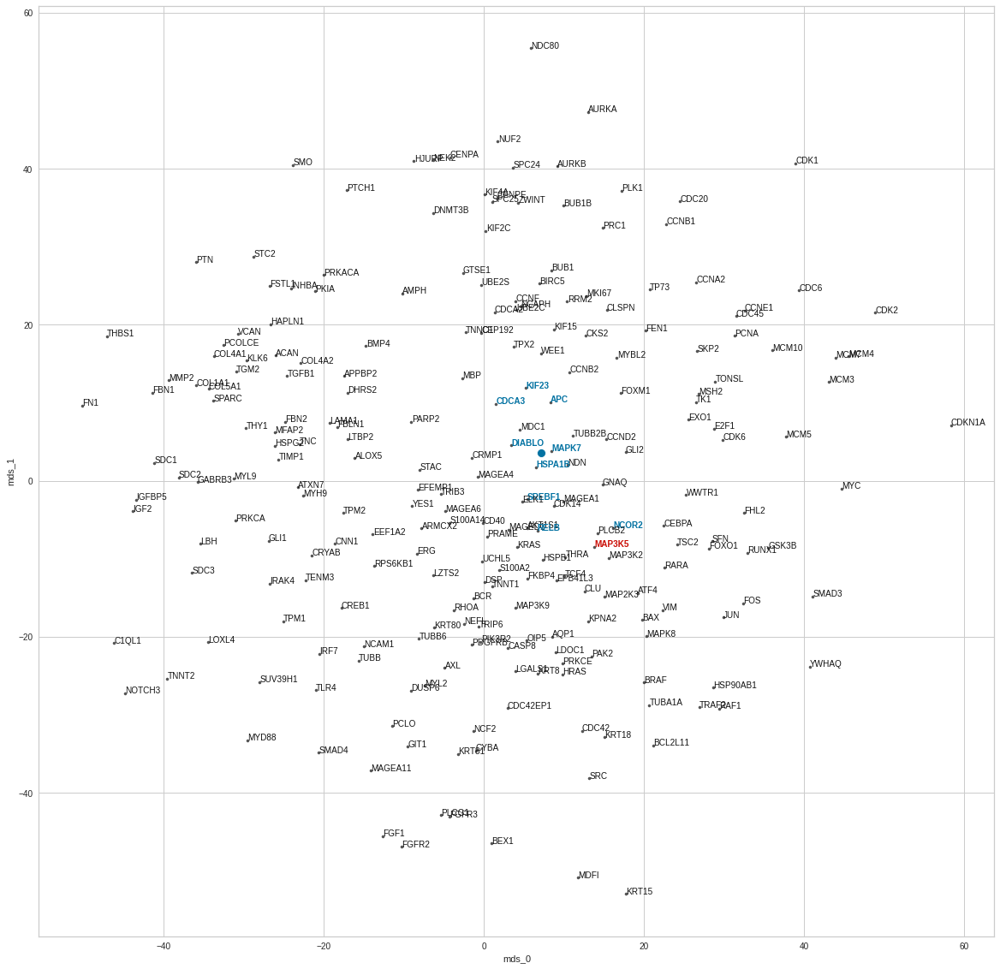

MAP3K9
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.04246487770052183
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.9034289121627808
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


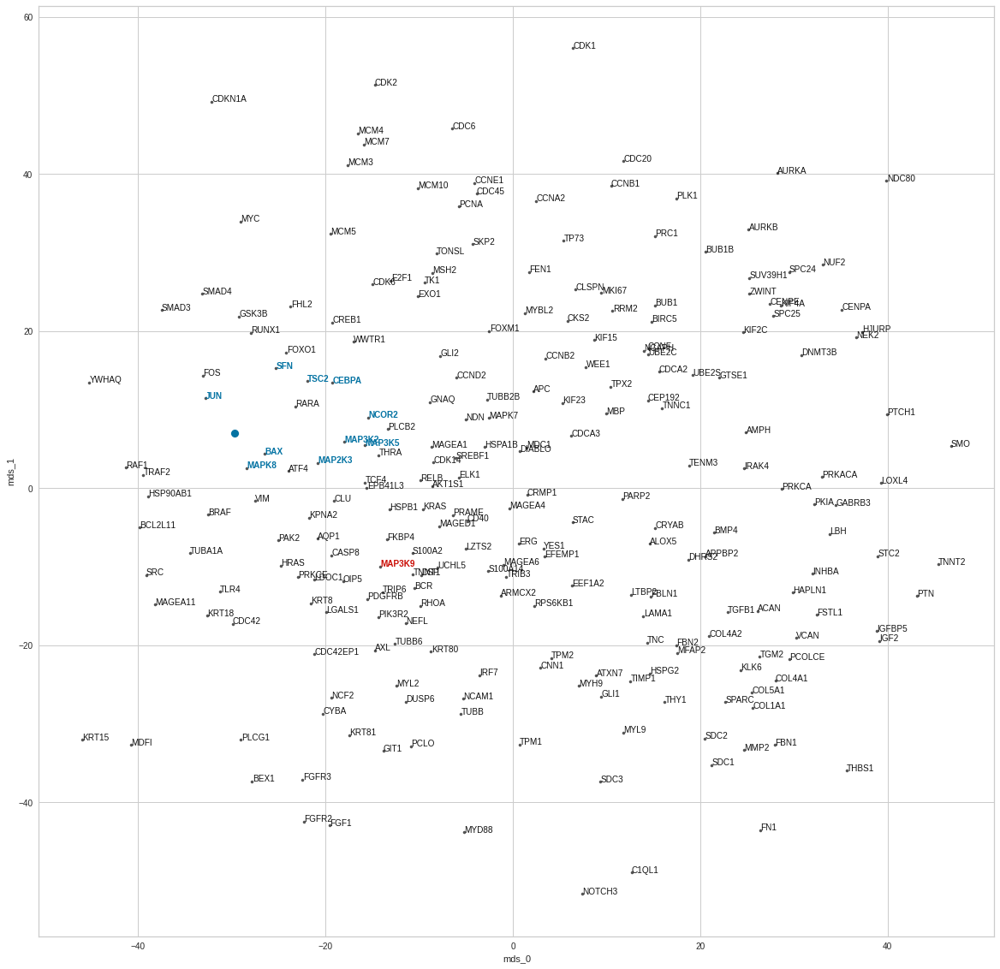

MAPK7
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.03957553225613776
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.4033016562461853
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


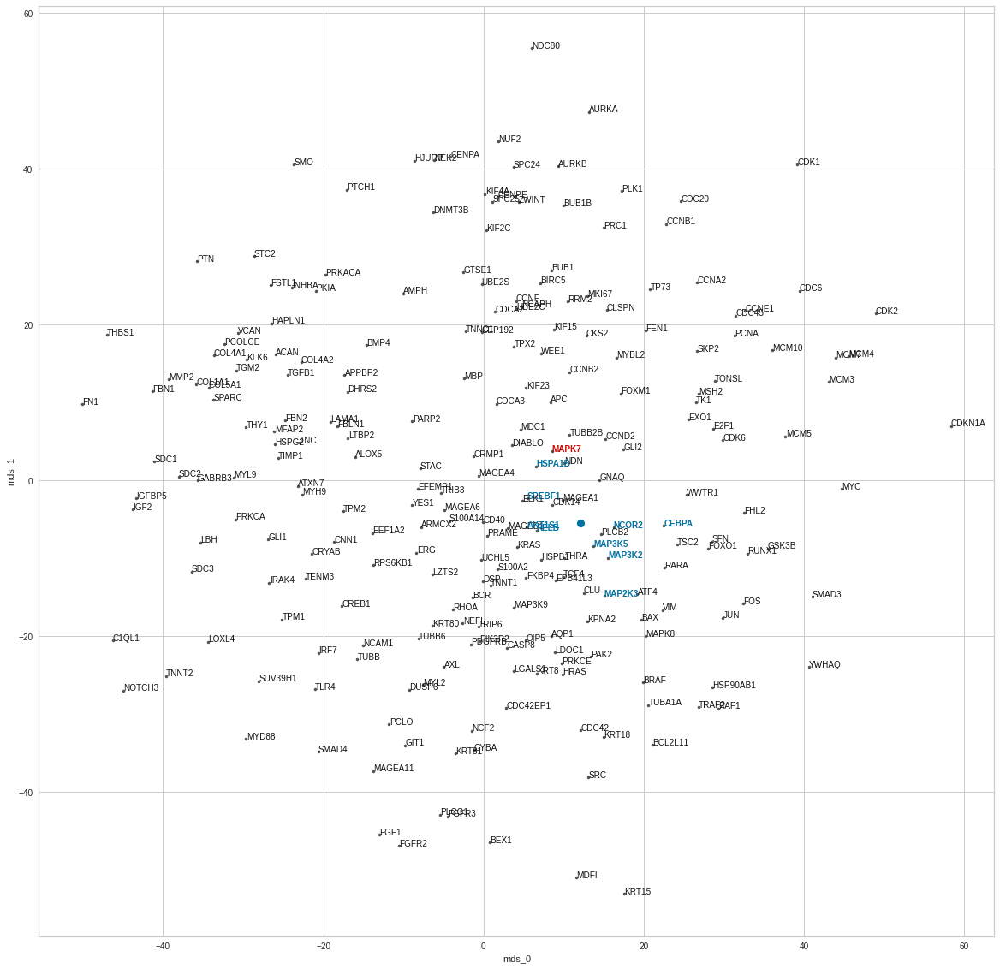

MYD88
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.04774116777947971
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.0902111530303955
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


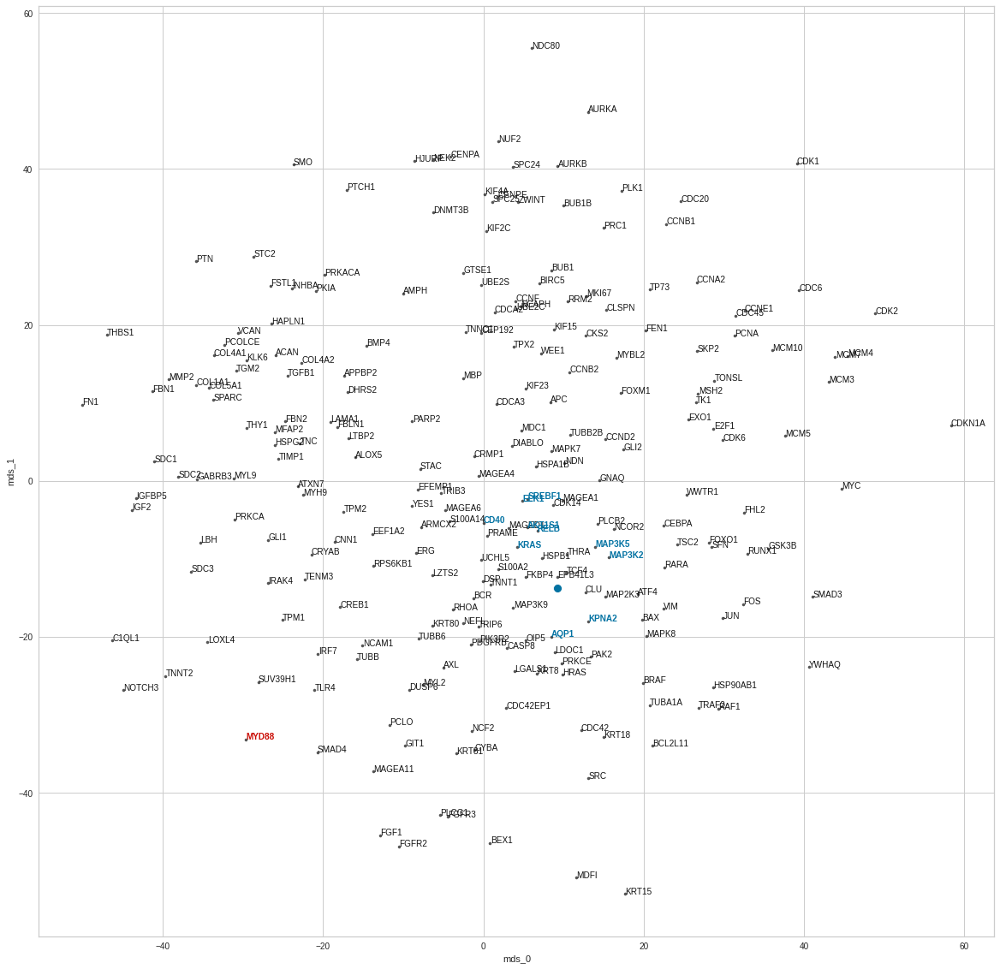

PIK3R2
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.03724203844155584
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.7416835427284241
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


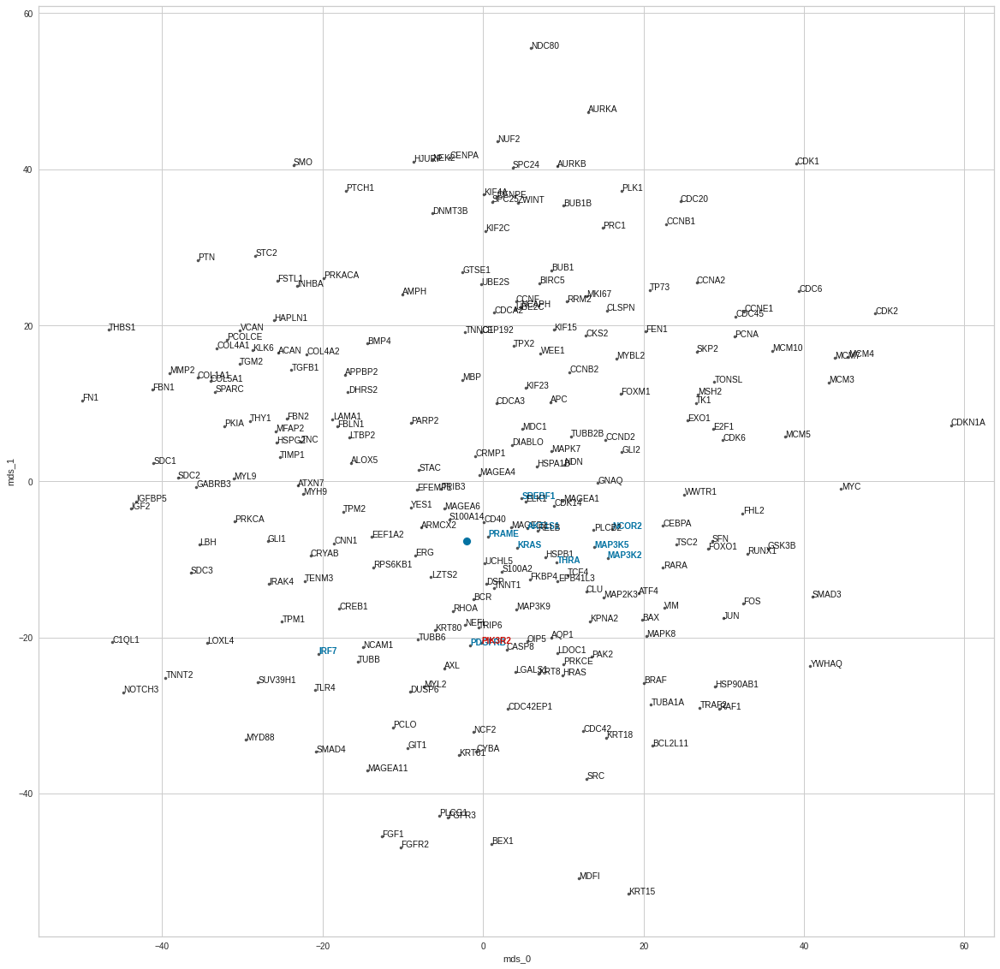

PKIA
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0337189980560825
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.0148181915283203
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


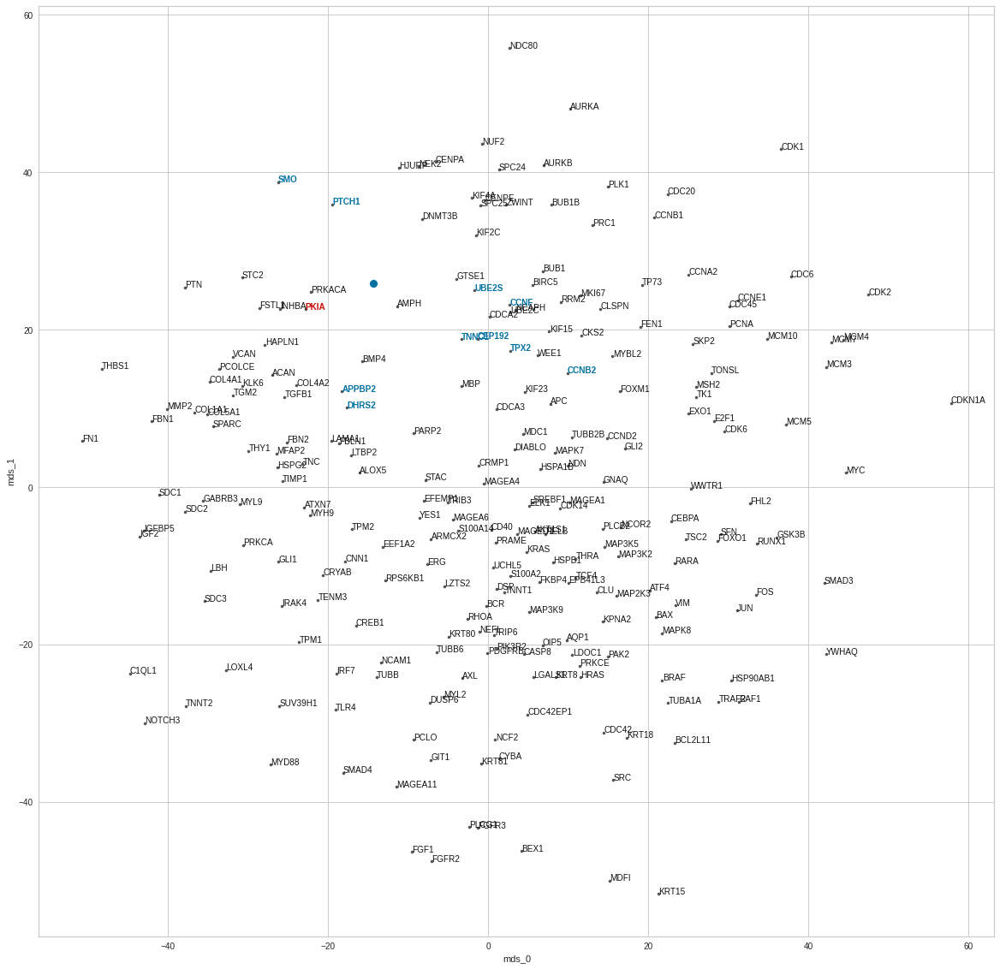

PRKACA
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.04286916376579376
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.9723595976829529
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


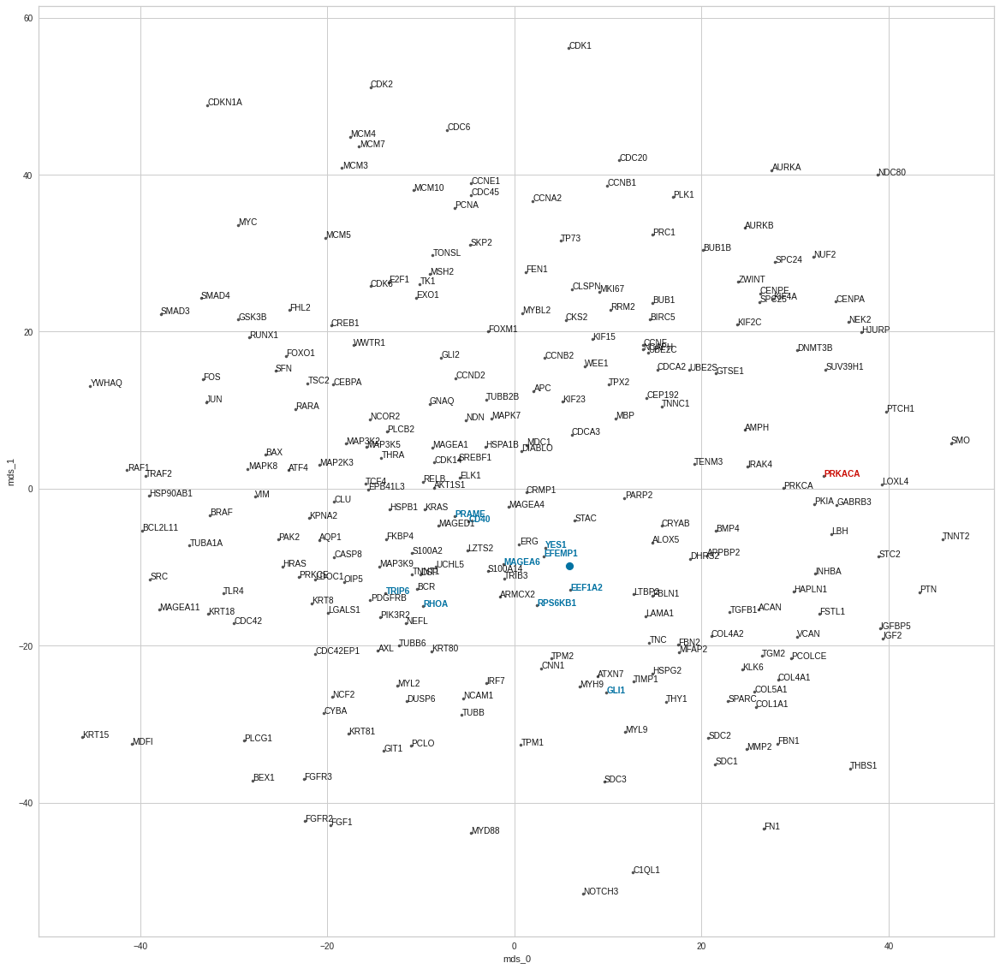

PRKCE
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.03386441635943595
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.5338267087936401
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


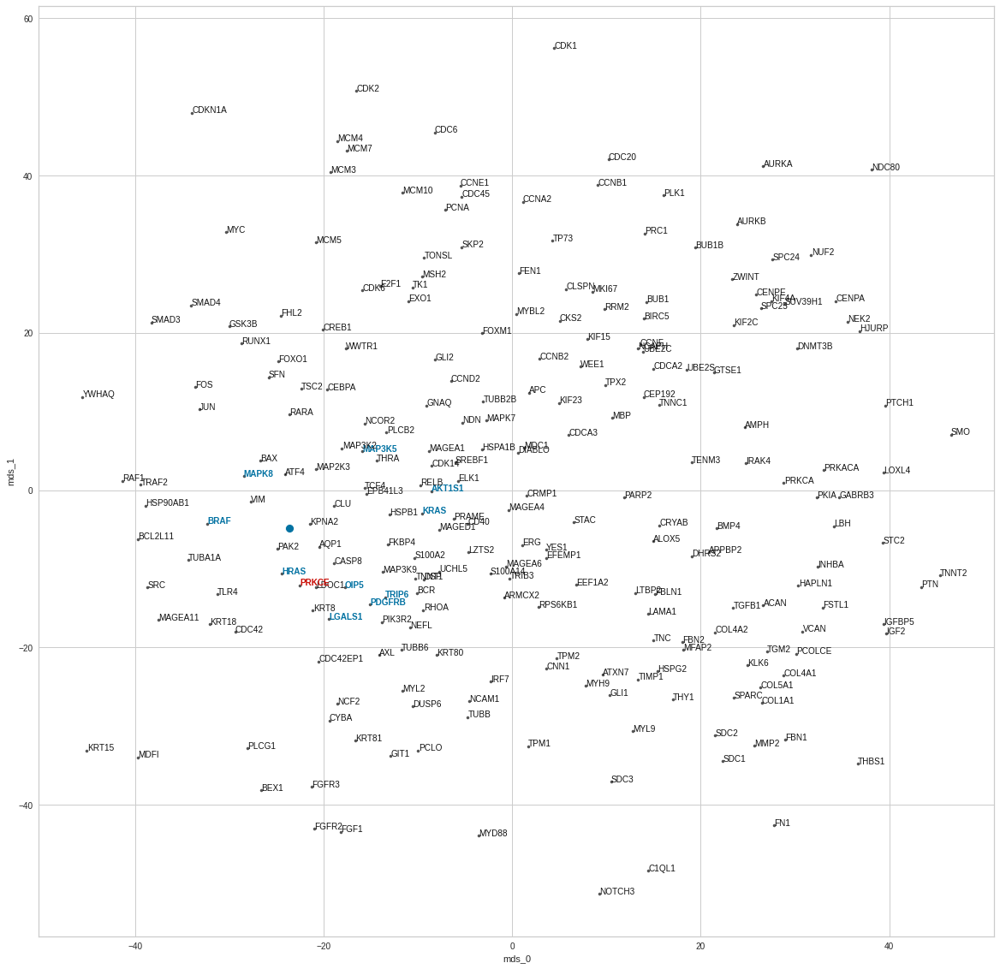

RAF1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.03924789315178281
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.8568518161773682
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


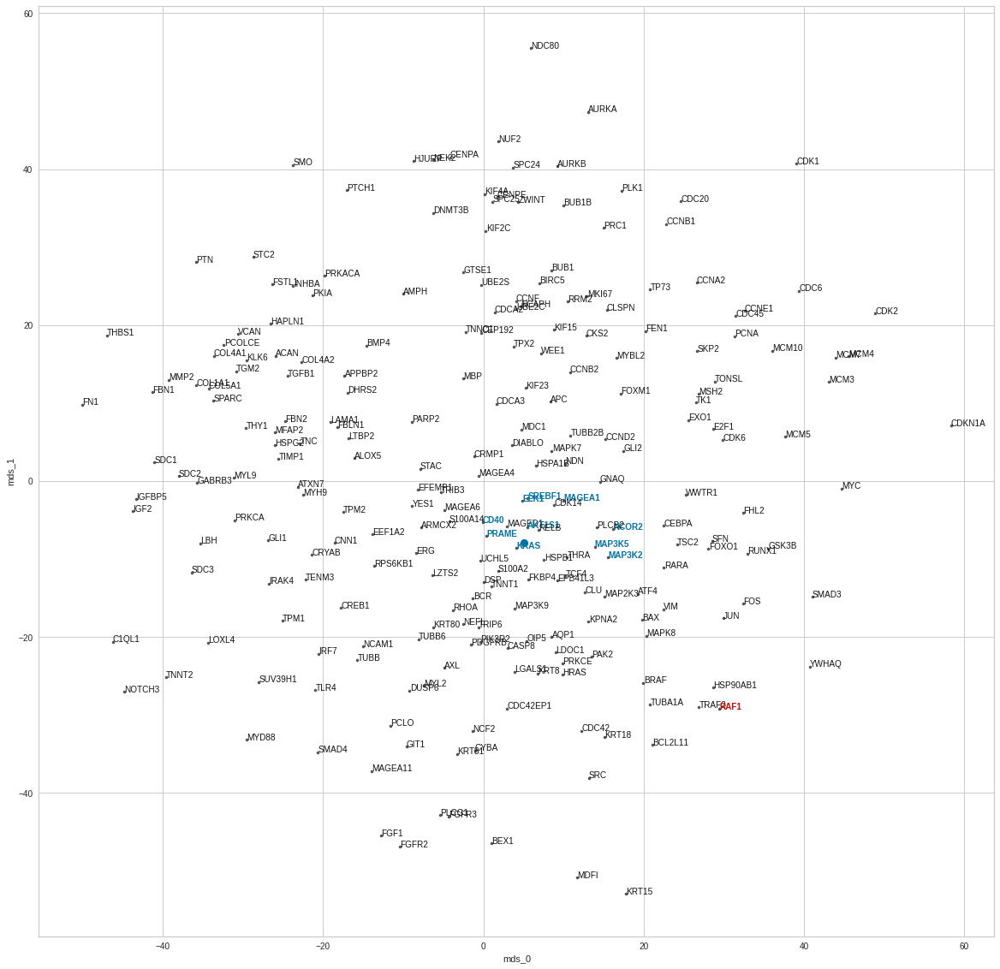

RELB
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.04080194323545411
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.8836907148361206
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


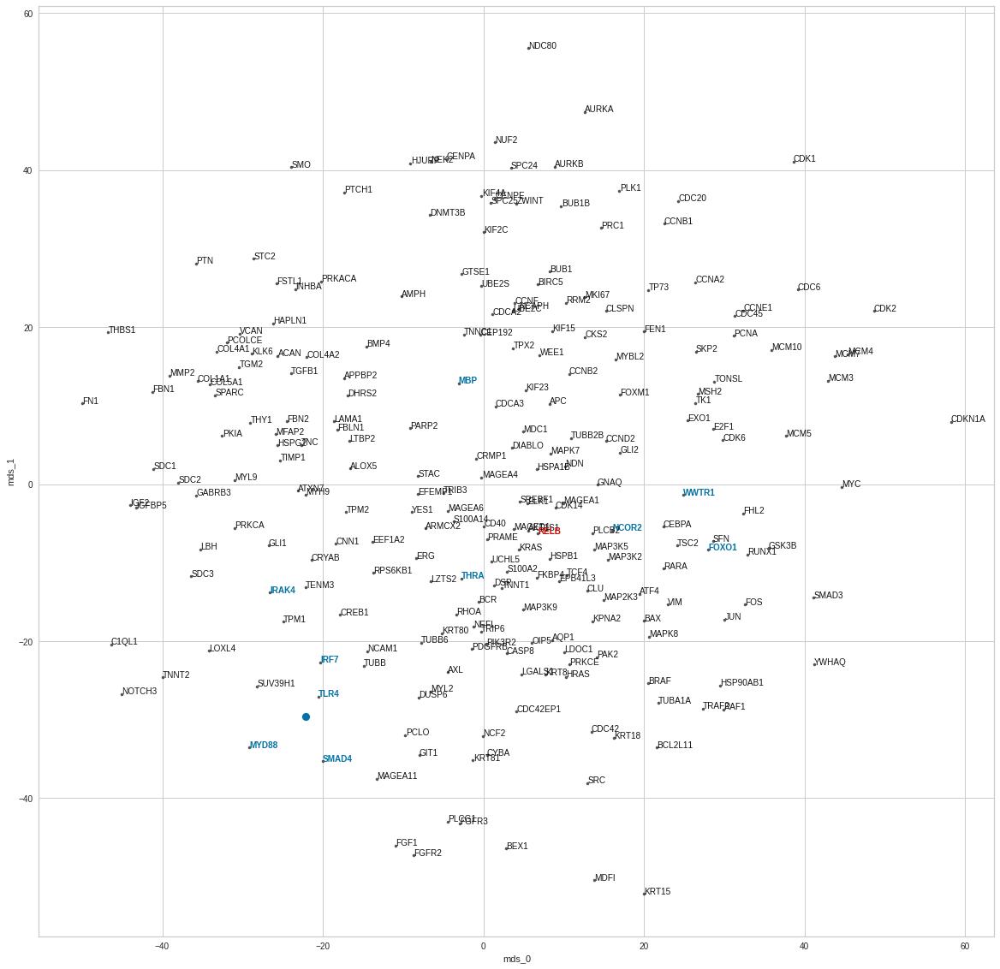

RHOA
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.044566281317245396
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.792747437953949
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


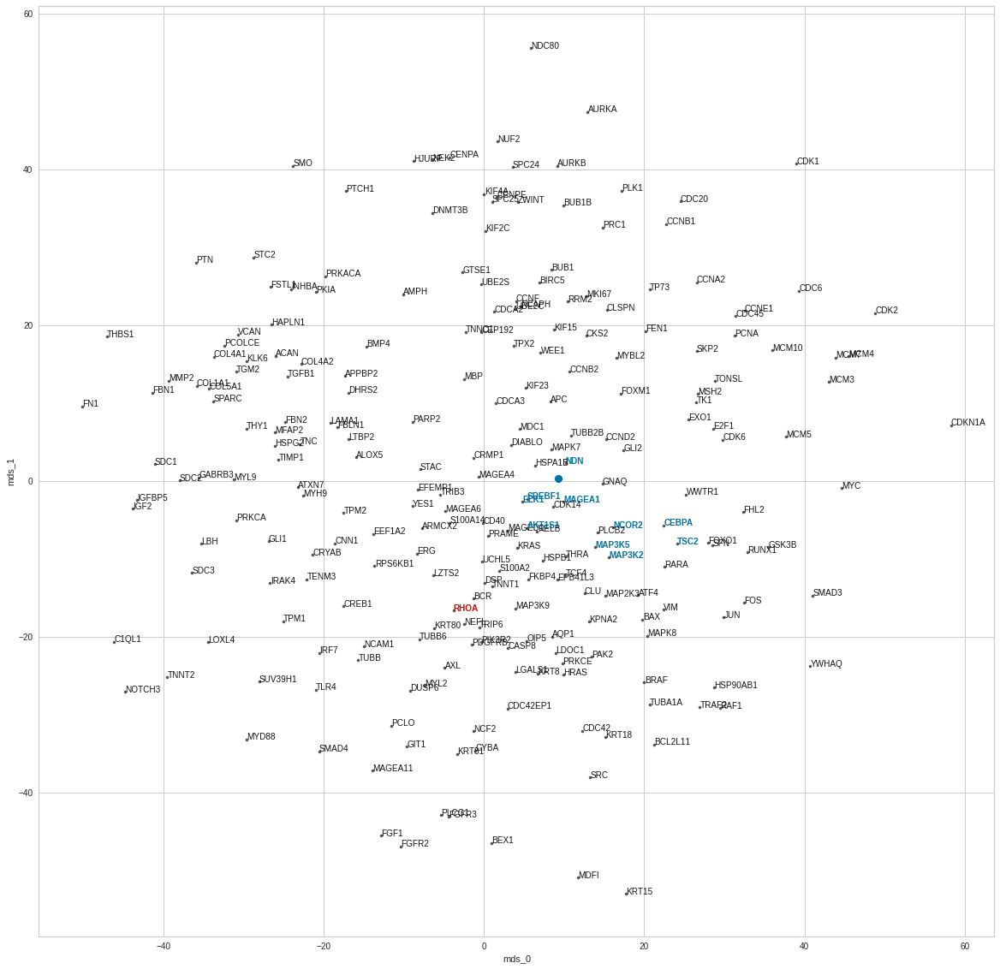

SMAD3
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.03859384482105573
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.6969602108001709
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


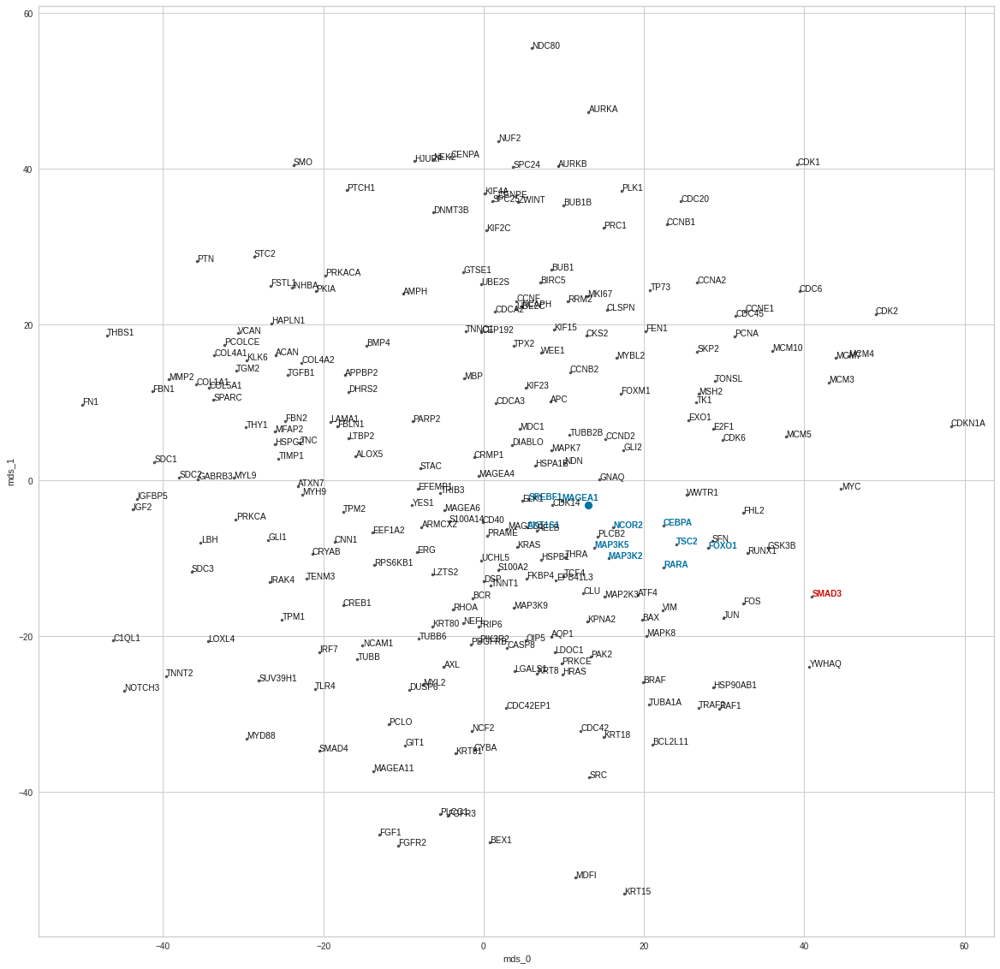

SMAD4
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.04423427297955468
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.7788598537445068
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


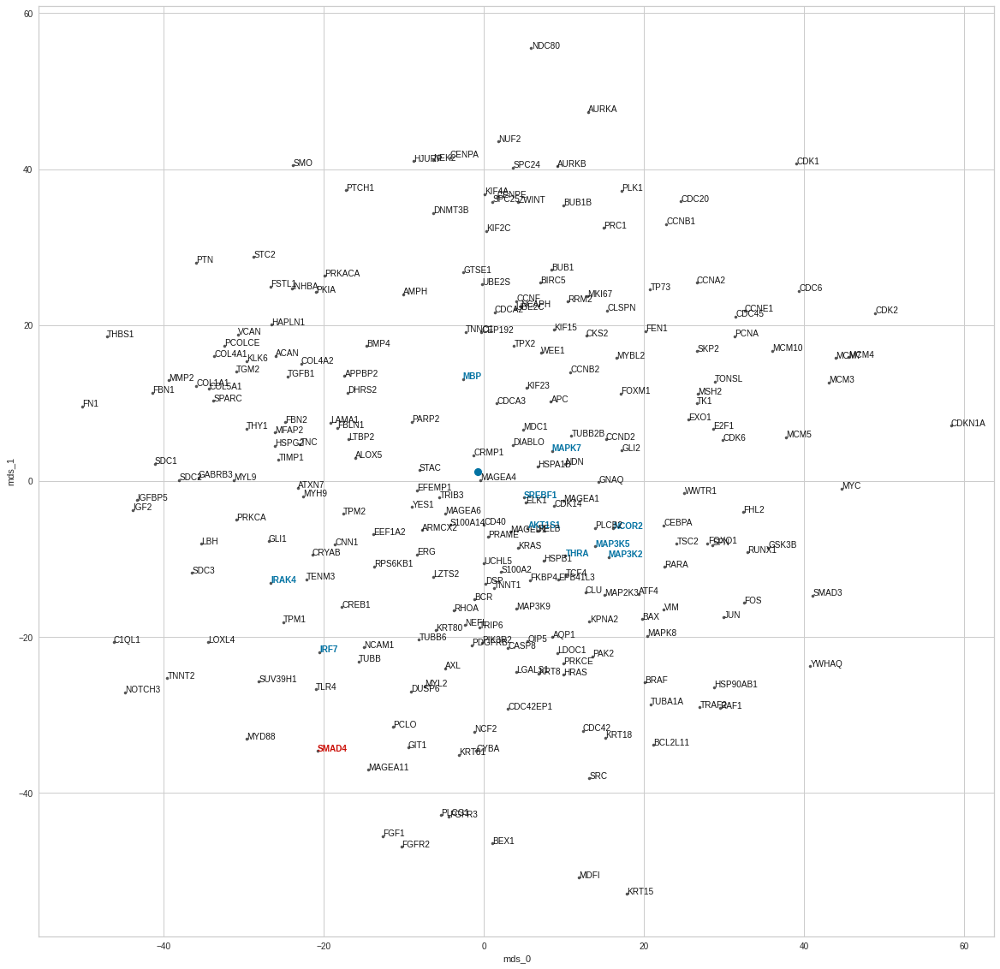

SMO
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.04158761405519077
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.2340998649597168
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


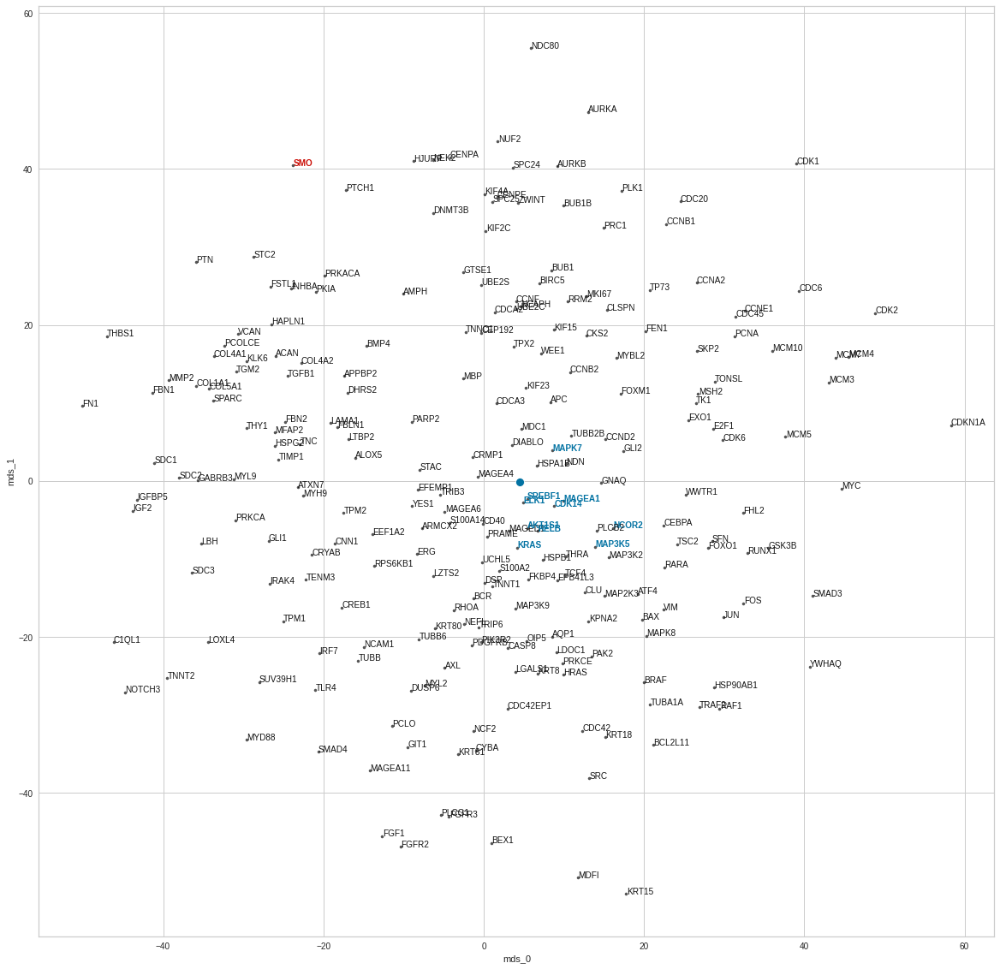

SRC
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.03657149825067747
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.0176427364349365
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


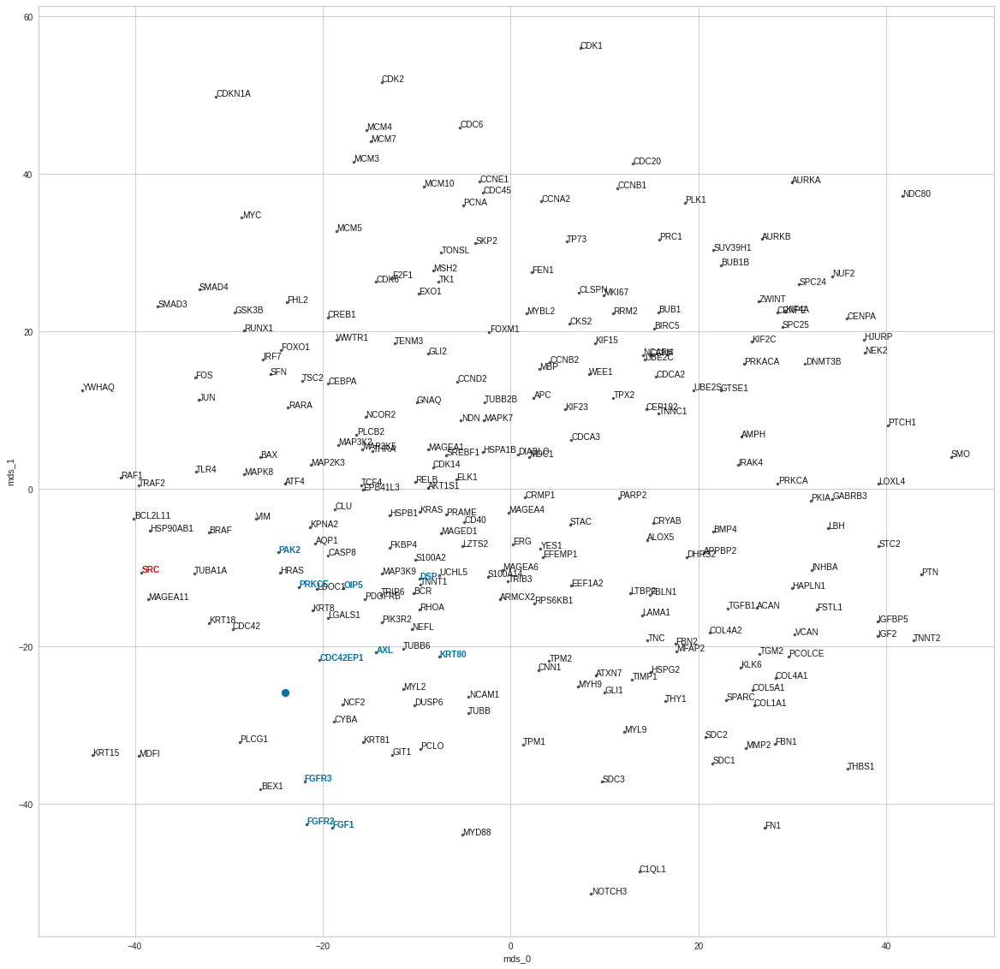

SREBF1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0403463306526343
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.6867899298667908
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


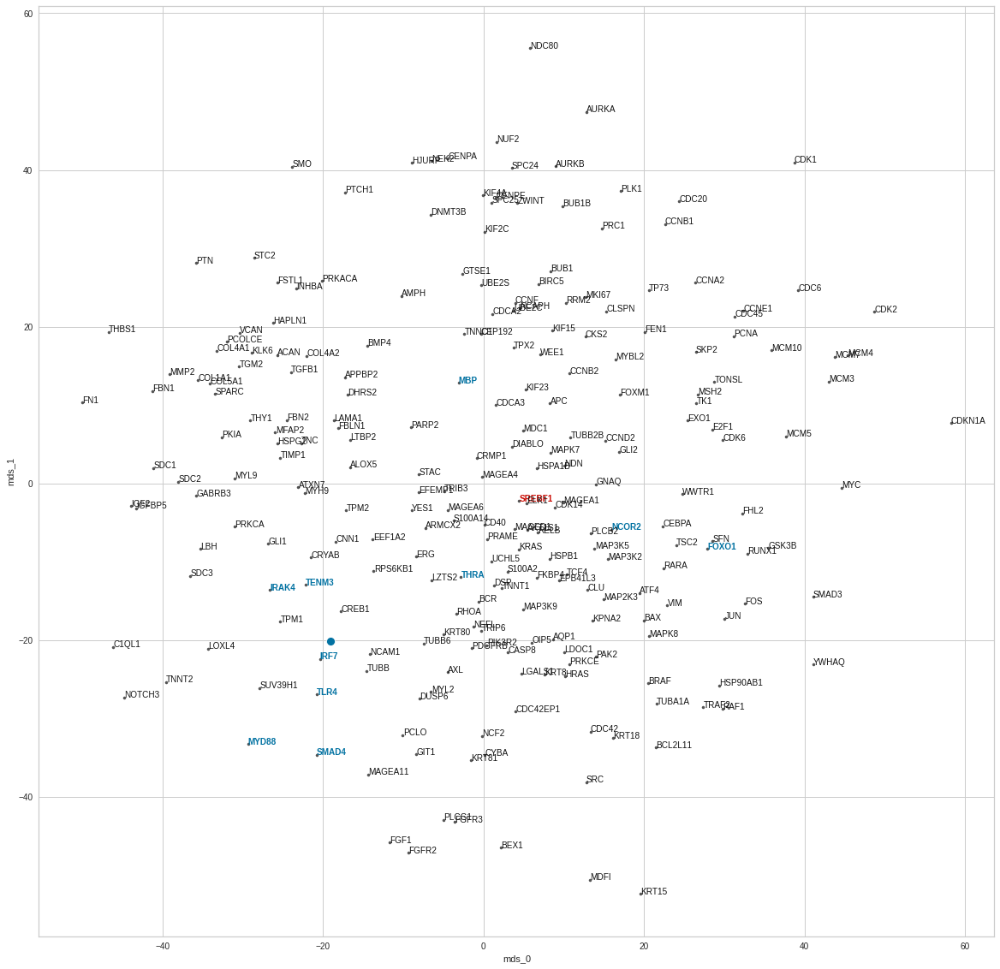

TRAF2
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.03845108460102763
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.7497068047523499
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


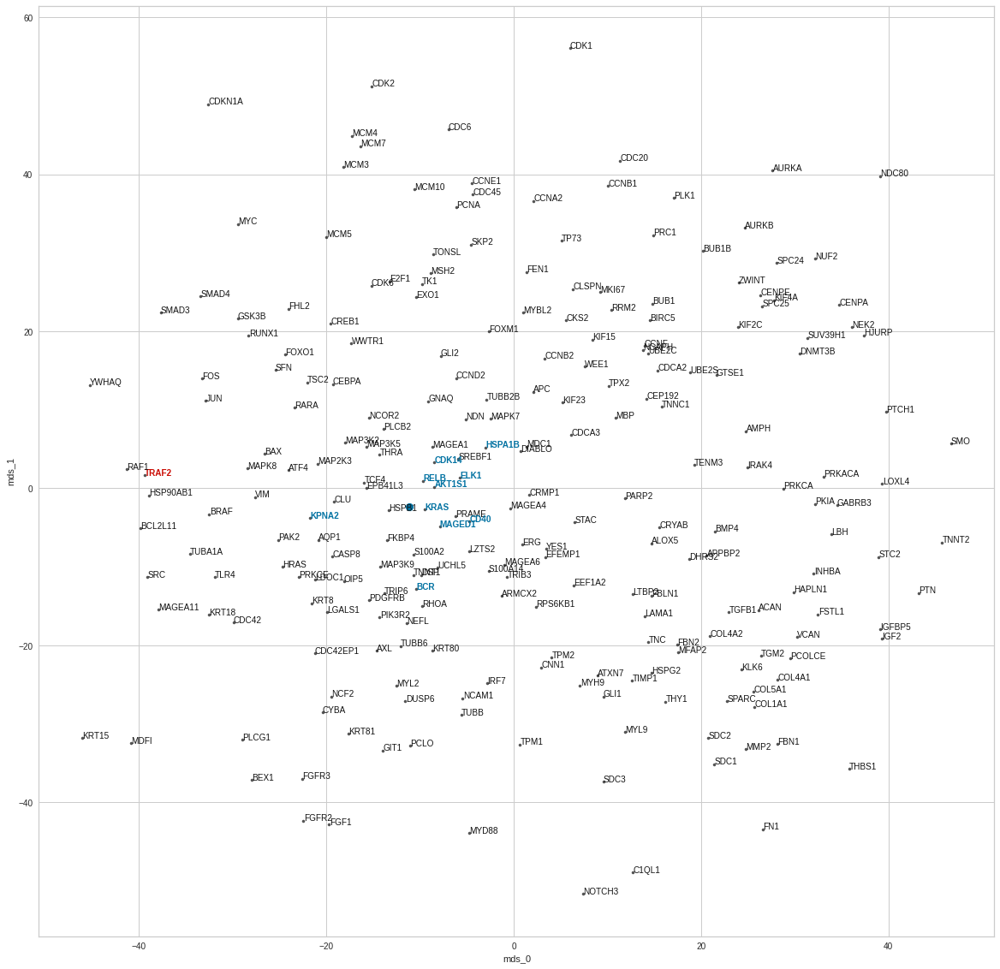

TSC2
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.03533182426222733
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.3493105471134186
test top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


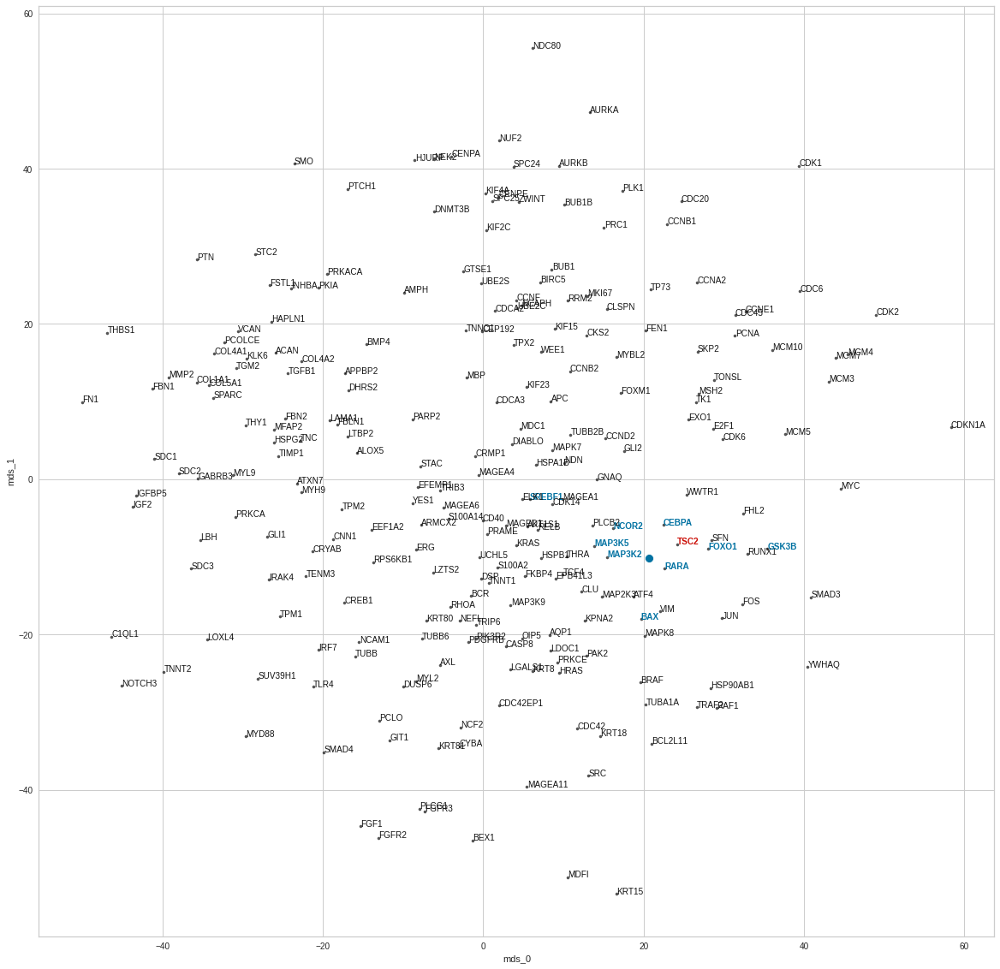

WWTR1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.04342627791421754
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 1.207727313041687
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


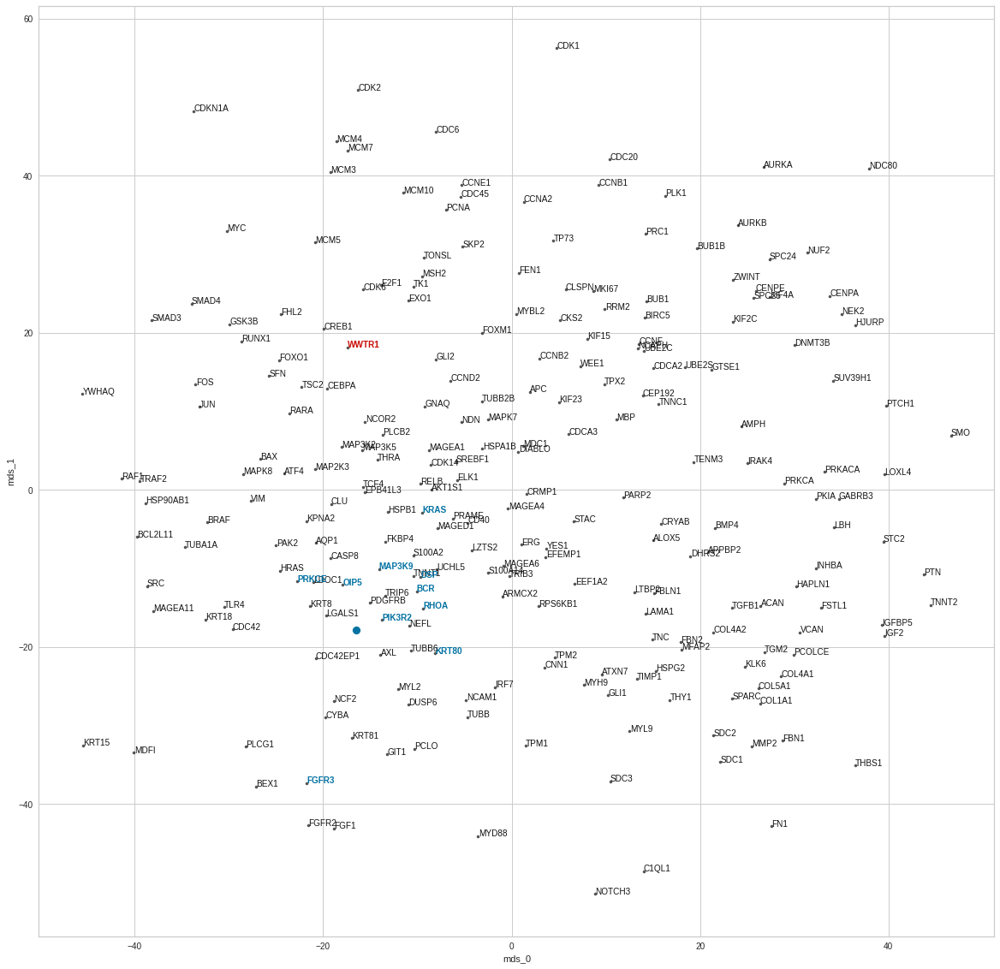

<IPython.core.display.Javascript object>

In [35]:
target_topk_accs = {}
mean_nonlin_nns = {}
for i in tqdm(range(len(data_dicts))):
    data_dict = data_dicts[i]
    model = torch.nn.Sequential(
        torch.nn.Linear(1024, 1024),
        torch.nn.PReLU(),
        torch.nn.Linear(1024, 1024),
        torch.nn.PReLU(),
        torch.nn.Linear(1024, 1024),
        torch.nn.PReLU(),
        torch.nn.Linear(1024, 1024),
    )
    optimizer = Adam(model.parameters(), lr=1e-3)
    criterion = torch.nn.L1Loss()
    target = sorted(list(shared_targets))[i]
    print(target)
    fitted_model, topk_acc, _, mean_knns = train_model_topk_acc(
        model=model,
        data_dict=data_dict,
        optimizer=optimizer,
        criterion=criterion,
        n_epochs=500,
        early_stopping=500,
        nn_clf=nn_clf,
        log_epochs=False,
    )
    target_topk_accs[target] = topk_acc
    mean_nonlin_nns[target] = mean_knns[0]
    fig, ax, _ = plot_translation(
        fitted_model.to("cpu"),
        data_dict["test"].dataset,
        node_embs,
        figsize=[20, 20],
        crop=False,
        highlight_target=target,
        pred_size=100,
        reg_size=10,
        highlight_nns=mean_nonlin_nns[target][:10],
    )
    ax.get_legend().remove()
    plt.show()
    plt.close()

In [50]:
mean_nonlin_topk_df = pd.DataFrame(target_topk_accs).transpose()
mean_nonlin_topk_df.loc[mean_nonlin_topk_df.loc[:, 50] > 0].sort_values(
    [1, 3, 5, 10, 20, 50], ascending=False
)

,1,3,5,10,20,50
TSC2,1.0,1.0,1.0,1.0,1.0,1.0
BRAF,0.0,1.0,1.0,1.0,1.0,1.0
FOXO1,0.0,1.0,1.0,1.0,1.0,1.0
MAP3K2,0.0,1.0,1.0,1.0,1.0,1.0
HRAS,0.0,0.0,1.0,1.0,1.0,1.0
MAP3K5,0.0,0.0,1.0,1.0,1.0,1.0
JUN,0.0,0.0,0.0,1.0,1.0,1.0
MAPK7,0.0,0.0,0.0,1.0,1.0,1.0
SREBF1,0.0,0.0,0.0,1.0,1.0,1.0
AKT1S1,0.0,0.0,0.0,0.0,1.0,1.0


<IPython.core.display.Javascript object>

In [51]:
mean_nonlin_topk_df.describe()

,1,3,5,10,20,50
count,43.000000,43.000000,43.000000,43.000000,43.000000,43.000000
mean,0.023256,0.093023,0.139535,0.209302,0.302326,0.534884
std,0.152499,0.293903,0.350605,0.411625,0.464701,0.504685
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


<IPython.core.display.Javascript object>

In [52]:
iou_kegg_1nn_mean_nonlin = get_geneset_io(mean_nonlin_nns, inv_kegg_gs_dict, k=1)
iou_pid_1nn_mean_nonlin = get_geneset_io(mean_nonlin_nns, inv_pid_gs_dict, k=1)
iou_wiki_1nn_mean_nonlin = get_geneset_io(mean_nonlin_nns, inv_wiki_gs_dict, k=1)
iou_bc_1nn_mean_nonlin = get_geneset_io(mean_nonlin_nns, inv_bc_gs_dict, k=1)
iou_h_1nn_mean_nonlin = get_geneset_io(mean_nonlin_nns, inv_h_gs_dict, k=1)

<IPython.core.display.Javascript object>

In [53]:
iou_wiki_1nn_mean_embs_df = pd.DataFrame(iou_wiki_1nn_mean_embs, index=["wiki_pw_iou"])
iou_wiki_1nn_mean_lin_df = pd.DataFrame(iou_wiki_1nn_mean_lin, index=["wiki_pw_iou"])
iou_wiki_1nn_mean_nonlin_df = pd.DataFrame(
    iou_wiki_1nn_mean_nonlin, index=["wiki_pw_iou"]
)
all_iou_wiki_1nn = pd.concat(
    [iou_wiki_1nn_mean_embs_df, iou_wiki_1nn_mean_lin_df, iou_wiki_1nn_mean_nonlin_df]
)
all_iou_wiki_1nn = all_iou_wiki_1nn.transpose()
all_iou_wiki_1nn.columns = ["struct", "lin", "nonlin"]

all_iou_wiki_1nn

,struct,lin,nonlin
AKT1S1,0.000000,0.000000,0.000000
APC,0.026316,0.000000,0.069767
ATF4,0.034483,0.086420,0.034483
BAX,0.031250,0.153846,0.031250
BCL2L11,0.108696,0.111111,0.000000
BRAF,0.333333,0.098039,0.285714
CASP8,0.108696,0.108696,0.108696
CDC42,0.183333,0.081633,0.193182
CDKN1A,0.014925,0.000000,0.000000
CEBPA,0.010526,0.000000,0.000000


<IPython.core.display.Javascript object>

<AxesSubplot:>

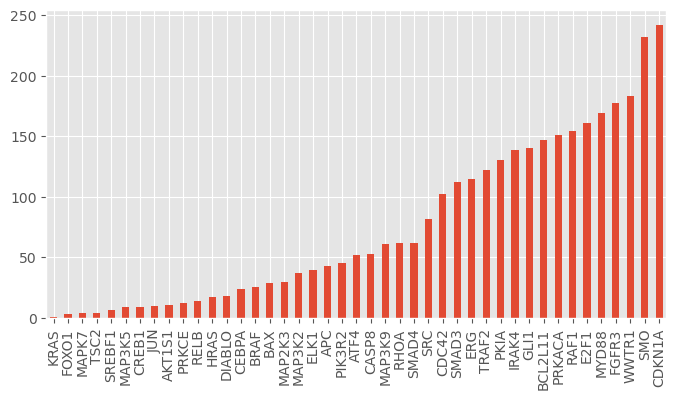

<IPython.core.display.Javascript object>

In [47]:
import matplotlib as mpl

mpl.style.use("ggplot")
nn_in_targets = []
targets = []
for k, v in mean_lin_nns.items():
    targets.append(k)
    nn_in_targets.append(np.where(v == k)[0][0])
mean_lin_nn_targets = pd.DataFrame(nn_in_targets, index=targets, columns=["hit_idx"])
mean_lin_nn_targets.hit_idx.sort_values().plot(kind="bar", figsize=[8, 4])

In [49]:
mean_lin_nns["BRAF"]

array(['KRAS', 'MAP3K5', 'HRAS', 'AKT1S1', 'OIP5', 'RELB', 'HSPA1B',
       'PDGFRB', 'TRIP6', 'CD40', 'BCR', 'ELK1', 'RHOA', 'DIABLO',
       'MAPK7', 'LGALS1', 'MAGEA1', 'NCOR2', 'CDK14', 'PRAME', 'AQP1',
       'CASP8', 'PRKCE', 'MAP3K2', 'KPNA2', 'SREBF1', 'BRAF', 'PIK3R2',
       'MAGED1', 'THRA', 'PAK2', 'MAPK8', 'HSPB1', 'CLU', 'AXL', 'LDOC1',
       'ATF4', 'KRT8', 'S100A2', 'MAP3K9', 'DSP', 'LZTS2', 'MAP2K3',
       'APC', 'CDCA3', 'FKBP4', 'CEBPA', 'EPB41L3', 'UCHL5', 'MDC1',
       'TSC2', 'TNNT1', 'TCF4', 'S100A14', 'EFEMP1', 'RARA', 'KIF23',
       'ERG', 'MAGEA6', 'YES1', 'NEFL', 'BAX', 'SFN', 'RAF1', 'CDC42',
       'TRIB3', 'RPS6KB1', 'NDN', 'SRC', 'MAGEA4', 'KRT18', 'JUN',
       'CDC42EP1', 'CCND2', 'TRAF2', 'WEE1', 'STAC', 'ARMCX2', 'FOXO1',
       'TUBB6', 'FOS', 'KRT80', 'CCNB2', 'TPX2', 'MYL2', 'EEF1A2',
       'CEP192', 'TLR4', 'NCAM1', 'FOXM1', 'HSP90AB1', 'TUBB2B', 'CRMP1',
       'NCF2', 'PLCB2', 'RUNX1', 'VIM', 'IRF7', 'TNNC1', 'UBE2C', 'MBP',
       'DUSP6',

<IPython.core.display.Javascript object>

---

### 3.6. Non-linear 4-centroids mapping

In [32]:
target_topk_accs = {}
for i in tqdm(range(len(cl_data_dicts))):
    data_dict = cl_data_dicts[i]
    model = torch.nn.Sequential(
        torch.nn.Linear(1024, 1024),
        torch.nn.PReLU(),
        torch.nn.Linear(1024, 1024),
    )
    optimizer = Adam(model.parameters(), lr=1e-4)
    criterion = torch.nn.L1Loss()
    target = sorted(list(shared_targets))[i]
    print(target)
    fitted_model, _, mean_topk_acc, mean_knns = train_model_topk_acc(
        model=model,
        data_dict=data_dict,
        optimizer=optimizer,
        criterion=criterion,
        n_epochs=500,
        early_stopping=500,
        nn_clf=nn_clf,
        log_epochs=False,
    )
    target_topk_accs[target] = mean_topk_acc
    fig, ax, _, _ = plot_translation(
        fitted_model.to("cpu"),
        data_dict["test"].dataset,
        node_embs,
        figsize=[20, 20],
        crop=False,
        highlight_target=target,
        pred_size=100,
        reg_size=10,
    )
    ax.get_legend().remove()
    plt.show()
    plt.close()

NameError: name 'cl_data_dicts' is not defined

<IPython.core.display.Javascript object>

In [ ]:
cl_nonlin_topk_df = pd.DataFrame(target_topk_accs).transpose()
cl_nonlin_topk_df.loc[cl_nonlin_topk_df.loc[:, 50] > 0].sort_values(
    [1, 3, 5, 10, 20, 50], ascending=False
)

In [ ]:
cl_nonlin_topk_df.describe()